# Ignore Warnings

In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
 
import warnings
warnings.filterwarnings(action='ignore')

# Import Important Libraries

In [2]:
import pandas as pd
from pandas import DataFrame
import numpy as np
import matplotlib.pylab as plt
import matplotlib.animation as animation
import seaborn as sns
from scipy.stats import skew
from scipy.stats import kurtosis
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer
import tensorflow as tf
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn import model_selection
import scipy.stats as stats
from sklearn.model_selection import KFold
sns.set_theme(style="whitegrid")
from sklearn.metrics import ConfusionMatrixDisplay

# Import The DataSet

In [3]:
Heart = pd.read_csv("Framingham Heart Study.csv")
Heart.shape

(3263, 21)

# Dataset Information

In [4]:
Heart.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3263 entries, 0 to 3262
Data columns (total 21 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Gender                          3263 non-null   object 
 1   Age                             3263 non-null   int64  
 2   CurrentSmoker                   3263 non-null   object 
 3   CigarettesPerDay                3249 non-null   float64
 4   BodyMassIndex                   3246 non-null   float64
 5   PrevalentCoronaryHeartDiseases  3263 non-null   object 
 6   PrevalentAnginaPectoris         3263 non-null   object 
 7   PrevalentMyocardialInfarction   3263 non-null   object 
 8   PrevalentStroke                 3263 non-null   object 
 9   PrevalentHypertensive           3263 non-null   object 
 10  UseBloodPressureDrugs           2817 non-null   object 
 11  Diabetes                        3263 non-null   object 
 12  SystolicBloodPressure           32

# Statistics Of The DataSet

In [5]:
Statistics = Heart.describe().T
Statistics

,count,mean,std,min,25%,50%,75%,max
Age,3263.0,60.648177,8.296766,44.00,54.00,60.00,67.00,81.0
CigarettesPerDay,3249.0,6.771622,11.629631,0.00,0.00,0.00,10.00,80.0
BodyMassIndex,3246.0,25.894781,4.080655,14.43,23.19,25.46,28.06,56.8
SystolicBloodPressure,3263.0,140.215752,22.927642,86.00,123.00,137.00,154.00,267.0
DiastolicBloodPressure,3263.0,81.792982,11.271432,30.00,74.00,80.00,89.00,130.0
HeartRate,3259.0,77.357778,12.490350,37.00,70.00,76.00,85.00,150.0
Glucose,2701.0,89.775268,28.158865,46.00,76.00,84.00,96.00,478.0
HighDensityLipoprotein,3027.0,49.364718,15.626669,10.00,39.00,48.00,58.00,189.0
LowDensityLipoprotein,3026.0,176.466953,46.863393,20.00,145.00,173.00,205.00,565.0
TotalCholesterol,3049.0,236.713349,44.449481,112.00,206.00,234.00,264.00,625.0


# Skewness

**1. Age**

In [6]:
SkewnessAge = skew(Heart['Age'], axis=0, bias=True,  keepdims=True)
SkewnessAge

array([0.29534893])

**2. Cigarettes Per Day**

In [7]:
SkewnessCigarettesPerDay= skew(Heart['CigarettesPerDay'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessCigarettesPerDay

array([1.79172491])

**3. Body Mass Index**

In [8]:
SkewnessBodyMassIndex= skew(Heart['BodyMassIndex'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessBodyMassIndex

array([0.91593941])

**4. Systolic Blood Pressure**

In [9]:
SkewnessBodyMassIndex= skew(Heart['SystolicBloodPressure'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessBodyMassIndex

array([0.74113913])

**5. Diastolic Blood Pressure**

In [10]:
SkewnessDiastolicBloodPressure= skew(Heart['DiastolicBloodPressure'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessDiastolicBloodPressure

array([0.33077036])

**6. Heart Rate**

In [11]:
SkewnessHeartRate= skew(Heart['HeartRate'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessHeartRate

array([0.45943407])

**7. Glucose**

In [12]:
SkewnessGlucose= skew(Heart['Glucose'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessGlucose

array([5.2377277])

**8. High Density Lipoprotein**

In [13]:
SkewnessHighDensityLipoprotein= skew(Heart['HighDensityLipoprotein'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessHighDensityLipoprotein

array([1.06178486])

**9. Low Density Lipoprotein**

In [14]:
SkewnessLowDensityLipoprotein= skew(Heart['LowDensityLipoprotein'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessLowDensityLipoprotein

array([0.68756165])

**10. Total Cholesterol**

In [15]:
SkewnessTotalCholesterol= skew(Heart['TotalCholesterol'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessTotalCholesterol

array([0.77962055])

# Kurtosis

**1. Age**

In [16]:
KurtosisCigarettesPerDay = kurtosis(Heart['CigarettesPerDay'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisCigarettesPerDay

array([2.99740102])

**2. Cigarettes Per Day**

In [17]:
KurtosisCigarettesPerDay= kurtosis(Heart['CigarettesPerDay'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisCigarettesPerDay

array([2.99740102])

**3. Body Mass Index**

In [18]:
KurtosisBodyMassIndex= kurtosis(Heart['BodyMassIndex'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisBodyMassIndex

array([2.61158124])

**4. Systolic Blood Pressure**

In [19]:
KurtosisBodyMassIndex= kurtosis(Heart['SystolicBloodPressure'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisBodyMassIndex

array([0.76817079])

**5. Diastolic Blood Pressure**

In [20]:
KurtosisDiastolicBloodPressure= kurtosis(Heart['DiastolicBloodPressure'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisDiastolicBloodPressure

array([0.45123423])

**6. Heart Rate**

In [21]:
KurtosisHeartRate= kurtosis(Heart['HeartRate'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisHeartRate

array([0.48950638])

**7. Glucose**

In [22]:
KurtosisGlucose= kurtosis(Heart['Glucose'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisGlucose

array([46.19793252])

**8. High Density Lipoprotein**

In [23]:
KurtosisHighDensityLipoprotein= kurtosis(Heart['HighDensityLipoprotein'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisHighDensityLipoprotein

array([3.65340437])

**9. Low Density Lipoprotein**

In [24]:
KurtosisLowDensityLipoprotein= kurtosis(Heart['LowDensityLipoprotein'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisLowDensityLipoprotein

array([2.53060737])

**10. Total Cholesterol**

In [25]:
KurtosisTotalCholesterol= kurtosis(Heart['TotalCholesterol'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisTotalCholesterol

array([2.78324068])

# Unique Values

In [26]:
UniqueValues = Heart.nunique()
UniqueValues

Gender                               2
Age                                 38
CurrentSmoker                        2
CigarettesPerDay                    35
BodyMassIndex                     1235
PrevalentCoronaryHeartDiseases       2
PrevalentAnginaPectoris              2
PrevalentMyocardialInfarction        2
PrevalentStroke                      2
PrevalentHypertensive                2
UseBloodPressureDrugs                2
Diabetes                             2
SystolicBloodPressure              206
DiastolicBloodPressure             123
HeartRate                           74
Glucose                            151
HighDensityLipoprotein             105
LowDensityLipoprotein              262
TotalCholesterol                   243
AnginaPectoris                       2
MyocardialInfarction                 2
dtype: int64

# Pivote Table

**1. Gender**

In [27]:
PivotedGender  = pd.pivot_table(data=Heart, index=['Gender']).fillna(0)
PivotedGender

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
Gender,,,,,,,,,,
Female,60.869403,25.651125,5.345639,81.231077,88.723017,78.454594,53.643064,180.948897,140.924041,245.000000
Male,60.348955,26.224246,8.702899,82.552992,91.166810,75.877433,43.711656,170.548313,139.257751,225.742378


**2. CigarettesPerDay**

In [28]:
PivotedAge  = pd.pivot_table(data=Heart, index=['CigarettesPerDay']).fillna(0)
PivotedAge

,Age,BodyMassIndex,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
CigarettesPerDay,,,,,,,,,
0.0,62.103641,26.352928,82.124183,90.637183,76.721625,49.628012,176.738322,142.235994,238.460120
1.0,58.318182,27.019545,81.545455,93.333333,78.045455,52.619048,169.761905,138.090909,230.904762
2.0,61.320000,25.529600,80.640000,92.045455,73.666667,54.863636,173.272727,138.480000,236.818182
3.0,58.761905,25.556905,81.035714,95.275000,77.619048,51.400000,174.225000,134.357143,231.500000
4.0,59.526316,24.682632,74.710526,87.937500,73.631579,51.888889,159.166667,130.631579,225.777778
5.0,62.318182,25.424091,82.522727,94.238095,82.500000,53.619048,178.238095,140.727273,236.857143
6.0,57.066667,25.413000,81.600000,87.961538,77.000000,50.103448,171.517241,134.783333,228.366667
7.0,63.363636,24.137273,76.727273,84.555556,72.909091,49.000000,187.272727,127.363636,239.818182
8.0,56.142857,23.582857,80.380952,84.400000,76.666667,48.850000,202.200000,129.047619,255.850000


**3. Current Smoker**

In [29]:
PivotedCurrentSmoker  = pd.pivot_table(data=Heart, index=['CurrentSmoker']).fillna(0)
PivotedCurrentSmoker

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
CurrentSmoker,,,,,,,,,,
No,62.103641,26.352928,0.000000,82.124183,90.637183,76.721625,49.628012,176.738322,142.235994,238.460120
Yes,57.867083,25.022746,19.874435,81.160125,88.123110,78.576029,48.857971,175.944928,136.355486,233.353787


**4. Cigarettes Per Day**

In [30]:
PivotedCigarettesPerDay  = pd.pivot_table(data=Heart, index=['CigarettesPerDay']).fillna(0)
PivotedCigarettesPerDay

,Age,BodyMassIndex,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
CigarettesPerDay,,,,,,,,,
0.0,62.103641,26.352928,82.124183,90.637183,76.721625,49.628012,176.738322,142.235994,238.460120
1.0,58.318182,27.019545,81.545455,93.333333,78.045455,52.619048,169.761905,138.090909,230.904762
2.0,61.320000,25.529600,80.640000,92.045455,73.666667,54.863636,173.272727,138.480000,236.818182
3.0,58.761905,25.556905,81.035714,95.275000,77.619048,51.400000,174.225000,134.357143,231.500000
4.0,59.526316,24.682632,74.710526,87.937500,73.631579,51.888889,159.166667,130.631579,225.777778
5.0,62.318182,25.424091,82.522727,94.238095,82.500000,53.619048,178.238095,140.727273,236.857143
6.0,57.066667,25.413000,81.600000,87.961538,77.000000,50.103448,171.517241,134.783333,228.366667
7.0,63.363636,24.137273,76.727273,84.555556,72.909091,49.000000,187.272727,127.363636,239.818182
8.0,56.142857,23.582857,80.380952,84.400000,76.666667,48.850000,202.200000,129.047619,255.850000


**5. BodyMassIndex**

In [31]:
PivotedBodyMassIndex  = pd.pivot_table(data=Heart, index=['BodyMassIndex']).fillna(0)
PivotedBodyMassIndex

,Age,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
BodyMassIndex,,,,,,,,,
14.43,56.0,15.0,51.0,105.0,57.0,35.0,139.0,96.0,174.0
14.53,74.0,0.0,62.0,71.0,66.0,22.0,112.0,149.0,134.0
15.16,76.0,0.0,70.0,68.0,64.0,69.0,99.0,125.0,186.0
15.32,75.0,0.0,76.0,81.0,69.0,42.0,153.0,153.0,195.0
15.64,68.0,0.0,96.0,0.0,72.0,0.0,0.0,176.0,0.0
...,...,...,...,...,...,...,...,...,...
45.36,65.0,0.0,95.0,66.0,80.0,52.0,204.0,180.0,262.0
45.43,49.0,0.0,123.0,73.0,100.0,34.0,192.0,190.0,226.0
46.52,56.0,0.0,110.0,108.0,72.0,35.0,206.0,185.0,241.0


**6. Prevalent Coronary Heart Diseases**

In [32]:
PivotedPrevalentCoronaryHeartDisease = pd.pivot_table(data=Heart, index=['PrevalentCoronaryHeartDiseases']).fillna(0)
PivotedPrevalentCoronaryHeartDisease 

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
PrevalentCoronaryHeartDiseases,,,,,,,,,,
No,60.105408,25.855559,6.908714,81.733551,88.995428,77.329079,49.926585,175.540801,139.286256,236.005889
Yes,65.025000,26.210195,5.661064,82.272222,96.135593,77.588889,44.772727,184.033333,147.711111,242.503012


**7. Prevalent Angina Pectoris**

In [33]:
PivotedPrevalentAnginaPectoris= pd.pivot_table(data=Heart, index=['PrevalentAnginaPectoris']).fillna(0)
PivotedPrevalentAnginaPectoris 

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
PrevalentAnginaPectoris,,,,,,,,,,
No,60.222444,25.856301,6.931484,81.723277,89.293740,77.384795,49.737446,175.406530,139.418581,235.944840
Yes,65.565385,26.338571,4.910506,82.598077,95.516746,77.046154,45.016736,188.832636,149.423077,245.748954


**8. Prevalent Myocardial Infarction**

In [34]:
PivotedPrevalentMyocardialInfarction= pd.pivot_table(data=Heart, index=['PrevalentMyocardialInfarction']).fillna(0)
PivotedPrevalentMyocardialInfarction

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
PrevalentMyocardialInfarction,,,,,,,,,,
No,60.464734,25.911091,6.757684,81.867955,89.511900,77.351177,49.724653,176.251824,140.113849,236.631724
Yes,64.253165,25.573885,7.044304,80.319620,94.666667,77.487342,42.312925,180.680272,142.218354,238.302013


**9. Prevalent Hypertensive**

In [35]:
PivotedPrevalentHypertensive= pd.pivot_table(data=Heart, index=['PrevalentHypertensive']).fillna(0)
PivotedPrevalentHypertensive

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
PrevalentHypertensive,,,,,,,,,,
No,57.806575,24.742174,8.234843,75.181193,85.764279,75.329763,50.114566,172.923077,122.748853,232.810415
Yes,62.549361,26.666744,5.791881,86.216624,92.543805,78.715676,48.857064,178.867517,151.902046,239.348901


**10. Prevalent Stroke**

In [36]:
PivotedPrevalentStroke= pd.pivot_table(data=Heart, index=['PrevalentStroke']).fillna(0)
PivotedPrevalentStroke

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
PrevalentStroke,,,,,,,,,,
No,60.491860,25.882630,6.830977,81.668441,89.664269,77.326857,49.454637,176.133266,139.828898,236.419819
Yes,67.884058,26.471343,3.909091,87.557971,94.745763,78.808824,45.064516,192.419355,158.123188,250.854839


**11. Use Blood Pressure Drugs**

In [37]:
PivotedUseBloodPressureDrugs= pd.pivot_table(data=Heart, index=['UseBloodPressureDrugs']).fillna(0)
PivotedUseBloodPressureDrugs

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
UseBloodPressureDrugs,,,,,,,,,,
No,59.959799,25.659482,7.188181,79.797320,88.596712,77.563469,49.079927,179.752840,136.441164,236.442342
Yes,63.125874,27.027692,5.044393,88.483683,91.935933,78.355140,48.046632,187.717617,159.307692,244.143590


**12. Diabetes**

In [38]:
PivotedDiabetes= pd.pivot_table(data=Heart, index=['Diabetes']).fillna(0)
PivotedDiabetes

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
Diabetes,,,,,,,,,,
No,60.387504,25.787071,6.821154,81.666168,86.353035,77.006321,49.592844,176.750895,139.138418,236.918679
Yes,63.736220,27.174484,6.182540,83.295276,133.274112,81.533597,46.616379,173.047414,152.978346,234.231760


**13. Systolic Blood Pressure**

In [39]:
PivotedSystolicBloodPressure= pd.pivot_table(data=Heart, index=['SystolicBloodPressure']).fillna(0)
PivotedSystolicBloodPressure

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,TotalCholesterol
SystolicBloodPressure,,,,,,,,,
86.0,54.0,21.175,16.5,58.0,76.0,78.5,75.5,149.5,248.5
89.0,49.0,23.180,0.0,64.0,99.0,60.0,55.0,214.0,269.0
91.0,61.0,20.870,6.0,57.5,0.0,65.0,0.0,0.0,247.0
92.0,55.0,20.040,15.0,60.0,65.0,78.0,54.0,196.0,250.0
94.0,52.5,22.950,7.5,66.5,65.0,71.0,49.5,152.0,206.5
...,...,...,...,...,...,...,...,...,...
220.5,67.0,32.840,0.0,100.5,0.0,74.0,74.0,111.0,196.0
225.0,71.0,26.485,0.0,98.0,93.0,93.0,30.0,185.0,215.0
246.0,68.0,19.780,9.0,119.0,123.0,112.0,24.0,275.0,299.0


**14. Diastolic Blood Pressure**

In [40]:
PivotedDiastolicBloodPressure= pd.pivot_table(data=Heart, index=['DiastolicBloodPressure']).fillna(0)
PivotedDiastolicBloodPressure

,Age,BodyMassIndex,CigarettesPerDay,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
DiastolicBloodPressure,,,,,,,,,
30.0,66.000000,21.500000,0.0,143.0,74.000000,41.000000,167.000000,137.500000,208.000000
37.0,76.000000,22.020000,0.0,118.0,75.000000,37.000000,181.000000,154.000000,218.000000
46.0,57.000000,22.020000,30.0,87.0,75.000000,34.000000,286.000000,110.000000,320.000000
49.0,80.000000,21.800000,0.0,0.0,108.000000,62.000000,149.000000,120.000000,213.000000
50.0,58.000000,23.660000,0.0,50.0,82.000000,0.000000,0.000000,120.000000,0.000000
...,...,...,...,...,...,...,...,...,...
119.0,63.500000,23.350000,19.5,88.5,101.000000,42.000000,245.500000,223.500000,287.500000
120.0,58.666667,29.266667,0.0,88.5,90.333333,48.333333,169.666667,192.666667,240.666667
122.0,50.000000,29.290000,0.0,334.0,100.000000,60.000000,242.000000,185.000000,302.000000


**15. HeartRate**

In [41]:
PivotedHeartRate= pd.pivot_table(data=Heart, index=['HeartRate']).fillna(0)
PivotedHeartRate

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
HeartRate,,,,,,,,,
37.0,63.000000,22.720000,0.000000,68.000000,0.00,39.00,133.00,132.0,185.000000
43.0,64.000000,27.795000,0.000000,85.000000,83.00,44.00,163.00,138.0,233.500000
44.0,53.666667,23.636667,6.666667,74.666667,107.50,59.00,154.00,121.0,220.666667
45.0,70.500000,24.505000,0.000000,60.250000,82.00,50.50,154.00,130.0,217.000000
47.0,59.000000,26.480000,0.000000,72.000000,0.00,49.00,128.00,120.0,193.000000
...,...,...,...,...,...,...,...,...,...
120.0,69.600000,29.148000,16.000000,91.900000,113.75,49.25,182.25,174.0,235.000000
124.0,47.000000,24.330000,20.000000,91.000000,68.00,32.00,328.00,136.0,360.000000
125.0,48.000000,18.560000,0.000000,79.000000,88.00,27.00,148.00,153.5,175.000000


**16. Glucose**

In [42]:
PivotedGlucose= pd.pivot_table(data=Heart, index=['Glucose']).fillna(0)
PivotedGlucose

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
Glucose,,,,,,,,,
46.0,54.000000,25.11,0.0,78.000000,80.000000,37.0,208.000000,122.000000,245.0
49.0,56.000000,21.35,20.0,70.000000,72.000000,42.0,174.000000,117.000000,216.0
50.0,53.333333,23.09,0.0,69.333333,63.666667,49.0,140.000000,119.000000,205.0
51.0,57.333333,28.16,10.0,71.666667,80.666667,51.0,183.333333,122.833333,241.0
52.0,53.500000,25.07,7.0,86.500000,76.000000,70.0,192.500000,145.500000,262.5
...,...,...,...,...,...,...,...,...,...
345.0,70.000000,27.22,0.0,100.000000,100.000000,50.0,175.000000,163.000000,232.0
380.0,75.000000,22.58,0.0,70.000000,84.000000,47.0,246.000000,160.000000,293.0
410.0,64.000000,31.11,25.0,108.000000,109.000000,40.0,106.000000,208.000000,186.0


**17. High Density Lipoprotein**

In [43]:
PivotedHighDensityLipoprotein= pd.pivot_table(data=Heart, index=['HighDensityLipoprotein']).fillna(0)
PivotedHighDensityLipoprotein

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,LowDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
HighDensityLipoprotein,,,,,,,,,
10.0,63.0,29.860,0.0,86.0,101.0,86.0,326.0,136.0,336.0
11.0,67.0,24.260,7.0,84.5,107.0,80.0,240.0,143.0,251.0
12.0,63.0,31.280,0.0,71.0,96.0,90.0,197.0,115.0,209.0
14.0,69.0,25.110,0.0,74.0,95.0,72.0,219.0,130.0,233.0
15.0,56.4,27.868,10.0,81.9,105.4,81.4,237.4,142.4,252.4
...,...,...,...,...,...,...,...,...,...
121.0,60.0,30.180,0.0,91.0,90.0,92.0,167.0,167.0,288.0
122.0,59.0,28.170,0.0,90.0,110.0,77.0,169.0,142.0,304.0
138.0,64.0,26.800,0.0,101.5,62.0,65.0,155.0,186.0,293.0


**18. Low Density Lipoprotein**

In [44]:
PivotedLowDensityLipoprotein= pd.pivot_table(data=Heart, index=['LowDensityLipoprotein']).fillna(0)
PivotedLowDensityLipoprotein

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,SystolicBloodPressure,TotalCholesterol
LowDensityLipoprotein,,,,,,,,,
20.0,50.0,22.73,0.0,66.0,71.0,72.0,85.0,115.0,214.0
34.0,51.0,28.89,0.0,94.0,100.0,90.0,22.0,134.0,187.0
44.0,57.0,31.86,20.0,105.0,0.0,102.0,30.0,183.0,311.0
45.0,65.0,23.10,0.0,64.0,0.0,85.0,44.0,114.0,124.0
51.0,54.0,23.79,0.0,96.0,0.0,73.0,30.0,162.0,328.0
...,...,...,...,...,...,...,...,...,...
376.0,57.0,22.94,0.0,70.0,66.0,70.0,37.0,105.0,413.0
381.0,51.0,24.60,20.0,74.0,86.0,70.0,65.0,130.0,446.0
428.0,70.0,35.98,0.0,75.0,77.0,72.0,34.0,155.0,462.0


**19. Total Cholesterol**

In [45]:
PivotedTotalCholesterol= pd.pivot_table(data=Heart, index=['TotalCholesterol']).fillna(0)
PivotedTotalCholesterol

,Age,BodyMassIndex,CigarettesPerDay,DiastolicBloodPressure,Glucose,HeartRate,HighDensityLipoprotein,LowDensityLipoprotein,SystolicBloodPressure
TotalCholesterol,,,,,,,,,
112.0,75.0,32.540,0.0,71.0,129.0,70.0,26.0,86.0,167.0
124.0,65.0,23.100,0.0,64.0,0.0,85.0,44.0,45.0,114.0
130.0,66.0,29.490,0.0,80.0,138.0,96.0,44.0,86.0,155.0
132.0,71.5,25.045,0.0,89.0,129.0,67.5,39.5,73.0,137.0
134.0,75.5,22.095,0.0,75.0,84.0,75.0,30.5,92.5,162.0
...,...,...,...,...,...,...,...,...,...
420.0,65.0,23.100,5.0,76.0,89.0,60.0,68.0,352.0,155.0
446.0,51.0,24.600,20.0,74.0,86.0,70.0,65.0,381.0,130.0
462.0,70.0,35.980,0.0,75.0,77.0,72.0,34.0,428.0,155.0


**20. Angina Pectoris & Gender**

In [46]:
Pivoted1 = pd.pivot_table(data=Heart, index=['Gender'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted1

Age            BodyMassIndex             \
AnginaPectoris         No        Yes            No        Yes   
Gender                                                          
Female          60.337469  64.117424     25.529988  26.389468   
Male            60.073909  61.518939     26.159839  26.499084   

               CigarettesPerDay           DiastolicBloodPressure             \
AnginaPectoris               No       Yes                     No        Yes   
Gender                                                                        
Female                 5.487866  4.473282              80.973015  82.806818   
Male                   9.128917  6.893536              82.537845  82.617424   

                  Glucose             HeartRate             \
AnginaPectoris         No        Yes         No        Yes   
Gender                                                       
Female          87.793853  94.799020  78.328776  79.224335   
Male            90.806867  92.619048  75.936776  75.625000   

               HighDensityLipoprotein            LowDensityLipoprotein  \
AnginaPectoris                     No        Yes                    No   
Gender                                                                   
Female                      54.077650  50.983471            178.983784   
Male                        44.524668  40.284000            167.898482   

                           SystolicBloodPressure             TotalCholesterol  \
AnginaPectoris         Yes                    No         Yes               No   
Gender                                                                          
Female          192.966942            139.339950  150.596591       242.973208   
Male            181.720000            138.939003  140.613636       224.026365   

                            
AnginaPectoris         Yes  
Gender                      
Female          257.401639  
Male            233.032000

**21. Angina Pectoris & CigarettesPerDay**

In [47]:
Pivoted2 = pd.pivot_table(data=Heart, index=['CigarettesPerDay'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted2

Age            BodyMassIndex             \
AnginaPectoris           No        Yes            No        Yes   
CigarettesPerDay                                                  
0.0               61.674958  64.136729     26.246576  26.858243   
1.0               58.111111  59.250000     26.961667  27.280000   
2.0               61.409091  60.666667     25.252273  27.563333   
3.0               57.842105  67.500000     25.802368  23.225000   
4.0               58.133333  64.750000     25.732667  20.745000   
5.0               64.055556  54.500000     24.810000  28.187500   
6.0               57.360000  55.600000     25.618000  24.388000   
7.0               61.444444  72.000000     24.304444  23.385000   
8.0               54.666667  59.833333     23.088667  24.818333   
9.0               66.250000  73.000000     22.987500  20.710000   
10.0              58.284211  61.625000     24.615789  24.049375   
12.0              57.500000  52.000000     26.266667  27.640000   
14.0              58.000000   0.000000     21.787500   0.000000   
15.0              57.763636  59.400000     24.947037  25.578000   
16.0              55.285714   0.000000     24.910000   0.000000   
17.0              52.000000   0.000000     26.375000   0.000000   
18.0              58.000000  63.333333     23.522222  22.060000   
19.0              49.000000   0.000000     23.380000   0.000000   
20.0              57.564179  59.877551     24.552478  26.077551   
22.0              57.000000   0.000000     25.530000   0.000000   
23.0              58.500000   0.000000     25.405000   0.000000   
25.0              59.545455  64.000000     25.731818  31.110000   
26.0              54.000000   0.000000     25.290000   0.000000   
27.0              48.000000   0.000000     34.270000   0.000000   
28.0              53.500000   0.000000     21.665000   0.000000   
30.0              55.757576  56.842105     24.950379  25.429474   
35.0              60.857143  49.000000     25.635714  24.330000   
38.0              50.000000   0.000000     29.770000   0.000000   
40.0              55.658228  57.230769     25.760759  27.082308   
44.0              49.000000   0.000000     27.870000   0.000000   
45.0              51.000000   0.000000     35.310000   0.000000   
50.0              58.583333  54.000000     25.074167  26.897500   
60.0              55.666667  48.000000     29.656667  21.290000   
70.0              55.000000   0.000000     29.000000   0.000000   
80.0              55.000000   0.000000     26.440000   0.000000   

                 DiastolicBloodPressure                 Glucose              \
AnginaPectoris                       No         Yes          No         Yes   
CigarettesPerDay                                                              
0.0                           81.948276   82.958445   89.982301   93.781046   
1.0                           79.333333   91.500000   91.571429   99.500000   
2.0                           78.500000   96.333333   87.631579  120.000000   
3.0                           81.539474   76.250000   96.055556   88.250000   
4.0                           76.466667   68.125000   86.000000   96.333333   
5.0                           80.694444   90.750000   94.411765   93.500000   
6.0                           82.040000   79.400000   83.000000  115.250000   
7.0                           77.222222   74.500000   86.625000   68.000000   
8.0                           80.233333   80.750000   80.142857   94.333333   
9.0                           84.750000   65.000000   87.000000   81.000000   
10.0                          79.731579   80.718750   87.921053   89.727273   
12.0                          78.333333   72.500000   74.333333    0.000000   
14.0                          77.250000    0.000000   97.666667    0.000000   
15.0                          77.863636   78.200000   83.816327  100.600000   
16.0                          79.928571    0.000000   85.857143    0.000000   
17.0                          96.000000    0.000000   8

**22. Angina Pectoris & Current Smoker**

In [48]:
Pivoted3 = pd.pivot_table(data=Heart, index=['CurrentSmoker'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted3

Age            BodyMassIndex             \
AnginaPectoris         No        Yes            No        Yes   
CurrentSmoker                                                   
No              61.674958  64.136729     26.246576  26.858243   
Yes             57.581781  59.645161     24.953053  25.455742   

               CigarettesPerDay            DiastolicBloodPressure             \
AnginaPectoris               No        Yes                     No        Yes   
CurrentSmoker                                                                  
No                     0.000000   0.000000              81.948276  82.958445   
Yes                   19.912042  19.638158              81.006211  82.119355   

                  Glucose             HeartRate             \
AnginaPectoris         No        Yes         No        Yes   
CurrentSmoker                                                
No              89.982301  93.781046  76.849633  76.112903   
Yes             87.283563  93.310078  78.256490  80.561290   

               HighDensityLipoprotein            LowDensityLipoprotein  \
AnginaPectoris                     No        Yes                    No   
CurrentSmoker                                                            
No                          50.554540  45.296296            174.418902   
Yes                         49.281879  46.170213            174.288591   

                           SystolicBloodPressure             TotalCholesterol  \
AnginaPectoris         Yes                    No         Yes               No   
CurrentSmoker                                                                   
No              187.575499            141.029960  147.955764       236.747126   
Yes             186.446809            135.778986  139.948387       232.075388   

                            
AnginaPectoris         Yes  
CurrentSmoker               
No              246.481586  
Yes             241.531915

**23. Angina Pectoris & CigarettesPerDay**

In [49]:
Pivoted4 = pd.pivot_table(data=Heart, index=['CigarettesPerDay'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted4

Age            BodyMassIndex             \
AnginaPectoris           No        Yes            No        Yes   
CigarettesPerDay                                                  
0.0               61.674958  64.136729     26.246576  26.858243   
1.0               58.111111  59.250000     26.961667  27.280000   
2.0               61.409091  60.666667     25.252273  27.563333   
3.0               57.842105  67.500000     25.802368  23.225000   
4.0               58.133333  64.750000     25.732667  20.745000   
5.0               64.055556  54.500000     24.810000  28.187500   
6.0               57.360000  55.600000     25.618000  24.388000   
7.0               61.444444  72.000000     24.304444  23.385000   
8.0               54.666667  59.833333     23.088667  24.818333   
9.0               66.250000  73.000000     22.987500  20.710000   
10.0              58.284211  61.625000     24.615789  24.049375   
12.0              57.500000  52.000000     26.266667  27.640000   
14.0              58.000000   0.000000     21.787500   0.000000   
15.0              57.763636  59.400000     24.947037  25.578000   
16.0              55.285714   0.000000     24.910000   0.000000   
17.0              52.000000   0.000000     26.375000   0.000000   
18.0              58.000000  63.333333     23.522222  22.060000   
19.0              49.000000   0.000000     23.380000   0.000000   
20.0              57.564179  59.877551     24.552478  26.077551   
22.0              57.000000   0.000000     25.530000   0.000000   
23.0              58.500000   0.000000     25.405000   0.000000   
25.0              59.545455  64.000000     25.731818  31.110000   
26.0              54.000000   0.000000     25.290000   0.000000   
27.0              48.000000   0.000000     34.270000   0.000000   
28.0              53.500000   0.000000     21.665000   0.000000   
30.0              55.757576  56.842105     24.950379  25.429474   
35.0              60.857143  49.000000     25.635714  24.330000   
38.0              50.000000   0.000000     29.770000   0.000000   
40.0              55.658228  57.230769     25.760759  27.082308   
44.0              49.000000   0.000000     27.870000   0.000000   
45.0              51.000000   0.000000     35.310000   0.000000   
50.0              58.583333  54.000000     25.074167  26.897500   
60.0              55.666667  48.000000     29.656667  21.290000   
70.0              55.000000   0.000000     29.000000   0.000000   
80.0              55.000000   0.000000     26.440000   0.000000   

                 DiastolicBloodPressure                 Glucose              \
AnginaPectoris                       No         Yes          No         Yes   
CigarettesPerDay                                                              
0.0                           81.948276   82.958445   89.982301   93.781046   
1.0                           79.333333   91.500000   91.571429   99.500000   
2.0                           78.500000   96.333333   87.631579  120.000000   
3.0                           81.539474   76.250000   96.055556   88.250000   
4.0                           76.466667   68.125000   86.000000   96.333333   
5.0                           80.694444   90.750000   94.411765   93.500000   
6.0                           82.040000   79.400000   83.000000  115.250000   
7.0                           77.222222   74.500000   86.625000   68.000000   
8.0                           80.233333   80.750000   80.142857   94.333333   
9.0                           84.750000   65.000000   87.000000   81.000000   
10.0                          79.731579   80.718750   87.921053   89.727273   
12.0                          78.333333   72.500000   74.333333    0.000000   
14.0                          77.250000    0.000000   97.666667    0.000000   
15.0                          77.863636   78.200000   83.816327  100.600000   
16.0                          79.928571    0.000000   85.857143    0.000000   
17.0                          96.000000    0.000000   8

**24. Angina Pectoris & Body Mass Index**

In [50]:
Pivoted5 = pd.pivot_table(data=Heart, index=['BodyMassIndex'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted5

Age       CigarettesPerDay      DiastolicBloodPressure  \
AnginaPectoris    No   Yes               No  Yes                     No   
BodyMassIndex                                                             
14.43           56.0   0.0             15.0  0.0                   51.0   
14.53           74.0   0.0              0.0  0.0                   62.0   
15.16           76.0   0.0              0.0  0.0                   70.0   
15.32            0.0  75.0              0.0  0.0                    0.0   
15.64            0.0  68.0              0.0  0.0                    0.0   
...              ...   ...              ...  ...                    ...   
45.36           65.0   0.0              0.0  0.0                   95.0   
45.43           49.0   0.0              0.0  0.0                  123.0   
46.52            0.0  56.0              0.0  0.0                    0.0   
48.64            0.0  57.0              0.0  0.0                    0.0   
56.80            0.0  66.0              0.0  0.0                    0.0   

                      Glucose        HeartRate       HighDensityLipoprotein  \
AnginaPectoris    Yes      No    Yes        No   Yes                     No   
BodyMassIndex                                                                 
14.43             0.0   105.0    0.0      57.0   0.0                   35.0   
14.53             0.0    71.0    0.0      66.0   0.0                   22.0   
15.16             0.0    68.0    0.0      64.0   0.0                   69.0   
15.32            76.0     0.0   81.0       0.0  69.0                    0.0   
15.64            96.0     0.0    0.0       0.0  72.0                    0.0   
...               ...     ...    ...       ...   ...                    ...   
45.36             0.0    66.0    0.0      80.0   0.0                   52.0   
45.43             0.0    73.0    0.0     100.0   0.0                   34.0   
46.52           110.0     0.0  108.0       0.0  72.0                    0.0   
48.64            89.0     0.0    0.0       0.0  93.0                    0.0   
56.80           130.0     0.0    0.0       0.0  86.0                    0.0   

                     LowDensityLipoprotein        SystolicBloodPressure  \
AnginaPectoris   Yes                    No    Yes                    No   
BodyMassIndex                                                             
14.43            0.0                 139.0    0.0                  96.0   
14.53            0.0                 112.0    0.0                 149.0   
15.16            0.0                  99.0    0.0                 125.0   
15.32           42.0                   0.0  153.0                   0.0   
15.64            0.0                   0.0    0.0                   0.0   
...              ...                   ...    ...                   ...   
45.36            0.0                 204.0    0.0                 180.0   
45.43            0.0                 192.0    0.0                 190.0   
46.52           35.0                   0.0  206.0                   0.0   
48.64           31.0                   0.0  145.0                   0.0   
56.80           49.0                   0.0  101.0                   0.0   

                      TotalCholesterol         
AnginaPectoris    Yes               No    Yes  
BodyMassIndex                                  
14.43             0.0            174.0    0.0  
14.53             0.0            134.0    0.0  
15.16             0.0            186.0    0.0  
15.32           153.0              0.0  195.0  
15.64           176.0              0.0    0.0  
...               ...              ...    ...  
45.36             0.0            262.0    0.0  
45.43             0.0            226.0    0.0  
46.52           185.0              0.0  241.0  
48.64           214.0              0.0  214.0  
56.80           220.0              0.0  169.0  

[1235 rows x 18 columns]

**25. Angina Pectoris & Prevalent Coronary Heart Diseases**

In [51]:
Pivoted6 = pd.pivot_table(data=Heart, index=['PrevalentCoronaryHeartDiseases'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted6

Age            BodyMassIndex             \
AnginaPectoris                         No        Yes            No        Yes   
PrevalentCoronaryHeartDiseases                                                  
No                              60.120826  59.932773     25.783255  26.667754   
Yes                             64.357143  65.186207     25.998000  26.261592   

                               CigarettesPerDay            \
AnginaPectoris                               No       Yes   
PrevalentCoronaryHeartDiseases                              
No                                     6.926149  6.714286   
Yes                                    9.057143  4.832753   

                               DiastolicBloodPressure               Glucose  \
AnginaPectoris                                     No        Yes         No   
PrevalentCoronaryHeartDiseases                                                
No                                          81.611445  83.100840  88.793025   
Yes                                         81.771429  82.393103  98.172414   

                                           HeartRate             \
AnginaPectoris                        Yes         No        Yes   
PrevalentCoronaryHeartDiseases                                    
No                              91.252525  77.283997  77.835443   
Yes                             95.637131  79.685714  77.082759   

                               HighDensityLipoprotein             \
AnginaPectoris                                     No        Yes   
PrevalentCoronaryHeartDiseases                                     
No                                          50.274859  46.062780   
Yes                                         43.245902  45.118959   

                               LowDensityLipoprotein             \
AnginaPectoris                                    No        Yes   
PrevalentCoronaryHeartDiseases                                    
No                                        174.385362  188.35426   
Yes                                       173.868852  186.33829   

                               SystolicBloodPressure              \
AnginaPectoris                                    No         Yes   
PrevalentCoronaryHeartDiseases                                     
No                                        139.059850  141.821429   
Yes                                       143.571429  148.710345   

                               TotalCholesterol              
AnginaPectoris                               No         Yes  
PrevalentCoronaryHeartDiseases                               
No                                   235.117978  245.840000  
Yes                                  234.301587  244.423792

**26. Angina Pectoris & Prevalent Angina Pectoris**

In [52]:
Pivoted7 = pd.pivot_table(data=Heart, index=['PrevalentAnginaPectoris'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted7

Age            BodyMassIndex             \
AnginaPectoris                 No        Yes            No        Yes   
PrevalentAnginaPectoris                                                 
No                       60.22925  60.152985      25.78878  26.546992   
Yes                       0.00000  65.565385       0.00000  26.338571   

                        CigarettesPerDay           DiastolicBloodPressure  \
AnginaPectoris                        No       Yes                     No   
PrevalentAnginaPectoris                                                     
No                               6.98091  6.429104              81.615539   
Yes                              0.00000  4.910506               0.000000   

                                      Glucose             HeartRate  \
AnginaPectoris                 Yes         No        Yes         No   
PrevalentAnginaPectoris                                               
No                       82.822761  89.033098  91.907080  77.345534   
Yes                      82.598077   0.000000  95.516746   0.000000   

                                   HighDensityLipoprotein             \
AnginaPectoris                 Yes                     No        Yes   
PrevalentAnginaPectoris                                                
No                       77.786517               50.10572  46.047431   
Yes                      77.046154                0.00000  45.016736   

                        LowDensityLipoprotein              \
AnginaPectoris                             No         Yes   
PrevalentAnginaPectoris                                     
No                                 174.372928  185.758893   
Yes                                  0.000000  188.832636   

                        SystolicBloodPressure             TotalCholesterol  \
AnginaPectoris                             No         Yes               No   
PrevalentAnginaPectoris                                                      
No                                  139.17532  141.901119       235.097847   
Yes                                   0.00000  149.423077         0.000000   

                                     
AnginaPectoris                  Yes  
PrevalentAnginaPectoris              
No                       244.431373  
Yes                      245.748954

**27. Angina Pectoris & Prevalent Myocardial Infarction**

In [53]:
Pivoted8 = pd.pivot_table(data=Heart, index=['PrevalentMyocardialInfarction'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted8

Age            BodyMassIndex             \
AnginaPectoris                        No        Yes            No        Yes   
PrevalentMyocardialInfarction                                                  
No                             60.132485  62.515012     25.787099  26.675754   
Yes                            64.333333  64.200000     25.859683  25.382340   

                              CigarettesPerDay            \
AnginaPectoris                              No       Yes   
PrevalentMyocardialInfarction                              
No                                    6.907929  5.827907   
Yes                                  10.063492  5.042105   

                              DiastolicBloodPressure               Glucose  \
AnginaPectoris                                    No        Yes         No   
PrevalentMyocardialInfarction                                                
No                                         81.628181  83.347575  88.778581   
Yes                                        81.079365  79.815789  99.660377   

                                          HeartRate             \
AnginaPectoris                       Yes         No        Yes   
PrevalentMyocardialInfarction                                    
No                             94.148571  77.280629  77.787037   
Yes                            91.552941  80.095238  75.757895   

                              HighDensityLipoprotein             \
AnginaPectoris                                    No        Yes   
PrevalentMyocardialInfarction                                     
No                                         50.270052  46.333333   
Yes                                        42.555556  42.172043   

                              LowDensityLipoprotein              \
AnginaPectoris                                   No         Yes   
PrevalentMyocardialInfarction                                     
No                                       174.434677  187.546366   
Yes                                      171.537037  185.989247   

                              SystolicBloodPressure              \
AnginaPectoris                                   No         Yes   
PrevalentMyocardialInfarction                                     
No                                       139.094499  146.404157   
Yes                                      142.603175  141.963158   

                              TotalCholesterol              
AnginaPectoris                              No         Yes  
PrevalentMyocardialInfarction                               
No                                  235.160864  245.798005  
Yes                                 232.285714  241.924731

**28. Angina Pectoris & Prevalent Stroke**

In [54]:
Pivoted9 = pd.pivot_table(data=Heart, index=['PrevalentStroke'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted9

Age            BodyMassIndex             \
AnginaPectoris          No        Yes            No        Yes   
PrevalentStroke                                                  
No               60.074543  62.682975     25.772763  26.460295   
Yes              68.211538  66.882353     26.644400  25.962353   

                CigarettesPerDay           DiastolicBloodPressure             \
AnginaPectoris                No       Yes                     No        Yes   
PrevalentStroke                                                                
No                      7.049364  5.683694              81.517890  82.458904   
Yes                     3.320000  5.750000              86.653846  90.323529   

                   Glucose              HeartRate             \
AnginaPectoris          No         Yes         No        Yes   
PrevalentStroke                                                
No               88.960864   93.396181  77.326744  77.327451   
Yes              92.767442  100.062500  78.333333  80.235294   

                HighDensityLipoprotein            LowDensityLipoprotein  \
AnginaPectoris                      No        Yes                    No   
PrevalentStroke                                                           
No                           50.179116  45.656842            174.122941   
Yes                          46.044444  42.470588            188.200000   

                            SystolicBloodPressure              \
AnginaPectoris          Yes                    No         Yes   
PrevalentStroke                                                 
No               186.667368            138.855386  144.940313   
Yes              203.588235            155.682692  165.588235   

                TotalCholesterol              
AnginaPectoris                No         Yes  
PrevalentStroke                               
No                    234.850996  244.675052  
Yes                   248.866667  256.117647

**29. Angina Pectoris & Prevalent Hypertensive**

In [55]:
Pivoted10 = pd.pivot_table(data=Heart, index=['PrevalentHypertensive'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted10

Age            BodyMassIndex             \
AnginaPectoris                No        Yes            No        Yes   
PrevalentHypertensive                                                  
No                     57.477816  60.639706     24.701791  25.091259   
Yes                    62.292386  63.573980     26.605071  26.912487   

                      CigarettesPerDay           DiastolicBloodPressure  \
AnginaPectoris                      No       Yes                     No   
PrevalentHypertensive                                                     
No                            8.250856  8.096296              75.306314   
Yes                           6.027635  4.851282              86.346449   

                                    Glucose             HeartRate             \
AnginaPectoris               Yes         No        Yes         No        Yes   
PrevalentHypertensive                                                          
No                     74.102941  85.173562  90.991071  75.243382  76.073529   
Yes                    85.698980  92.032941  94.560372  78.922486  77.890026   

                      HighDensityLipoprotein            LowDensityLipoprotein  \
AnginaPectoris                            No        Yes                    No   
PrevalentHypertensive                                                           
No                                  50.54479  46.437500            171.557587   
Yes                                 49.77238  45.233516            176.511806   

                                  SystolicBloodPressure              \
AnginaPectoris                Yes                    No         Yes   
PrevalentHypertensive                                                 
No                     184.593750            122.560154  124.375000   
Yes                    188.186813            151.634037  152.970663   

                      TotalCholesterol              
AnginaPectoris                      No         Yes  
PrevalentHypertensive                               
No                          231.527273  243.751938  
Yes                         237.797251  245.534247

**30. Angina Pectoris & Prevalent Hypertensive**

In [56]:
Pivoted11 = pd.pivot_table(data=Heart, index=['UseBloodPressureDrugs'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted11

Age            BodyMassIndex             \
AnginaPectoris                No        Yes            No        Yes   
UseBloodPressureDrugs                                                  
No                     59.524802  62.317204     25.541167  26.302358   
Yes                    62.801205  64.237113     27.084548  26.833093   

                      CigarettesPerDay           DiastolicBloodPressure  \
AnginaPectoris                      No       Yes                     No   
UseBloodPressureDrugs                                                     
No                            7.402481  6.024259              79.675099   
Yes                           5.584337  3.177083              88.495482   

                                    Glucose             HeartRate             \
AnginaPectoris               Yes         No        Yes         No        Yes   
UseBloodPressureDrugs                                                          
No                     80.459677  87.714777  93.378882  77.502976  77.892183   
Yes                    88.443299  91.000000  95.148148  78.785498  76.886598   

                      HighDensityLipoprotein            LowDensityLipoprotein  \
AnginaPectoris                            No        Yes                    No   
UseBloodPressureDrugs                                                           
No                                  49.71944  45.637681            177.717672   
Yes                                 49.33670  43.741573            186.508418   

                                  SystolicBloodPressure              \
AnginaPectoris                Yes                    No         Yes   
UseBloodPressureDrugs                                                 
No                     190.701449            135.535962  141.346774   
Yes                    191.752809            158.838855  160.912371   

                      TotalCholesterol              
AnginaPectoris                      No         Yes  
UseBloodPressureDrugs                               
No                           234.66898  246.014409  
Yes                          243.72093  245.573034

**31. Angina Pectoris & Diabetes**

In [57]:
Pivoted12 = pd.pivot_table(data=Heart, index=['Diabetes'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted12

Age            BodyMassIndex             \
AnginaPectoris         No        Yes            No        Yes   
Diabetes                                                        
No              59.992148  62.567100     25.711278  26.205664   
Yes             63.441489  64.575758     26.845054  28.102879   

               CigarettesPerDay           DiastolicBloodPressure             \
AnginaPectoris               No       Yes                     No        Yes   
Diabetes                                                                      
No                     7.005910  5.799564              81.461720  82.793290   
Yes                    6.639785  4.893939              83.699468  82.143939   

                   Glucose              HeartRate             \
AnginaPectoris          No         Yes         No        Yes   
Diabetes                                                       
No               86.187176   87.271540  77.056974  76.726681   
Yes             130.662069  140.557692  81.272727  82.272727   

               HighDensityLipoprotein            LowDensityLipoprotein  \
AnginaPectoris                     No        Yes                    No   
Diabetes                                                                 
No                          50.284807  45.807870            174.787468   
Yes                         47.645349  43.666667            168.680233   

                           SystolicBloodPressure             TotalCholesterol  \
AnginaPectoris         Yes                    No         Yes               No   
Diabetes                                                                        
No              187.486111            138.161759  144.522727       235.489924   
Yes             185.566667            152.906915  153.181818       229.699422   

                            
AnginaPectoris         Yes  
Diabetes                    
No              244.760369  
Yes             247.300000

**32. Angina Pectoris & Systolic Blood Pressure**

In [58]:
Pivoted13 = pd.pivot_table(data=Heart, index=['SystolicBloodPressure'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted13

Age       BodyMassIndex        CigarettesPerDay        \
AnginaPectoris           No   Yes            No    Yes               No   Yes   
SystolicBloodPressure                                                           
86.0                   50.0  58.0        20.720  21.63             15.0  18.0   
89.0                   49.0   0.0        23.180   0.00              0.0   0.0   
91.0                   61.0   0.0        20.870   0.00              6.0   0.0   
92.0                   55.0   0.0        20.040   0.00             15.0   0.0   
94.0                   52.5   0.0        22.950   0.00              7.5   0.0   
...                     ...   ...           ...    ...              ...   ...   
220.5                   0.0  67.0         0.000  32.84              0.0   0.0   
225.0                  71.0   0.0        26.485   0.00              0.0   0.0   
246.0                  68.0   0.0        19.780   0.00              9.0   0.0   
254.0                   0.0  78.0         0.000  23.48              0.0   0.0   
267.0                  75.0   0.0        24.930   0.00             20.0   0.0   

                      DiastolicBloodPressure        Glucose       HeartRate  \
AnginaPectoris                            No    Yes      No   Yes        No   
SystolicBloodPressure                                                         
86.0                                    56.0   60.0    76.0   0.0      72.0   
89.0                                    64.0    0.0    99.0   0.0      60.0   
91.0                                    57.5    0.0     0.0   0.0      65.0   
92.0                                    60.0    0.0    65.0   0.0      78.0   
94.0                                    66.5    0.0    65.0   0.0      71.0   
...                                      ...    ...     ...   ...       ...   
220.5                                    0.0  100.5     0.0   0.0       0.0   
225.0                                   98.0    0.0    93.0   0.0      93.0   
246.0                                  119.0    0.0   123.0   0.0     112.0   
254.0                                    0.0   92.0     0.0  99.0       0.0   
267.0                                  105.0    0.0    81.0   0.0      90.0   

                            HighDensityLipoprotein        \
AnginaPectoris          Yes                     No   Yes   
SystolicBloodPressure                                      
86.0                   85.0                   56.0  95.0   
89.0                    0.0                   55.0   0.0   
91.0                    0.0                    0.0   0.0   
92.0                    0.0                   54.0   0.0   
94.0                    0.0                   49.5   0.0   
...                     ...                    ...   ...   
220.5                  74.0                    0.0  74.0   
225.0                   0.0                   30.0   0.0   
246.0                   0.0                   24.0   0.0   
254.0                  60.0                    0.0  39.0   
267.0                   0.0                    0.0   0.0   

                      LowDensityLipoprotein        TotalCholesterol         
AnginaPectoris                           No    Yes               No    Yes  
SystolicBloodPressure                                                       
86.0                                  104.0  195.0            176.0  321.0  
89.0                                  214.0    0.0            269.0    0.0  
91.0                                    0.0    0.0            247.0    0.0  
92.0                                  196.0    0.0            250.0    0.0  
94.0                                  152.0    0.0            206.5    0.0  
...                                     ...    ...              ...    ...  
220.5                                   0.0  111.0              0.0  196.0  
225.0                                 185.0    0.0            215.0    0.0  
246.0                                 275.0    0.0            299.0    0.0  
254.0            

**33. Angina Pectoris & Diastolic Blood Pressure**

In [59]:
Pivoted14 = pd.pivot_table(data=Heart, index=['DiastolicBloodPressure'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted14

Age       BodyMassIndex        CigarettesPerDay       \
AnginaPectoris            No   Yes            No    Yes               No  Yes   
DiastolicBloodPressure                                                          
30.0                    66.0   0.0        21.500   0.00              0.0  0.0   
37.0                    76.0   0.0        22.020   0.00              0.0  0.0   
46.0                    57.0   0.0        22.020   0.00             30.0  0.0   
49.0                     0.0  80.0         0.000  21.80              0.0  0.0   
50.0                    58.0   0.0        23.660   0.00              0.0  0.0   
...                      ...   ...           ...    ...              ...  ...   
119.0                   63.5   0.0        23.350   0.00             19.5  0.0   
120.0                   60.0  56.0        29.955  27.89              0.0  0.0   
122.0                   50.0   0.0        29.290   0.00              0.0  0.0   
123.0                   52.0  70.0        37.270  30.10              0.0  0.0   
130.0                   55.0  66.0        45.090  56.80             20.0  0.0   

                       Glucose       HeartRate        HighDensityLipoprotein  \
AnginaPectoris              No   Yes        No    Yes                     No   
DiastolicBloodPressure                                                         
30.0                     143.0   0.0      74.0    0.0                   41.0   
37.0                     118.0   0.0      75.0    0.0                   37.0   
46.0                      87.0   0.0      75.0    0.0                   34.0   
49.0                       0.0   0.0       0.0  108.0                    0.0   
50.0                      50.0   0.0      82.0    0.0                    0.0   
...                        ...   ...       ...    ...                    ...   
119.0                     88.5   0.0     101.0    0.0                   42.0   
120.0                     88.5   0.0      97.5   76.0                   43.5   
122.0                    334.0   0.0     100.0    0.0                   60.0   
123.0                     79.0  73.0      87.5   66.0                   41.0   
130.0                    175.0   0.0      90.0   86.0                   53.0   

                             LowDensityLipoprotein         \
AnginaPectoris           Yes                    No    Yes   
DiastolicBloodPressure                                      
30.0                     0.0                 167.0    0.0   
37.0                     0.0                 181.0    0.0   
46.0                     0.0                 286.0    0.0   
49.0                    62.0                   0.0  149.0   
50.0                     0.0                   0.0    0.0   
...                      ...                   ...    ...   
119.0                    0.0                 245.5    0.0   
120.0                   58.0                 165.5  178.0   
122.0                    0.0                 242.0    0.0   
123.0                   46.0                 177.5  312.0   
130.0                   49.0                 227.0  101.0   

                       SystolicBloodPressure        TotalCholesterol         
AnginaPectoris                            No    Yes               No    Yes  
DiastolicBloodPressure                                                       
30.0                                   137.5    0.0            208.0    0.0  
37.0                                   154.0    0.0            218.0    0.0  
46.0                                   110.0    0.0            320.0    0.0  
49.0                                     0.0  120.0              0.0  213.0  
50.0                                   120.0    0.0              0.0    0.0  
...                                      ...    ...              ...    ...  
119.0                                  223.5    0.0            287.5    0.0  
120.0                                  191.5  195.0            226.0  270.0  
122.0                                  185.0    0.0     

**34. Angina Pectoris & Heart Rate**

In [60]:
Pivoted15 = pd.pivot_table(data=Heart, index=['HeartRate'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted15

Age       BodyMassIndex        CigarettesPerDay        \
AnginaPectoris         No   Yes            No    Yes               No   Yes   
HeartRate                                                                     
37.0            63.000000   0.0     22.720000   0.00         0.000000   0.0   
43.0            71.000000  57.0     26.690000  28.90         0.000000   0.0   
44.0            53.666667   0.0     23.636667   0.00         6.666667   0.0   
45.0            70.500000   0.0     24.505000   0.00         0.000000   0.0   
47.0            59.000000   0.0     26.480000   0.00         0.000000   0.0   
...                   ...   ...           ...    ...              ...   ...   
120.0           68.250000  75.0     27.827500  34.43        10.000000  40.0   
124.0            0.000000  47.0      0.000000  24.33         0.000000  20.0   
125.0           48.000000   0.0     18.560000   0.00         0.000000   0.0   
130.0            0.000000  69.0      0.000000  24.56         0.000000   1.0   
150.0           74.000000   0.0     21.640000   0.00         0.000000   0.0   

               DiastolicBloodPressure        Glucose         \
AnginaPectoris                     No    Yes      No    Yes   
HeartRate                                                     
37.0                        68.000000    0.0    0.00    0.0   
43.0                        80.000000   90.0    0.00   83.0   
44.0                        74.666667    0.0  107.50    0.0   
45.0                        60.250000    0.0   82.00    0.0   
47.0                        72.000000    0.0    0.00    0.0   
...                               ...    ...     ...    ...   
120.0                       89.625000  101.0  113.75    0.0   
124.0                        0.000000   91.0    0.00   68.0   
125.0                       79.000000    0.0   88.00    0.0   
130.0                        0.000000  105.0    0.00  182.0   
150.0                       94.000000    0.0   85.00    0.0   

               HighDensityLipoprotein       LowDensityLipoprotein         \
AnginaPectoris                     No   Yes                    No    Yes   
HeartRate                                                                  
37.0                            39.00   0.0                133.00    0.0   
43.0                            40.00  48.0                144.00  182.0   
44.0                            59.00   0.0                154.00    0.0   
45.0                            50.50   0.0                154.00    0.0   
47.0                            49.00   0.0                128.00    0.0   
...                               ...   ...                   ...    ...   
120.0                           49.25   0.0                182.25    0.0   
124.0                            0.00  32.0                  0.00  328.0   
125.0                           27.00   0.0                148.00    0.0   
130.0                            0.00  59.0                  0.00  167.0   
150.0                           61.00   0.0                205.00    0.0   

               SystolicBloodPressure        TotalCholesterol         
AnginaPectoris                    No    Yes               No    Yes  
HeartRate                                                            
37.0                          132.00    0.0       185.000000    0.0  
43.0                          140.00  136.0       209.000000  258.0  
44.0                          121.00    0.0       220.666667    0.0  
45.0                          130.00    0.0       217.000000    0.0  
47.0                          120.00    0.0       193.000000    0.0  
...                              ...    ...              ...    ...  
120.0                         173.25  177.0       235.000000    0.0  
124.0                           0.00  136.0         0.000000  360.0  
125.0                         153.50    0.0       175.000000    0.0  
130.0                           0.00  215.0         0.000000  226.0  
150.0                         168.00    0.0       266.000

**35. Angina Pectoris & Glucose**

In [61]:
Pivoted16 = pd.pivot_table(data=Heart, index=['Glucose'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted16

Age       BodyMassIndex        CigarettesPerDay        \
AnginaPectoris         No   Yes            No    Yes               No   Yes   
Glucose                                                                       
46.0            54.000000   0.0         25.11   0.00              0.0   0.0   
49.0             0.000000  56.0          0.00  21.35              0.0  20.0   
50.0            53.333333   0.0         23.09   0.00              0.0   0.0   
51.0            52.500000  67.0         26.24  32.00             15.0   0.0   
52.0            53.500000   0.0         25.07   0.00              7.0   0.0   
...                   ...   ...           ...    ...              ...   ...   
345.0           70.000000   0.0         27.22   0.00              0.0   0.0   
380.0            0.000000  75.0          0.00  22.58              0.0   0.0   
410.0            0.000000  64.0          0.00  31.11              0.0  25.0   
423.0           58.000000   0.0         26.21   0.00              3.0   0.0   
478.0            0.000000  55.0          0.00  30.58              0.0   0.0   

               DiastolicBloodPressure          HeartRate         \
AnginaPectoris                     No    Yes          No    Yes   
Glucose                                                           
46.0                        78.000000    0.0   80.000000    0.0   
49.0                         0.000000   70.0    0.000000   72.0   
50.0                        69.333333    0.0   63.666667    0.0   
51.0                        69.000000   77.0   73.500000   95.0   
52.0                        86.500000    0.0   76.000000    0.0   
...                               ...    ...         ...    ...   
345.0                      100.000000    0.0  100.000000    0.0   
380.0                        0.000000   70.0    0.000000   84.0   
410.0                        0.000000  108.0    0.000000  109.0   
423.0                       83.000000    0.0  110.000000    0.0   
478.0                        0.000000  102.0    0.000000   82.0   

               HighDensityLipoprotein       LowDensityLipoprotein         \
AnginaPectoris                     No   Yes                    No    Yes   
Glucose                                                                    
46.0                             37.0   0.0                 208.0    0.0   
49.0                              0.0  42.0                   0.0  174.0   
50.0                             49.0   0.0                 140.0    0.0   
51.0                             43.0  67.0                 186.5  177.0   
52.0                             70.0   0.0                 192.5    0.0   
...                               ...   ...                   ...    ...   
345.0                            50.0   0.0                 175.0    0.0   
380.0                             0.0  47.0                   0.0  246.0   
410.0                             0.0  40.0                   0.0  106.0   
423.0                            50.0   0.0                 216.0    0.0   
478.0                             0.0  48.0                   0.0  163.0   

               SystolicBloodPressure        TotalCholesterol         
AnginaPectoris                    No    Yes               No    Yes  
Glucose                                                              
46.0                          122.00    0.0            245.0    0.0  
49.0                            0.00  117.0              0.0  216.0  
50.0                          119.00    0.0            205.0    0.0  
51.0                          114.25  140.0            239.5  244.0  
52.0                          145.50    0.0            262.5    0.0  
...                              ...    ...              ...    ...  
345.0                         163.00    0.0            232.0    0.0  
380.0                           0.00  160.0              0.0  293.0  
410.0                           0.00  208.0              0.0  186.0  
423.0                         151.00    0.0            266.0    0.0  
4

**36. Angina Pectoris & High Density Lipoprotein**

In [62]:
Pivoted16 = pd.pivot_table(data=Heart, index=['HighDensityLipoprotein'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted16

Age       BodyMassIndex        CigarettesPerDay       \
AnginaPectoris            No   Yes            No    Yes               No  Yes   
HighDensityLipoprotein                                                          
10.0                    63.0   0.0        29.860   0.00              0.0  0.0   
11.0                    67.0   0.0        24.260   0.00              7.0  0.0   
12.0                     0.0  63.0         0.000  31.28              0.0  0.0   
14.0                     0.0  69.0         0.000  25.11              0.0  0.0   
15.0                    56.4   0.0        27.868   0.00             10.0  0.0   
...                      ...   ...           ...    ...              ...  ...   
121.0                   60.0   0.0        30.180   0.00              0.0  0.0   
122.0                   59.0   0.0        28.170   0.00              0.0  0.0   
138.0                   64.0   0.0        26.800   0.00              0.0  0.0   
141.0                   59.0   0.0        28.590   0.00              0.0  0.0   
189.0                   59.0   0.0        25.070   0.00              0.0  0.0   

                       DiastolicBloodPressure       Glucose       HeartRate  \
AnginaPectoris                             No   Yes      No   Yes        No   
HighDensityLipoprotein                                                        
10.0                                     86.0   0.0   101.0   0.0      86.0   
11.0                                     84.5   0.0   107.0   0.0      80.0   
12.0                                      0.0  71.0     0.0  96.0       0.0   
14.0                                      0.0  74.0     0.0  95.0       0.0   
15.0                                     81.9   0.0   105.4   0.0      81.4   
...                                       ...   ...     ...   ...       ...   
121.0                                    91.0   0.0    90.0   0.0      92.0   
122.0                                    90.0   0.0   110.0   0.0      77.0   
138.0                                   101.5   0.0    62.0   0.0      65.0   
141.0                                    71.0   0.0    80.0   0.0      80.0   
189.0                                   102.0   0.0    83.0   0.0      86.0   

                             LowDensityLipoprotein         \
AnginaPectoris           Yes                    No    Yes   
HighDensityLipoprotein                                      
10.0                     0.0                 326.0    0.0   
11.0                     0.0                 240.0    0.0   
12.0                    90.0                   0.0  197.0   
14.0                    72.0                   0.0  219.0   
15.0                     0.0                 237.4    0.0   
...                      ...                   ...    ...   
121.0                    0.0                 167.0    0.0   
122.0                    0.0                 169.0    0.0   
138.0                    0.0                 155.0    0.0   
141.0                    0.0                 141.0    0.0   
189.0                    0.0                 104.0    0.0   

                       SystolicBloodPressure        TotalCholesterol         
AnginaPectoris                            No    Yes               No    Yes  
HighDensityLipoprotein                                                       
10.0                                   136.0    0.0            336.0    0.0  
11.0                                   143.0    0.0            251.0    0.0  
12.0                                     0.0  115.0              0.0  209.0  
14.0                                     0.0  130.0              0.0  233.0  
15.0                                   142.4    0.0            252.4    0.0  
...                                      ...    ...              ...    ...  
121.0                                  167.0    0.0            288.0    0.0  
122.0                                  142.0    0.0            304.0    0.0  
138.0                                  186.0    0.0            293.0  

**37. Angina Pectoris & Low Density Lipoprotein**

In [63]:
Pivoted18 = pd.pivot_table(data=Heart, index=['LowDensityLipoprotein'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted18

Age       BodyMassIndex        CigarettesPerDay        \
AnginaPectoris           No   Yes            No    Yes               No   Yes   
LowDensityLipoprotein                                                           
20.0                   50.0   0.0         22.73   0.00              0.0   0.0   
34.0                   51.0   0.0         28.89   0.00              0.0   0.0   
44.0                   57.0   0.0         31.86   0.00             20.0   0.0   
45.0                   65.0   0.0         23.10   0.00              0.0   0.0   
51.0                   54.0   0.0         23.79   0.00              0.0   0.0   
...                     ...   ...           ...    ...              ...   ...   
376.0                  57.0   0.0         22.94   0.00              0.0   0.0   
381.0                   0.0  51.0          0.00  24.60              0.0  20.0   
428.0                  70.0   0.0         35.98   0.00              0.0   0.0   
452.0                   0.0  54.0          0.00  22.51              0.0   0.0   
565.0                   0.0  65.0          0.00  25.16              0.0   0.0   

                      DiastolicBloodPressure        Glucose        HeartRate  \
AnginaPectoris                            No    Yes      No    Yes        No   
LowDensityLipoprotein                                                          
20.0                                    66.0    0.0    71.0    0.0      72.0   
34.0                                    94.0    0.0   100.0    0.0      90.0   
44.0                                   105.0    0.0     0.0    0.0     102.0   
45.0                                    64.0    0.0     0.0    0.0      85.0   
51.0                                    96.0    0.0     0.0    0.0      73.0   
...                                      ...    ...     ...    ...       ...   
376.0                                   70.0    0.0    66.0    0.0      70.0   
381.0                                    0.0   74.0     0.0   86.0       0.0   
428.0                                   75.0    0.0    77.0    0.0      72.0   
452.0                                    0.0   91.0     0.0   82.0       0.0   
565.0                                    0.0  109.0     0.0  105.0       0.0   

                            HighDensityLipoprotein        \
AnginaPectoris          Yes                     No   Yes   
LowDensityLipoprotein                                      
20.0                    0.0                   85.0   0.0   
34.0                    0.0                   22.0   0.0   
44.0                    0.0                   30.0   0.0   
45.0                    0.0                   44.0   0.0   
51.0                    0.0                   30.0   0.0   
...                     ...                    ...   ...   
376.0                   0.0                   37.0   0.0   
381.0                  70.0                    0.0  65.0   
428.0                   0.0                   34.0   0.0   
452.0                  92.0                    0.0  52.0   
565.0                  64.0                    0.0  60.0   

                      SystolicBloodPressure        TotalCholesterol         
AnginaPectoris                           No    Yes               No    Yes  
LowDensityLipoprotein                                                       
20.0                                  115.0    0.0            214.0    0.0  
34.0                                  134.0    0.0            187.0    0.0  
44.0                                  183.0    0.0            311.0    0.0  
45.0                                  114.0    0.0            124.0    0.0  
51.0                                  162.0    0.0            328.0    0.0  
...                                     ...    ...              ...    ...  
376.0                                 105.0    0.0            413.0    0.0  
381.0                                   0.0  130.0              0.0  446.0  
428.0                                 155.0    0.0            462.0    0.0  
452

**38. Angina Pectoris & Total Cholesterol**

In [64]:
Pivoted19 = pd.pivot_table(data=Heart, index=['TotalCholesterol'], columns=Heart['AnginaPectoris']).fillna(0)
Pivoted19

Age       BodyMassIndex        CigarettesPerDay        \
AnginaPectoris      No   Yes            No    Yes               No   Yes   
TotalCholesterol                                                           
112.0             75.0   0.0        32.540   0.00              0.0   0.0   
124.0             65.0   0.0        23.100   0.00              0.0   0.0   
130.0             66.0   0.0        29.490   0.00              0.0   0.0   
132.0             71.5   0.0        25.045   0.00              0.0   0.0   
134.0             74.0  77.0        14.530  29.66              0.0   0.0   
...                ...   ...           ...    ...              ...   ...   
420.0             65.0   0.0        23.100   0.00              5.0   0.0   
446.0              0.0  51.0         0.000  24.60              0.0  20.0   
462.0             70.0   0.0        35.980   0.00              0.0   0.0   
504.0              0.0  54.0         0.000  22.51              0.0   0.0   
625.0              0.0  65.0         0.000  25.16              0.0   0.0   

                 DiastolicBloodPressure        Glucose        HeartRate        \
AnginaPectoris                       No    Yes      No    Yes        No   Yes   
TotalCholesterol                                                                
112.0                              71.0    0.0   129.0    0.0      70.0   0.0   
124.0                              64.0    0.0     0.0    0.0      85.0   0.0   
130.0                              80.0    0.0   138.0    0.0      96.0   0.0   
132.0                              89.0    0.0   129.0    0.0      67.5   0.0   
134.0                              62.0   88.0    71.0   97.0      66.0  84.0   
...                                 ...    ...     ...    ...       ...   ...   
420.0                              76.0    0.0    89.0    0.0      60.0   0.0   
446.0                               0.0   74.0     0.0   86.0       0.0  70.0   
462.0                              75.0    0.0    77.0    0.0      72.0   0.0   
504.0                               0.0   91.0     0.0   82.0       0.0  92.0   
625.0                               0.0  109.0     0.0  105.0       0.0  64.0   

                 HighDensityLipoprotein       LowDensityLipoprotein         \
AnginaPectoris                       No   Yes                    No    Yes   
TotalCholesterol                                                             
112.0                              26.0   0.0                  86.0    0.0   
124.0                              44.0   0.0                  45.0    0.0   
130.0                              44.0   0.0                  86.0    0.0   
132.0                              39.5   0.0                  73.0    0.0   
134.0                              22.0  39.0                 112.0   73.0   
...                                 ...   ...                   ...    ...   
420.0                              68.0   0.0                 352.0    0.0   
446.0                               0.0  65.0                   0.0  381.0   
462.0                              34.0   0.0                 428.0    0.0   
504.0                               0.0  52.0                   0.0  452.0   
625.0                               0.0  60.0                   0.0  565.0   

                 SystolicBloodPressure         
AnginaPectoris                      No    Yes  
TotalCholesterol                               
112.0                            167.0    0.0  
124.0                            114.0    0.0  
130.0                            155.0    0.0  
132.0                            137.0    0.0  
134.0                            149.0  175.0  
...                                ...    ...  
420.0                            155.0    0.0  
446.0                              0.0  130.0  
462.0                            155.0    0.0  
504.0                              0.0  160.0  
625.0                              0.0  144.0  

[243 rows x 18 columns]

# Corellation

In [65]:
Heart.corr().abs()

,Age,CigarettesPerDay,BodyMassIndex,SystolicBloodPressure,DiastolicBloodPressure,HeartRate,Glucose,HighDensityLipoprotein,LowDensityLipoprotein,TotalCholesterol
Age,1.000000,0.247609,0.028451,0.342041,0.035993,0.032366,0.091746,0.010700,0.010446,0.056342
CigarettesPerDay,0.247609,1.000000,0.107801,0.085309,0.007949,0.084826,0.053662,0.043997,0.005793,0.053018
BodyMassIndex,0.028451,0.107801,1.000000,0.217795,0.304164,0.055779,0.069684,0.181759,0.067531,0.029777
SystolicBloodPressure,0.342041,0.085309,0.217795,1.000000,0.656129,0.159374,0.145547,0.011681,0.063484,0.093098
DiastolicBloodPressure,0.035993,0.007949,0.304164,0.656129,1.000000,0.187306,0.059535,0.021964,0.041858,0.053807
HeartRate,0.032366,0.084826,0.055779,0.159374,0.187306,1.000000,0.161309,0.025784,0.063826,0.070013
Glucose,0.091746,0.053662,0.069684,0.145547,0.059535,0.161309,1.000000,0.080956,0.015328,0.028971
HighDensityLipoprotein,0.010700,0.043997,0.181759,0.011681,0.021964,0.025784,0.080956,1.000000,0.137462,0.176499
LowDensityLipoprotein,0.010446,0.005793,0.067531,0.063484,0.041858,0.063826,0.015328,0.137462,1.000000,0.857232
TotalCholesterol,0.056342,0.053018,0.029777,0.093098,0.053807,0.070013,0.028971,0.176499,0.857232,1.000000


# Heatmap

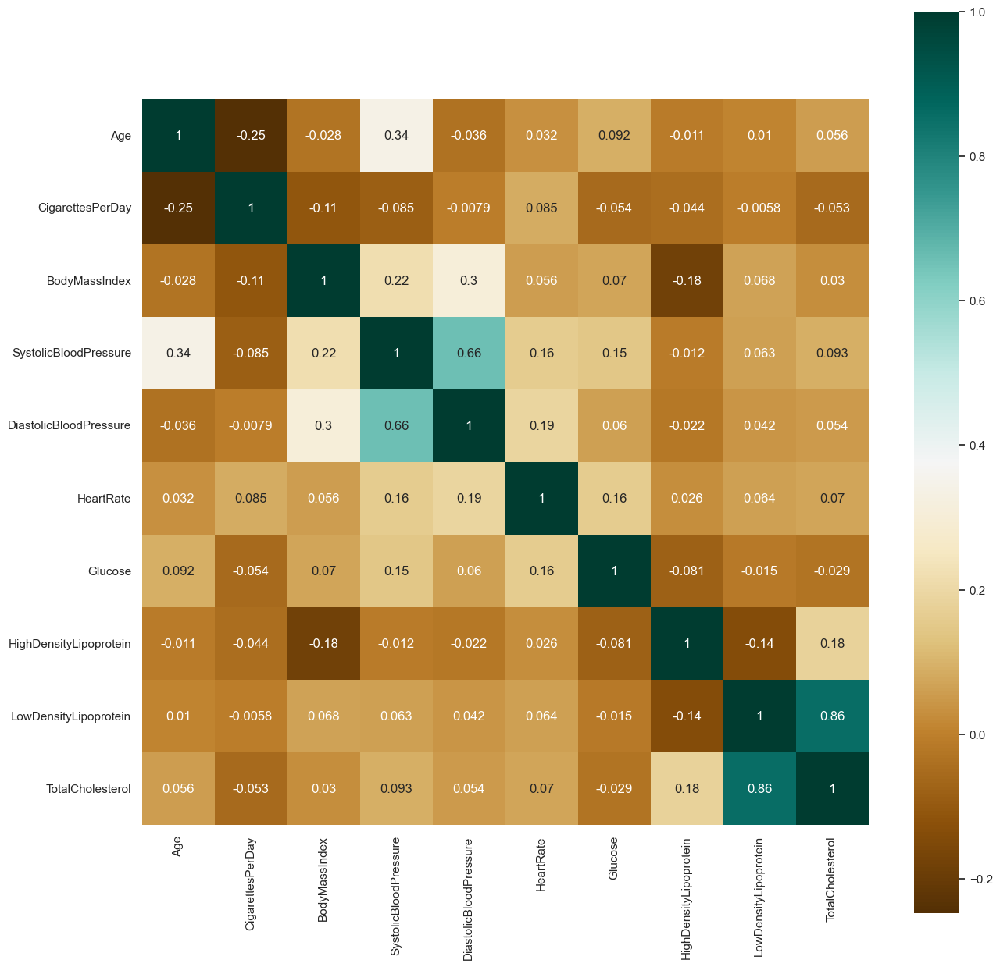

In [66]:
fig, ax = plt.subplots(figsize=(15, 15))
sns.heatmap(Heart.corr(), square=True,annot=True, cmap="BrBG", ax=ax);

# Univariate Data Analysis

**A. Numerical**

**1. Histogram**

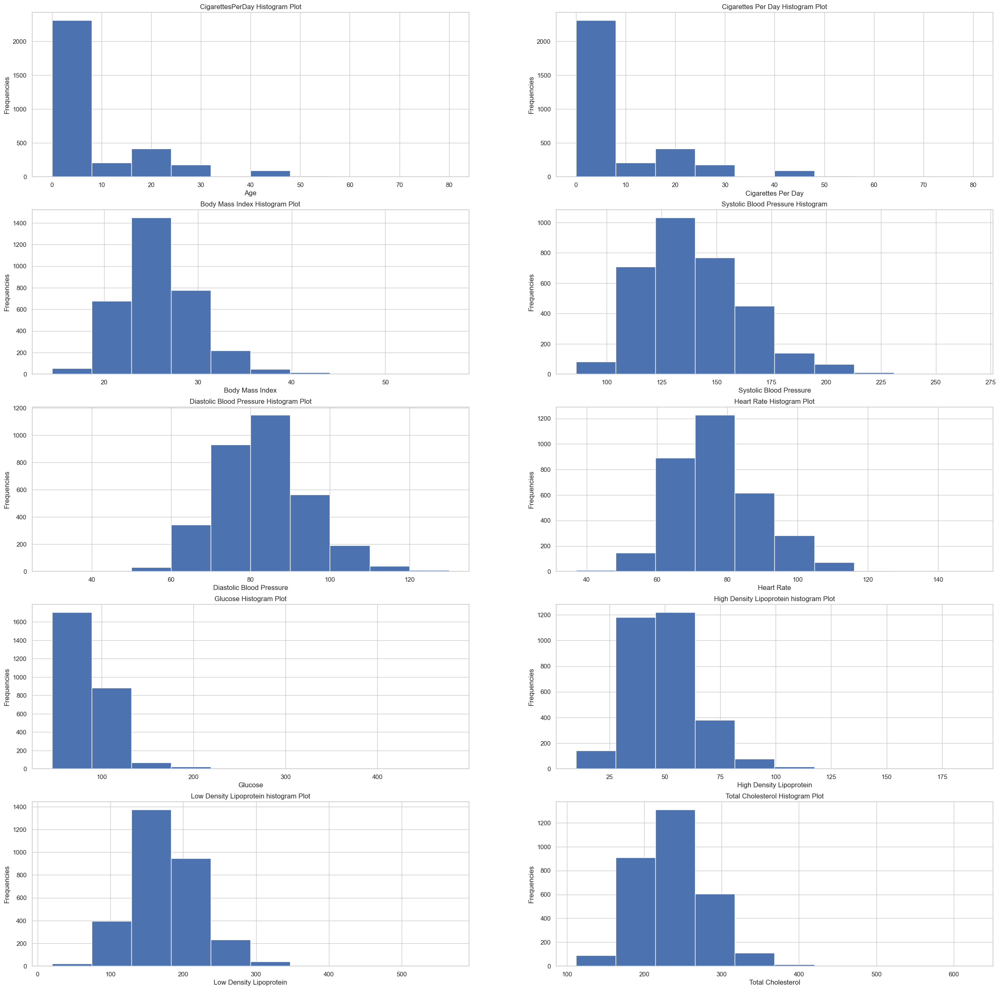

In [67]:
Fig, ax = plt.subplots(nrows=5,ncols=2,figsize=(30 , 30))
ax[0, 0].hist(Heart['CigarettesPerDay'],)
ax[0, 0].set(title= "CigarettesPerDay Histogram Plot", xlabel='Age', ylabel='Frequencies');

ax[0, 1].hist(Heart['CigarettesPerDay'],)
ax[0, 1].set(title= "Cigarettes Per Day Histogram Plot", xlabel='Cigarettes Per Day', ylabel='Frequencies');

ax[1, 0].hist(Heart['BodyMassIndex'],)
ax[1, 0].set(title= "Body Mass Index Histogram Plot",xlabel='Body Mass Index', ylabel='Frequencies');

ax[1, 1].hist(Heart['SystolicBloodPressure'])
ax[1, 1].set(title= "Systolic Blood Pressure Histogram",xlabel='Systolic Blood Pressure', ylabel='Frequencies');

ax[2, 0].hist(Heart['DiastolicBloodPressure'])
ax[2, 0].set(title= "Diastolic Blood Pressure Histogram Plot",xlabel='Diastolic Blood Pressure', ylabel='Frequencies');

ax[2, 1].hist(Heart['HeartRate'])
ax[2, 1].set(title= "Heart Rate Histogram Plot",xlabel='Heart Rate', ylabel='Frequencies');

ax[3, 0].hist(Heart['Glucose'])
ax[3, 0].set(title= "Glucose Histogram Plot",xlabel='Glucose', ylabel='Frequencies');

ax[3, 1].hist(Heart['HighDensityLipoprotein'])
ax[3, 1].set(title= "High Density Lipoprotein histogram Plot",xlabel='High Density Lipoprotein', ylabel='Frequencies');

ax[4, 0].hist(Heart['LowDensityLipoprotein'])
ax[4, 0].set(title= "Low Density Lipoprotein histogram Plot",xlabel='Low Density Lipoprotein', ylabel='Frequencies');

ax[4, 1].hist(Heart['TotalCholesterol'])
ax[4, 1].set(title= "Total Cholesterol Histogram Plot",xlabel='Total Cholesterol', ylabel='Frequencies');

plt.show()

**2. Kde Plot**

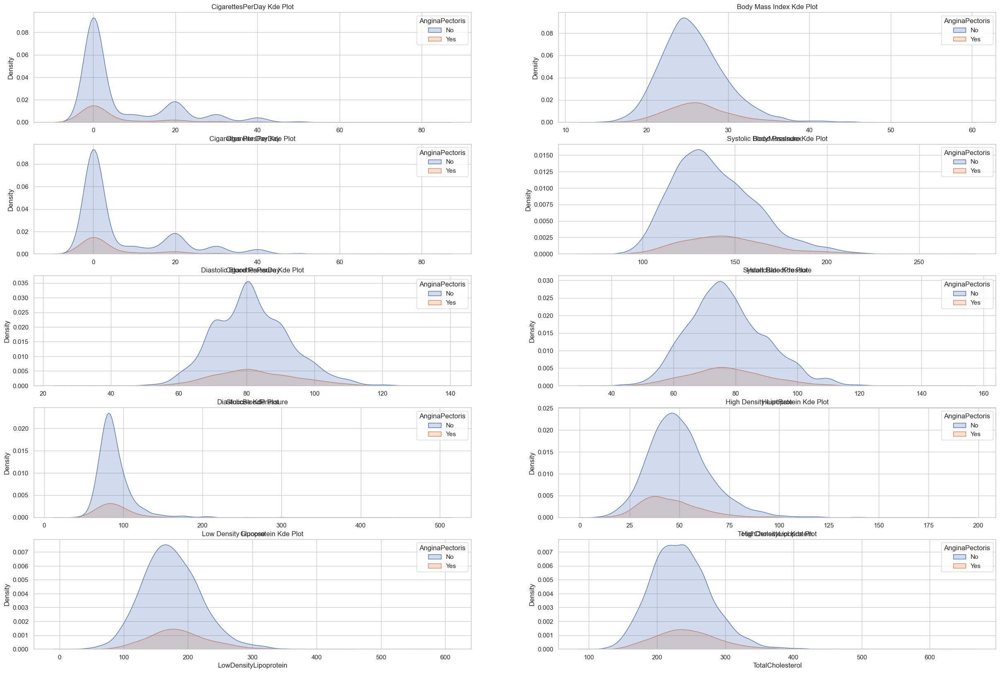

In [68]:
Fig, ((ax1, ax2), (ax3, ax4),(ax5, ax6),(ax7,ax8), (ax9,ax10),) = plt.subplots(nrows=5,
                                            ncols=2,
                                            figsize=(30, 20))
sns.kdeplot(x = Heart['CigarettesPerDay'], ax=ax1, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('CigarettesPerDay Kde Plot');
sns.kdeplot(x = Heart['BodyMassIndex'], ax=ax2, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Body Mass Index Kde Plot');
sns.kdeplot(x = Heart['CigarettesPerDay'], ax=ax3, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Cigarettes Per Day Kde Plot');
sns.kdeplot(x = Heart['SystolicBloodPressure'], ax=ax4, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Systolic Blood Pressure Kde Plot');
sns.kdeplot(x = Heart['DiastolicBloodPressure'], ax=ax5, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Diastolic Blood Pressure Kde Plot');
sns.kdeplot(x = Heart['HeartRate'],ax=ax6, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Heart Rate Kde Plot');
sns.kdeplot(x = Heart['Glucose'], ax=ax7, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Glucose Kde Plot');
sns.kdeplot(x = Heart['HighDensityLipoprotein'], ax=ax8, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('High Density Lipoprotein Kde Plot');
sns.kdeplot(x = Heart['LowDensityLipoprotein'], ax=ax9, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Low Density Lipoprotein Kde Plot');
sns.kdeplot(x = Heart['TotalCholesterol'], ax=ax10, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Total Cholesterol Kde Plot');

**3. Box Plot**

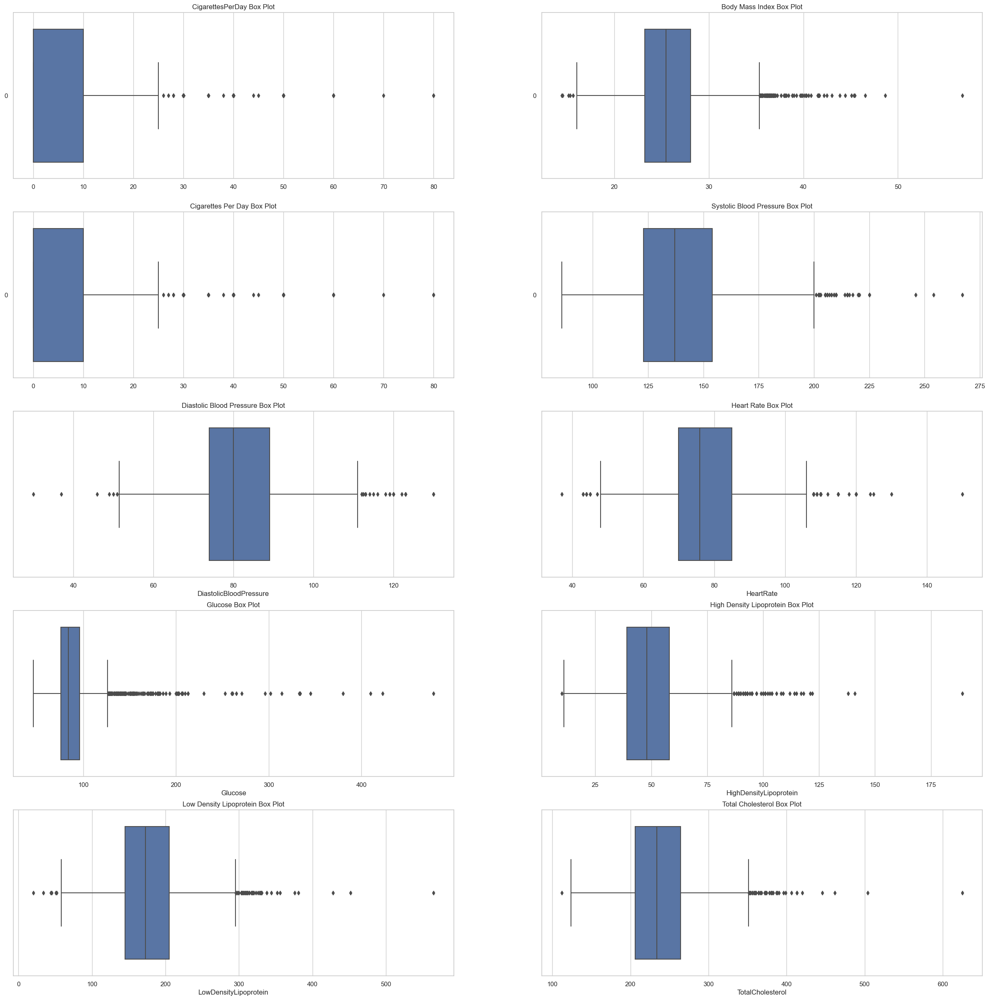

In [69]:
Fig, ((ax1, ax2), (ax3, ax4),(ax5, ax6),(ax7,ax8), (ax9,ax10)) = plt.subplots(nrows=5,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.boxplot(Heart['CigarettesPerDay'],                       ax=ax1, orient='h').set_title('CigarettesPerDay Box Plot');
sns.boxplot(Heart['BodyMassIndex'],             ax=ax2, orient='h').set_title('Body Mass Index Box Plot');
sns.boxplot(Heart['CigarettesPerDay'],          ax=ax3, orient='h').set_title('Cigarettes Per Day Box Plot');
sns.boxplot(Heart['SystolicBloodPressure'],     ax=ax4, orient='h').set_title('Systolic Blood Pressure Box Plot');
sns.boxplot(x = Heart['DiastolicBloodPressure'],    ax=ax5, orient='h').set_title('Diastolic Blood Pressure Box Plot');
sns.boxplot(x = Heart['HeartRate'],                 ax=ax6, orient='h').set_title('Heart Rate Box Plot');
sns.boxplot(x = Heart['Glucose'],                   ax=ax7, orient='h').set_title('Glucose Box Plot');
sns.boxplot(x = Heart['HighDensityLipoprotein'],    ax=ax8, orient='h').set_title('High Density Lipoprotein Box Plot');
sns.boxplot(x = Heart['LowDensityLipoprotein'],     ax=ax9, orient='h').set_title('Low Density Lipoprotein Box Plot');
sns.boxplot(x = Heart['TotalCholesterol'],          ax=ax10, orient='h').set_title('Total Cholesterol Box Plot');

**4. Violin Plot**

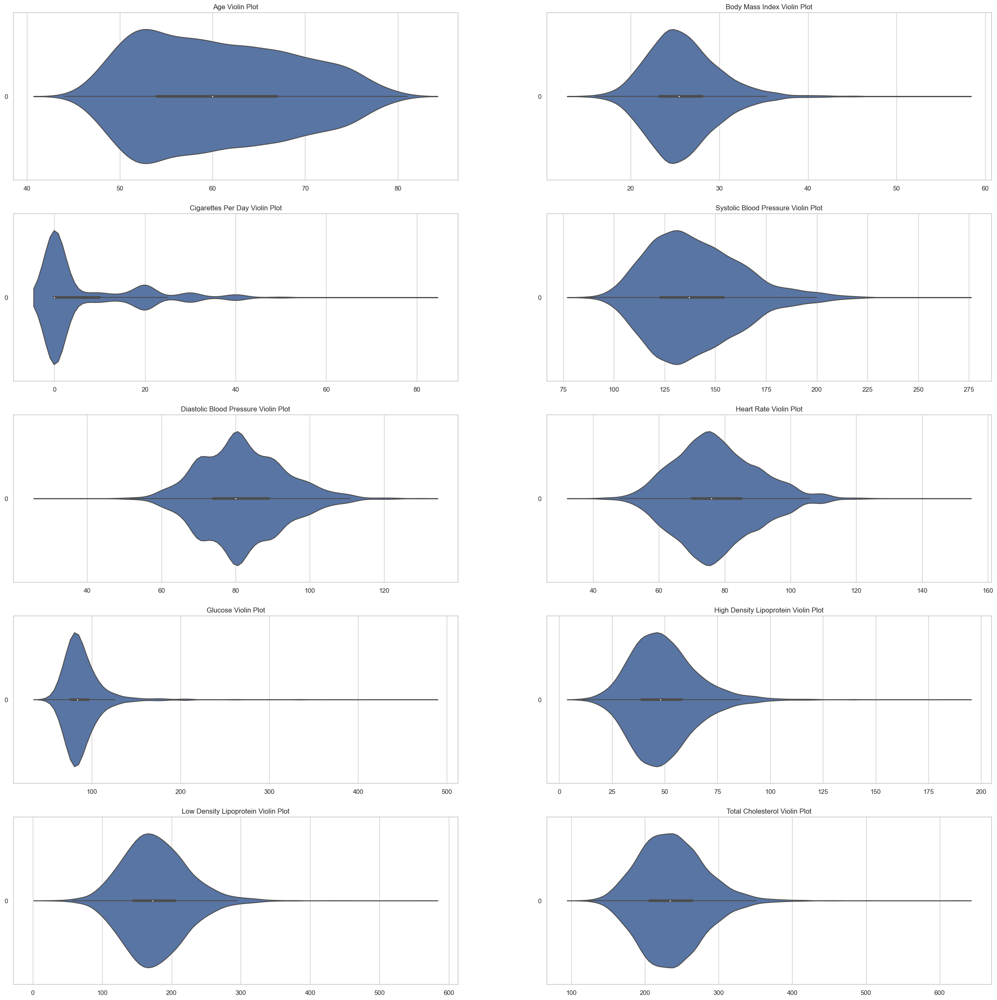

In [70]:
Fig, ((ax1, ax2), (ax3, ax4),(ax5, ax6),(ax7,ax8), (ax9,ax10)) = plt.subplots(nrows=5,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.violinplot(Heart['Age'],                       ax=ax1, orient='h').set_title('Age Violin Plot');
sns.violinplot(Heart['BodyMassIndex'],             ax=ax2, orient='h').set_title('Body Mass Index Violin Plot');
sns.violinplot(Heart['CigarettesPerDay'],          ax=ax3, orient='h').set_title('Cigarettes Per Day Violin Plot');
sns.violinplot(Heart['SystolicBloodPressure'],     ax=ax4, orient='h').set_title('Systolic Blood Pressure Violin Plot');
sns.violinplot(Heart['DiastolicBloodPressure'],    ax=ax5, orient='h').set_title('Diastolic Blood Pressure Violin Plot');
sns.violinplot(Heart['HeartRate'],                 ax=ax6, orient='h').set_title('Heart Rate Violin Plot');
sns.violinplot(Heart['Glucose'],                   ax=ax7, orient='h').set_title('Glucose Violin Plot');
sns.violinplot(Heart['HighDensityLipoprotein'],    ax=ax8, orient='h').set_title('High Density Lipoprotein Violin Plot');
sns.violinplot(Heart['LowDensityLipoprotein'],     ax=ax9, orient='h').set_title('Low Density Lipoprotein Violin Plot');
sns.violinplot(Heart['TotalCholesterol'],          ax=ax10, orient='h').set_title('Total Cholesterol Violin Plot');

**5. Strip Plot**

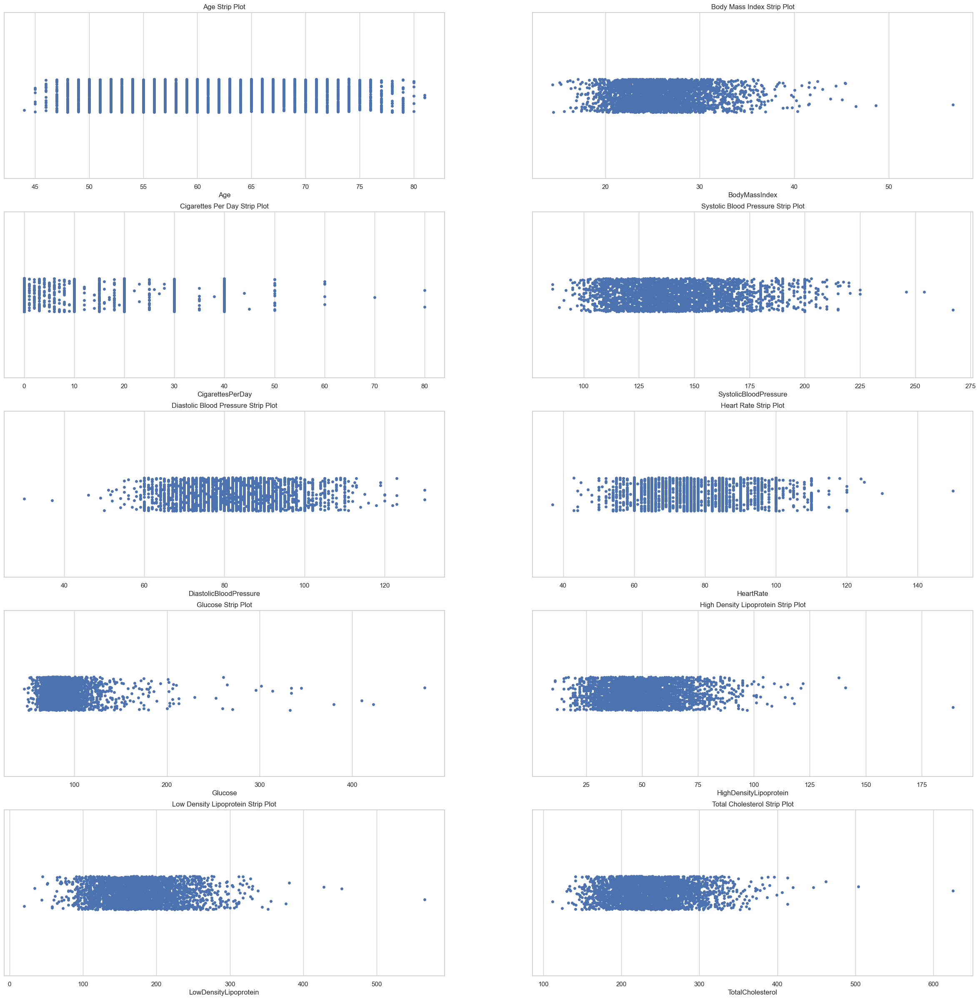

In [71]:
Fig, ((ax1, ax2), (ax3, ax4),(ax5, ax6),(ax7,ax8), (ax9,ax10)) = plt.subplots(nrows=5,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.stripplot(x = Heart['Age'],  ax=ax1, orient='h').set_title('Age Strip Plot');

sns.stripplot(x = Heart['BodyMassIndex'],  ax=ax2, orient='h').set_title('Body Mass Index Strip Plot');

sns.stripplot(x = Heart['CigarettesPerDay'], ax=ax3, orient='h').set_title('Cigarettes Per Day Strip Plot');

sns.stripplot(x = Heart['SystolicBloodPressure'], ax=ax4, orient='h').set_title('Systolic Blood Pressure Strip Plot');

sns.stripplot(x = Heart['DiastolicBloodPressure'], ax=ax5, orient='h').set_title('Diastolic Blood Pressure Strip Plot');

sns.stripplot(x = Heart['HeartRate'], ax=ax6, orient='h').set_title('Heart Rate Strip Plot');

sns.stripplot(x = Heart['Glucose'],  ax=ax7, orient='h').set_title('Glucose Strip Plot');

sns.stripplot(x = Heart['HighDensityLipoprotein'], ax=ax8, orient='h').set_title('High Density Lipoprotein Strip Plot');

sns.stripplot(x = Heart['LowDensityLipoprotein'], ax=ax9, orient='h').set_title('Low Density Lipoprotein Strip Plot');

sns.stripplot(x = Heart['TotalCholesterol'], ax=ax10, orient='h').set_title('Total Cholesterol Strip Plot');

**6. Dist Plot**

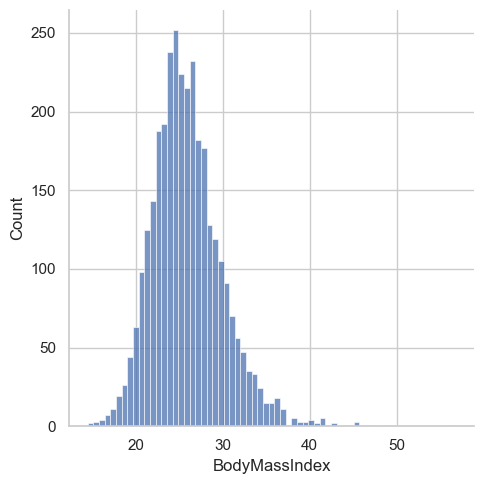

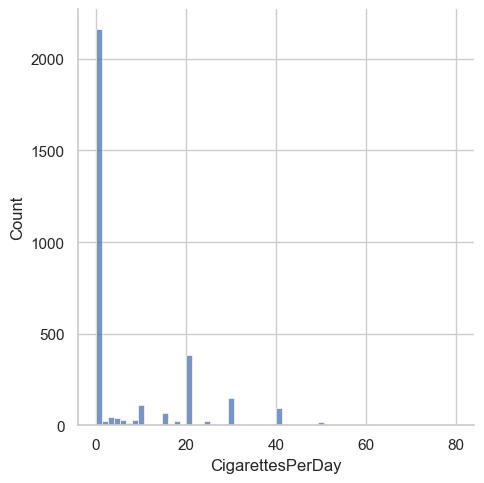

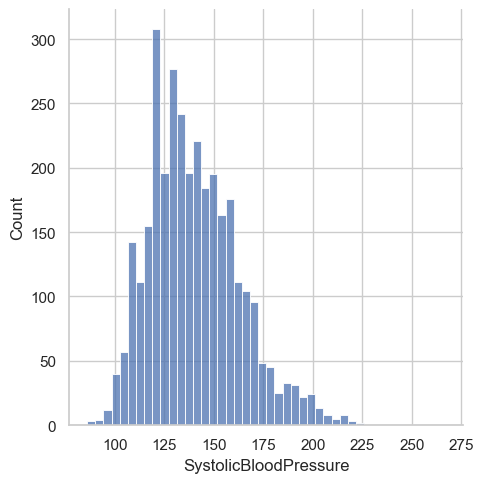

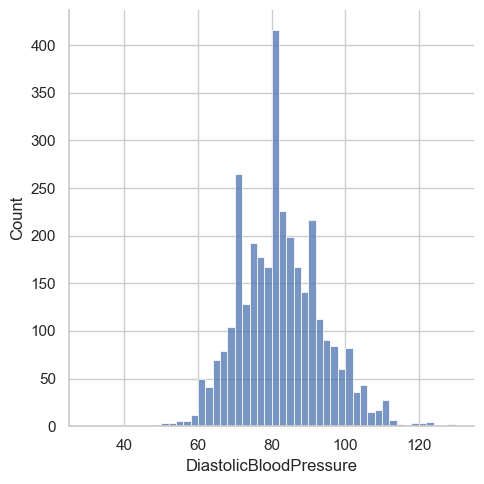

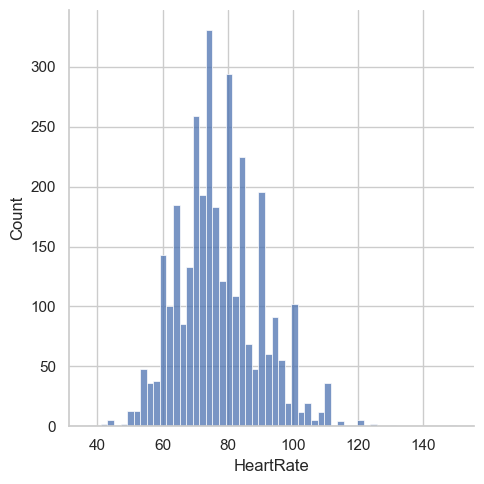

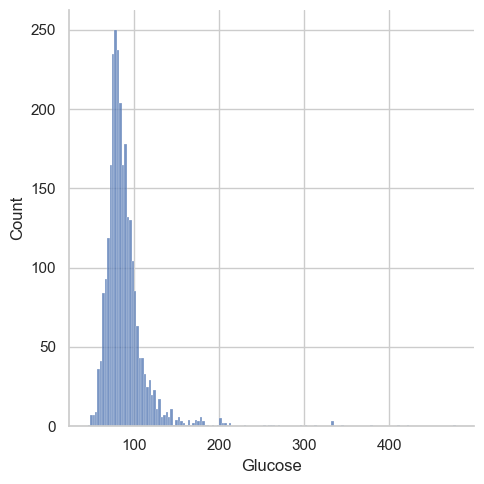

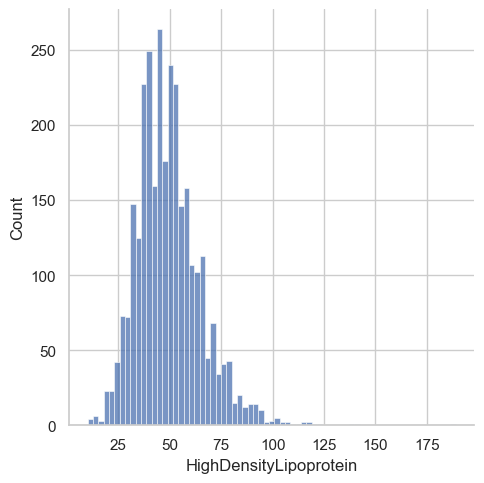

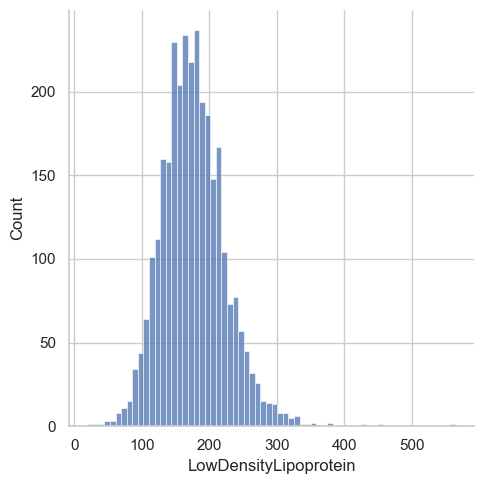

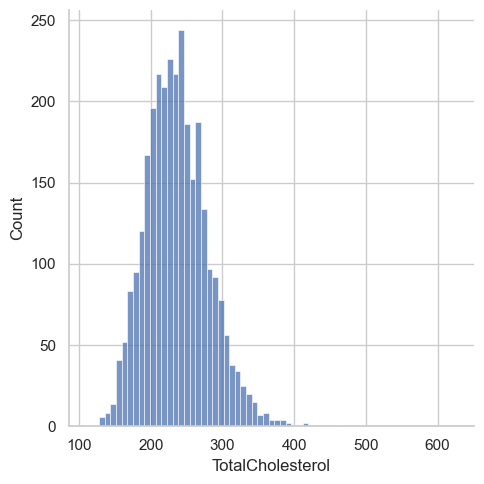

In [72]:
sns.displot(Heart['BodyMassIndex']);

sns.displot(Heart['CigarettesPerDay']);

sns.displot(Heart['SystolicBloodPressure']);

sns.displot(Heart['DiastolicBloodPressure']);

sns.displot(Heart['HeartRate']);

sns.displot(Heart['Glucose']);

sns.displot(Heart['HighDensityLipoprotein']);

sns.displot(Heart['LowDensityLipoprotein']);

sns.displot(Heart['TotalCholesterol']);

**7. Boxen Plot**

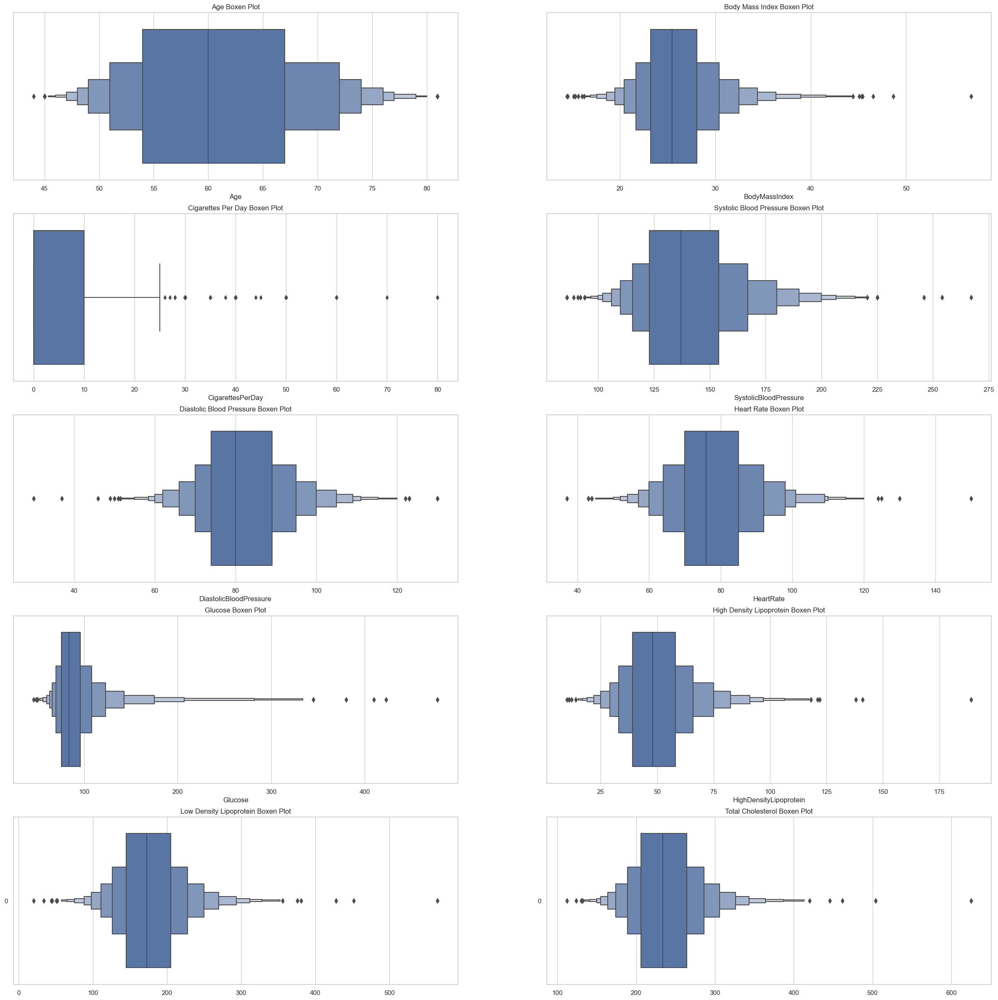

In [73]:
Fig, ((ax1, ax2), (ax3, ax4),(ax5, ax6),(ax7,ax8), (ax9,ax10)) = plt.subplots(nrows=5,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.boxenplot(x = Heart['Age'],ax=ax1, orient='h').set_title('Age Boxen Plot');

sns.boxenplot(x = Heart['BodyMassIndex'],ax=ax2, orient='h').set_title('Body Mass Index Boxen Plot');

sns.boxplot(x = Heart['CigarettesPerDay'], ax=ax3, orient='h').set_title('Cigarettes Per Day Boxen Plot');

sns.boxenplot(x = Heart['SystolicBloodPressure'], ax=ax4, orient='h').set_title('Systolic Blood Pressure Boxen Plot');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], ax=ax5, orient='h').set_title('Diastolic Blood Pressure Boxen Plot');

sns.boxenplot(x =Heart['HeartRate'], ax=ax6, orient='h').set_title('Heart Rate Boxen Plot');

sns.boxenplot(x = Heart['Glucose'], ax=ax7, orient='h').set_title('Glucose Boxen Plot');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], ax=ax8, orient='h').set_title('High Density Lipoprotein Boxen Plot');

sns.boxenplot(Heart['LowDensityLipoprotein'], ax=ax9, orient='h').set_title('Low Density Lipoprotein Boxen Plot');

sns.boxenplot(Heart['TotalCholesterol'], ax=ax10, orient='h').set_title('Total Cholesterol Boxen Plot');

**B. Categeoriacl**

**1. Count Plot**

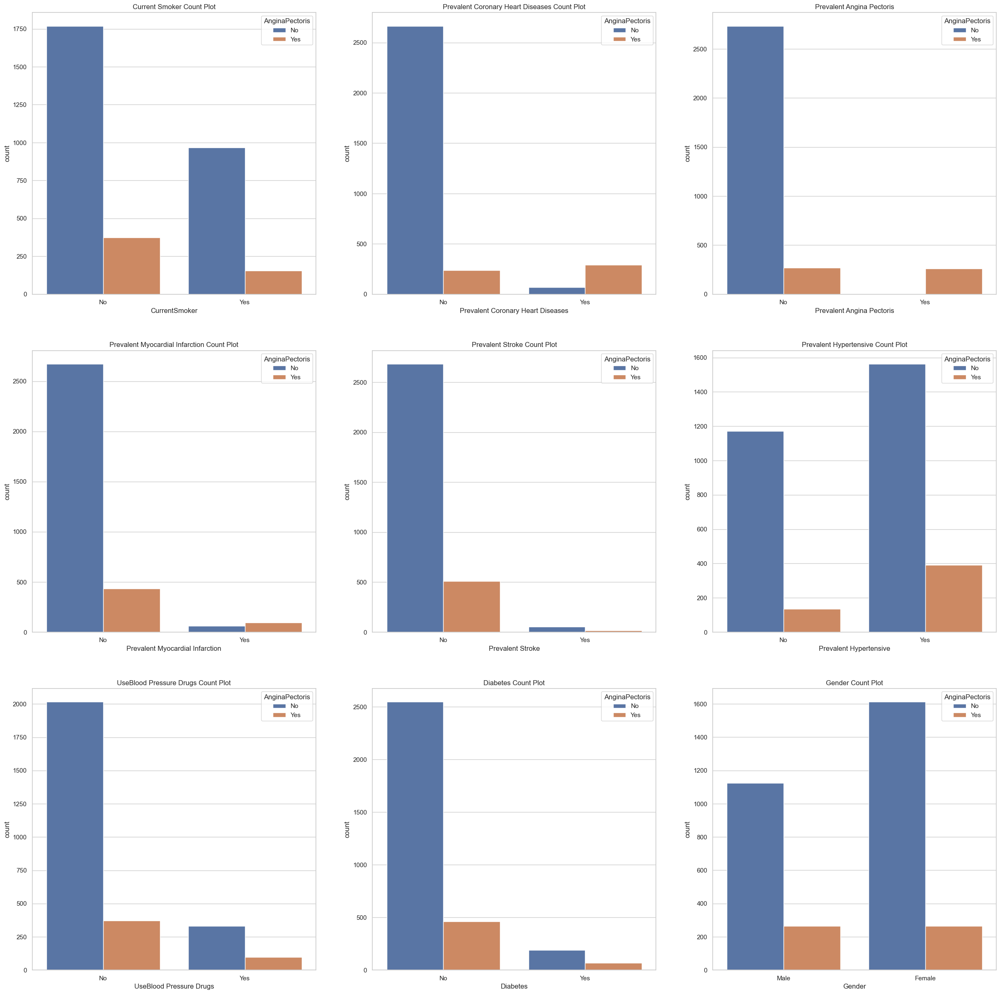

In [74]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
                                           
sns.countplot(x = Heart['CurrentSmoker'],                       ax=ax1, hue=Heart['AnginaPectoris']).set_title('Current Smoker Count Plot');
ax1.set(xlabel='CurrentSmoker');

sns.countplot(x =  Heart['PrevalentCoronaryHeartDiseases'],      ax=ax2, hue=Heart['AnginaPectoris']).set_title('Prevalent Coronary Heart Diseases Count Plot');
ax2.set(xlabel='Prevalent Coronary Heart Diseases')

sns.countplot(x = Heart['PrevalentAnginaPectoris'],             ax=ax3, hue=Heart['AnginaPectoris']).set_title('Prevalent Angina Pectoris');
ax3.set(xlabel='Prevalent Angina Pectoris');

sns.countplot(x =  Heart['PrevalentMyocardialInfarction'],       ax=ax4, hue=Heart['AnginaPectoris']).set_title('Prevalent Myocardial Infarction Count Plot');
ax4.set(xlabel='Prevalent Myocardial Infarction')

sns.countplot(x =  Heart['PrevalentStroke'],                      ax=ax5, hue=Heart['AnginaPectoris']).set_title('Prevalent Stroke Count Plot');
ax5.set(xlabel='Prevalent Stroke');

sns.countplot(x =  Heart['PrevalentHypertensive'],               ax=ax6, hue=Heart['AnginaPectoris']).set_title('Prevalent Hypertensive Count Plot');
ax6.set(xlabel='Prevalent Hypertensive');

sns.countplot(x =  Heart['UseBloodPressureDrugs'],               ax=ax7, hue=Heart['AnginaPectoris']).set_title('UseBlood Pressure Drugs Count Plot');
ax7.set(xlabel='UseBlood Pressure Drugs');

sns.countplot(x = Heart['Diabetes'],                            ax=ax8, hue=Heart['AnginaPectoris']).set_title('Diabetes Count Plot');
ax8.set(xlabel='Diabetes');

sns.countplot(x = Heart['Gender'],                              ax=ax9, hue=Heart['AnginaPectoris']).set_title('Gender Count Plot');
ax9.set(xlabel='Gender');

**2. Pie Chart**

**A. Gender**

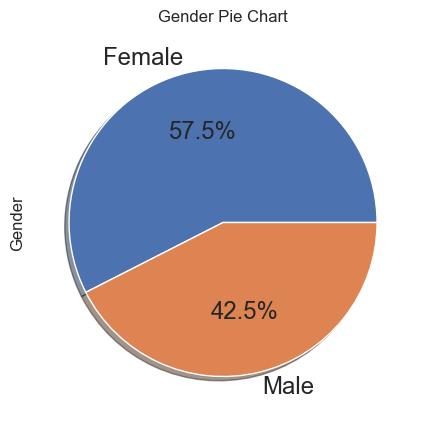

In [75]:
Heart['Gender'].value_counts().plot.pie(autopct = '%0.1f%%',
                                    textprops={'size':'x-large'},
                                    shadow = True,
                                    title = "Gender Pie Chart",
                                    figsize = (5,5),
                                    ylabel = 'Gender');

**B. Current Smoker**

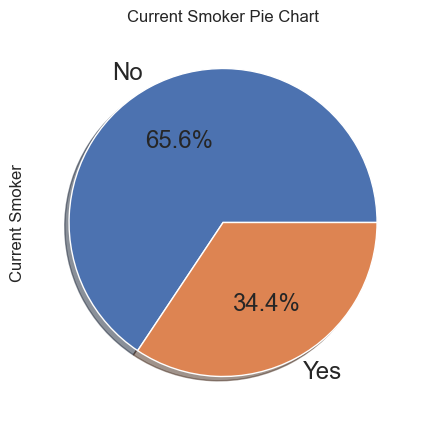

In [76]:
y = Heart['CurrentSmoker'].value_counts().plot.pie(autopct = '%0.1f%%',
                                           textprops = {'size': 'x-large'},
                                           shadow = True,
                                           title = 'Current Smoker Pie Chart',
                                           figsize = (5,5),
                                           ylabel = 'Current Smoker');

**C. Prevalent Coronary Heart Diseases**

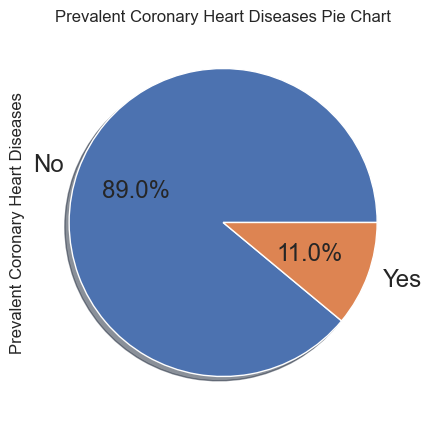

In [77]:
y = Heart['PrevalentCoronaryHeartDiseases'].value_counts().plot.pie(autopct = '%0.1f%%',
                                                            textprops = {'size': 'x-large'},
                                                            shadow = True,
                                                            title = 'Prevalent Coronary Heart Diseases Pie Chart',
                                                            figsize = (5,5),
                                                            ylabel = 'Prevalent Coronary Heart Diseases');

**D. Prevalent Angina Pectoris**

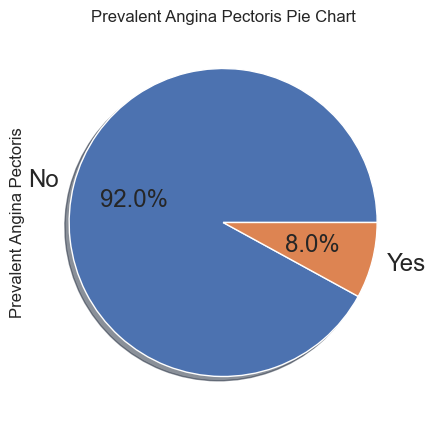

In [78]:
y = Heart['PrevalentAnginaPectoris'].value_counts().plot.pie(autopct = '%0.1f%%',
                                                    textprops = {'size': 'x-large'},
                                                    shadow = True,
                                                    title = 'Prevalent Angina Pectoris Pie Chart',
                                                    figsize = (5,5),
                                                    ylabel = 'Prevalent Angina Pectoris')

**E. Prevalent Myocardial Infarction**

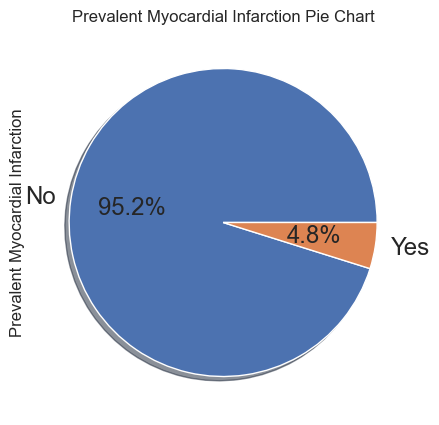

In [79]:
y = Heart['PrevalentMyocardialInfarction'].value_counts().plot.pie(autopct = '%0.1f%%',
                                                           textprops = {'size': 'x-large'},
                                                           shadow = True,
                                                           title = "Prevalent Myocardial Infarction Pie Chart",
                                                           figsize = (5,5),
                                                           ylabel = 'Prevalent Myocardial Infarction');

**F. Prevalent Stroke**

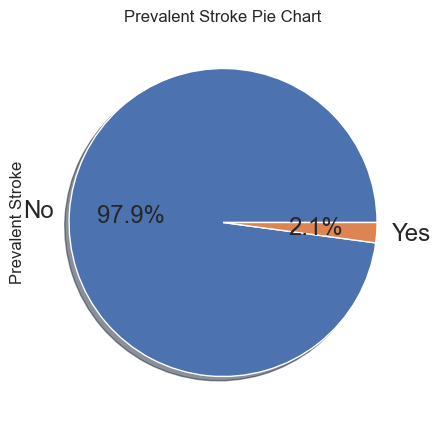

In [80]:
y = Heart['PrevalentStroke'].value_counts().plot.pie(autopct = "%0.1f%%",
                                             textprops = {'size':'x-large'},
                                             shadow = True,
                                             title = 'Prevalent Stroke Pie Chart',
                                             figsize = (5,5),
                                             ylabel = 'Prevalent Stroke');

**G. Prevalent Hypertensive**

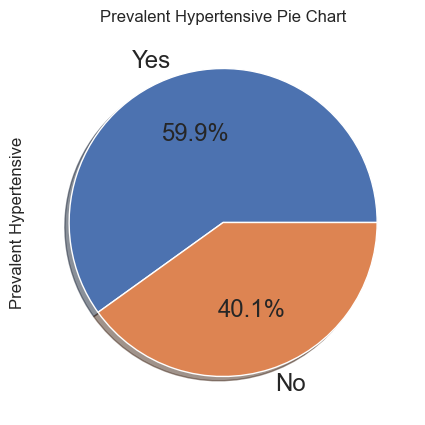

In [81]:
y = Heart['PrevalentHypertensive'].value_counts().plot.pie(autopct = '%0.1f%%',
                                                   textprops = {'size': 'x-large'},
                                                   shadow = True,
                                                   title = 'Prevalent Hypertensive Pie Chart',
                                                   figsize = (5,5),
                                                   ylabel = 'Prevalent Hypertensive');

**J. Use Blood Pressure Drugs**

<Axes: title={'center': 'Use Blood Pressure Drugs Pie Chart'}, ylabel='Use Blood Pressure Drugs'>

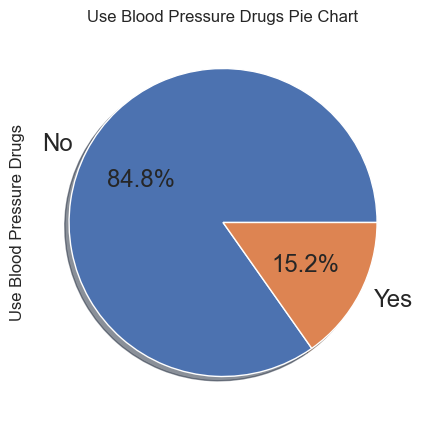

In [82]:
Heart['UseBloodPressureDrugs'].value_counts().plot.pie(autopct = '%0.1f%%',
                                                   textprops = {'size': 'x-large'},
                                                   shadow = True,
                                                   title = 'Use Blood Pressure Drugs Pie Chart',
                                                   figsize = (5,5),
                                                   ylabel = 'Use Blood Pressure Drugs')

**H. Diabetes**

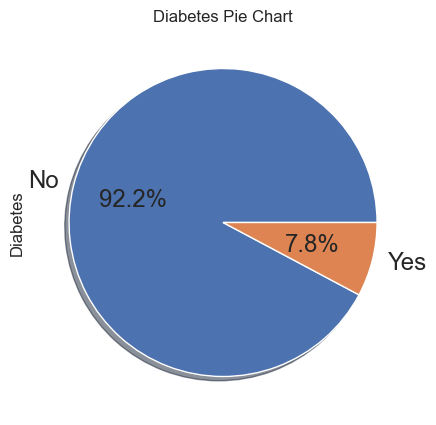

In [83]:
y = Heart['Diabetes'].value_counts().plot.pie(autopct = "%0.1f%%",
                                      textprops = {'size': 'x-large'},
                                      shadow = True,
                                      title = 'Diabetes Pie Chart',
                                      figsize = (5,5),
                                      ylabel ='Diabetes');

# Bivariate Data Analysis

**1.Pair Plot**

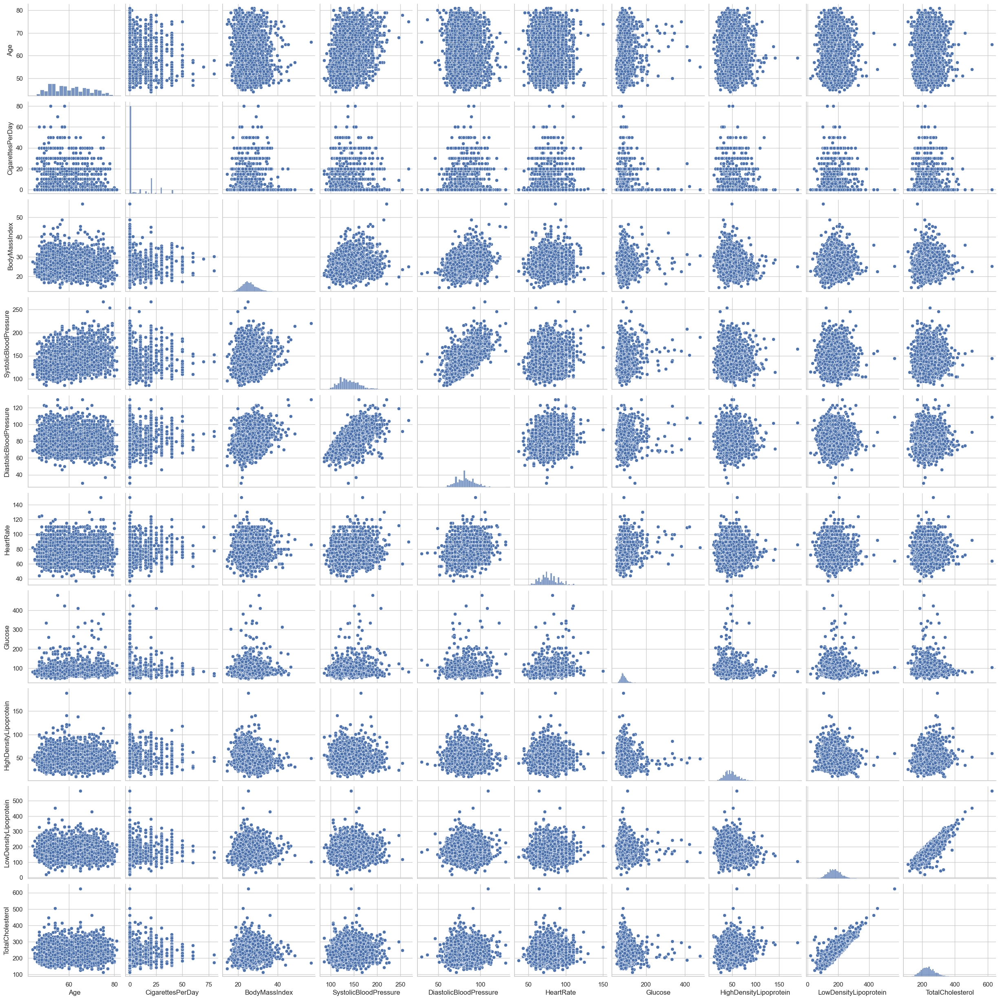

In [84]:
sns.pairplot(Heart);

**2.Scatter Plot**

**A. Age**

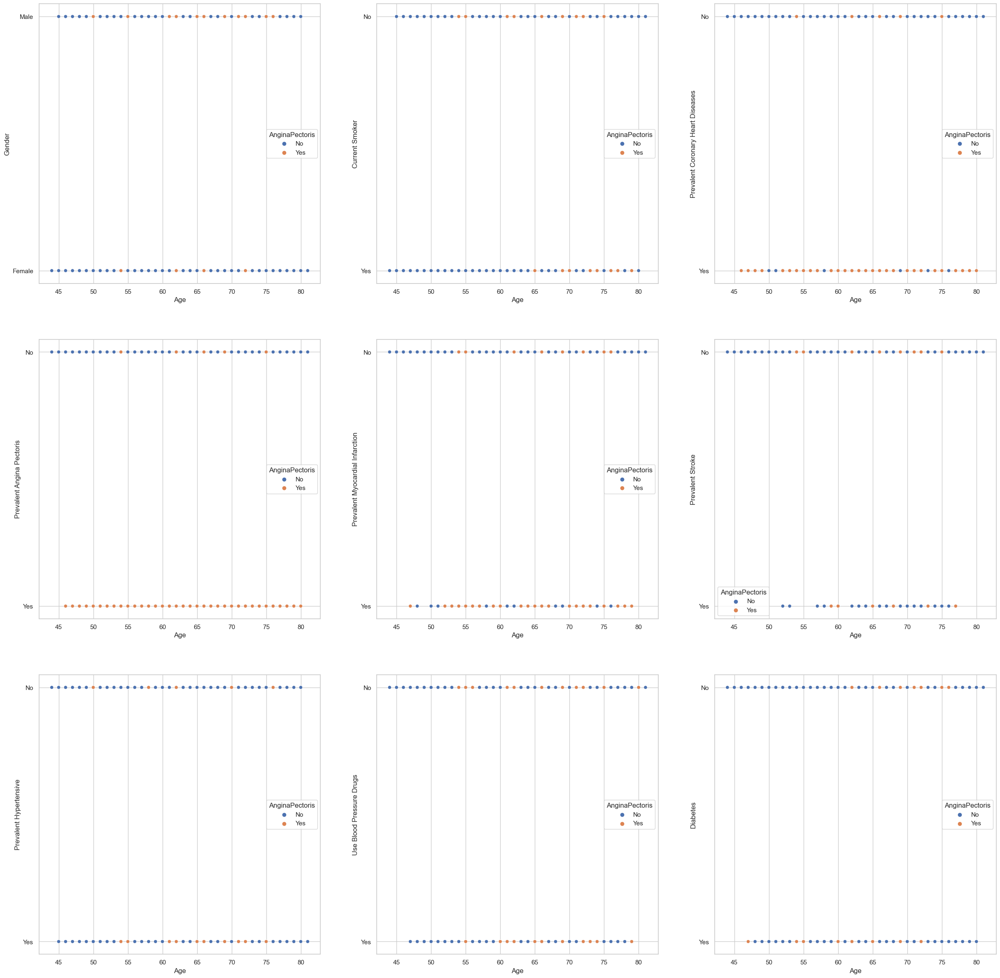

In [85]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x = Heart['Age'], y = Heart['Gender'],                              ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Age', ylabel='Gender');

sns.scatterplot(x = Heart['Age'], y = Heart['CurrentSmoker'],                       ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Age', ylabel='Current Smoker');

sns.scatterplot(x = Heart['Age'], y = Heart['PrevalentCoronaryHeartDiseases'],      ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Age', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['Age'], y = Heart['PrevalentAnginaPectoris'],             ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Age', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['Age'], y = Heart['PrevalentMyocardialInfarction'],       ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Age', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['Age'], y = Heart['PrevalentStroke'] ,                    ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Age', ylabel='Prevalent Stroke');

sns.scatterplot(x = Heart['Age'], y = Heart['PrevalentHypertensive'],               ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Age', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['Age'], y =  Heart['UseBloodPressureDrugs'],               ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Age', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['Age'], y = Heart['Diabetes'],                            ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Age', ylabel='Diabetes');

**B. Cigarettes Per Day**

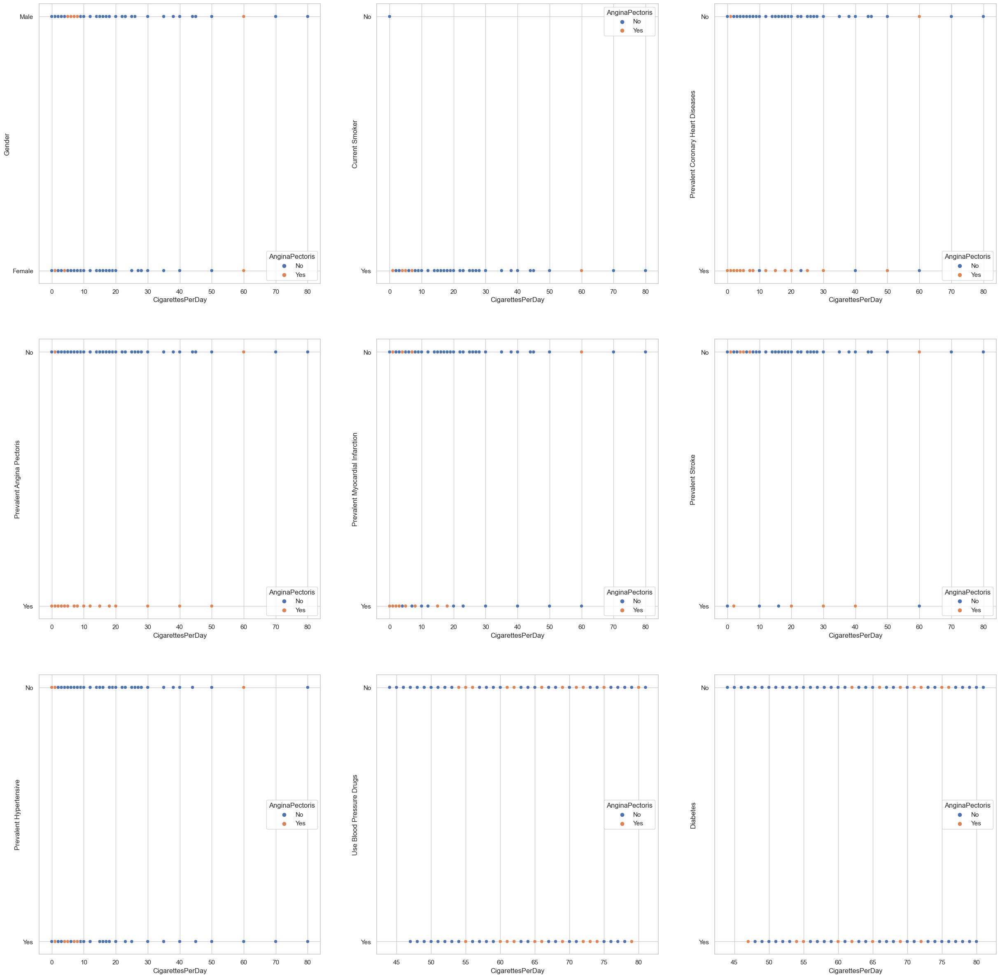

In [86]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['Gender'],                              ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='CigarettesPerDay', ylabel='Gender');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['CurrentSmoker'],                       ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='CigarettesPerDay', ylabel='Current Smoker');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentCoronaryHeartDiseases'],      ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='CigarettesPerDay', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentAnginaPectoris'],             ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='CigarettesPerDay', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentMyocardialInfarction'],       ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='CigarettesPerDay', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentStroke'] ,                    ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='CigarettesPerDay', ylabel='Prevalent Stroke');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentHypertensive'],               ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='CigarettesPerDay', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['Age'], y =  Heart['UseBloodPressureDrugs'],               ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='CigarettesPerDay', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['Age'], y = Heart['Diabetes'],                            ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='CigarettesPerDay', ylabel='Diabetes');

**C. Body Mass Index**

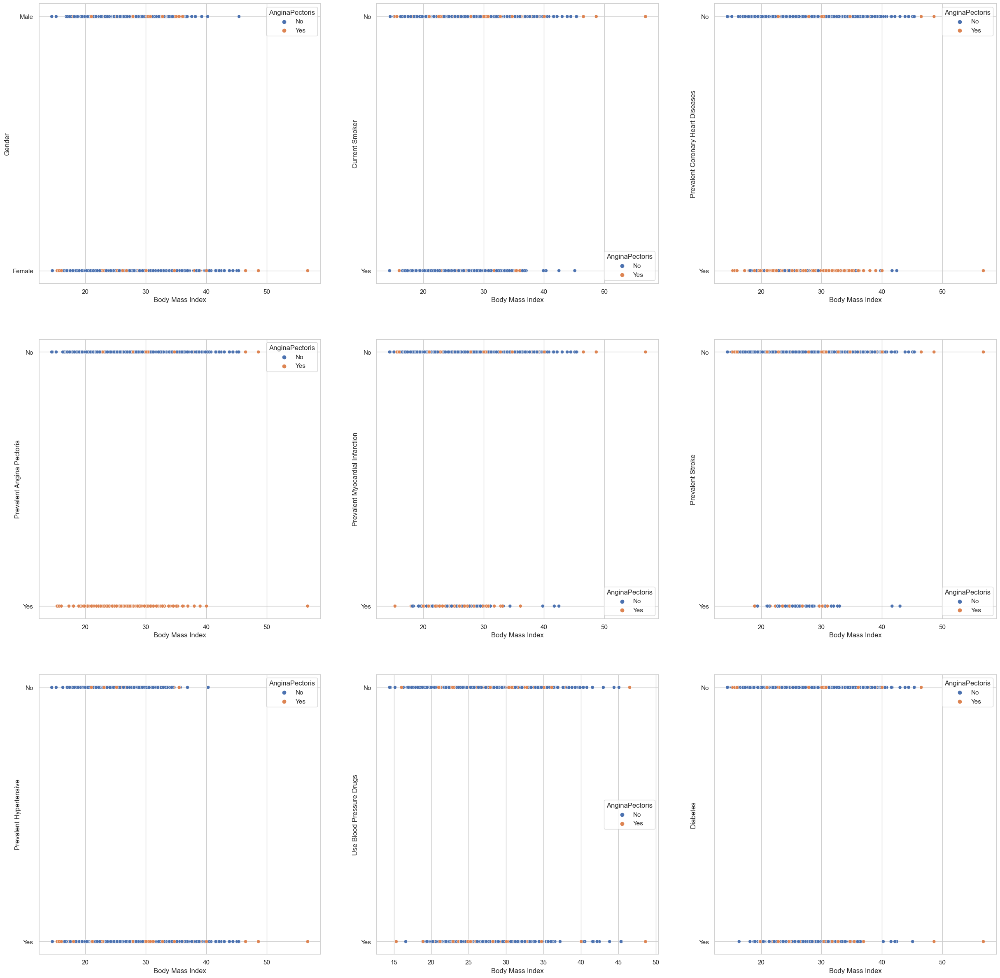

In [87]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Body Mass Index', ylabel='Gender');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Body Mass Index', ylabel='Current Smoker');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Body Mass Index', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Body Mass Index', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Body Mass Index', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Body Mass Index', ylabel='Prevalent Stroke');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Body Mass Index', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['BodyMassIndex'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Body Mass Index', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Body Mass Index', ylabel='Diabetes');                      

**D. Systolic Blood Pressure**

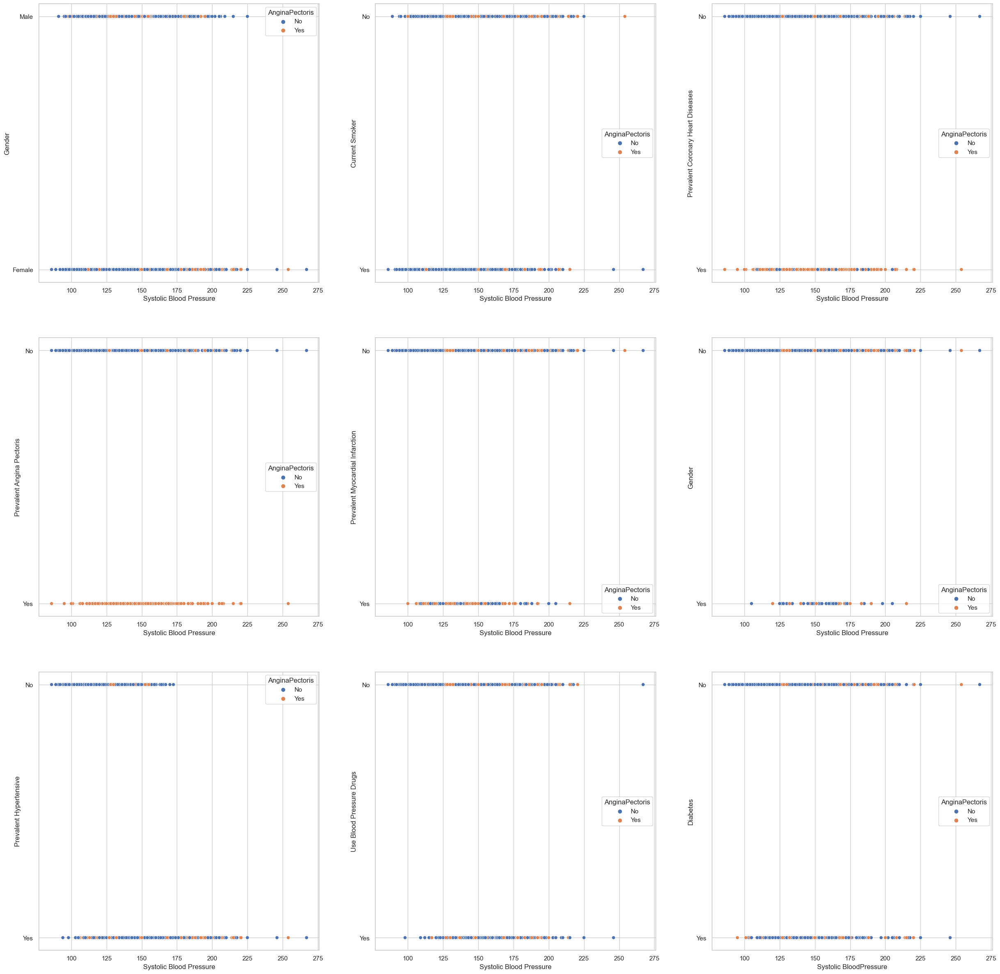

In [88]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x = Heart['SystolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Systolic Blood Pressure', ylabel='Current Smoker');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['SystolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Systolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Systolic BloodPressure', ylabel='Diabetes');                     

**E. Diastolic Blood Pressure**

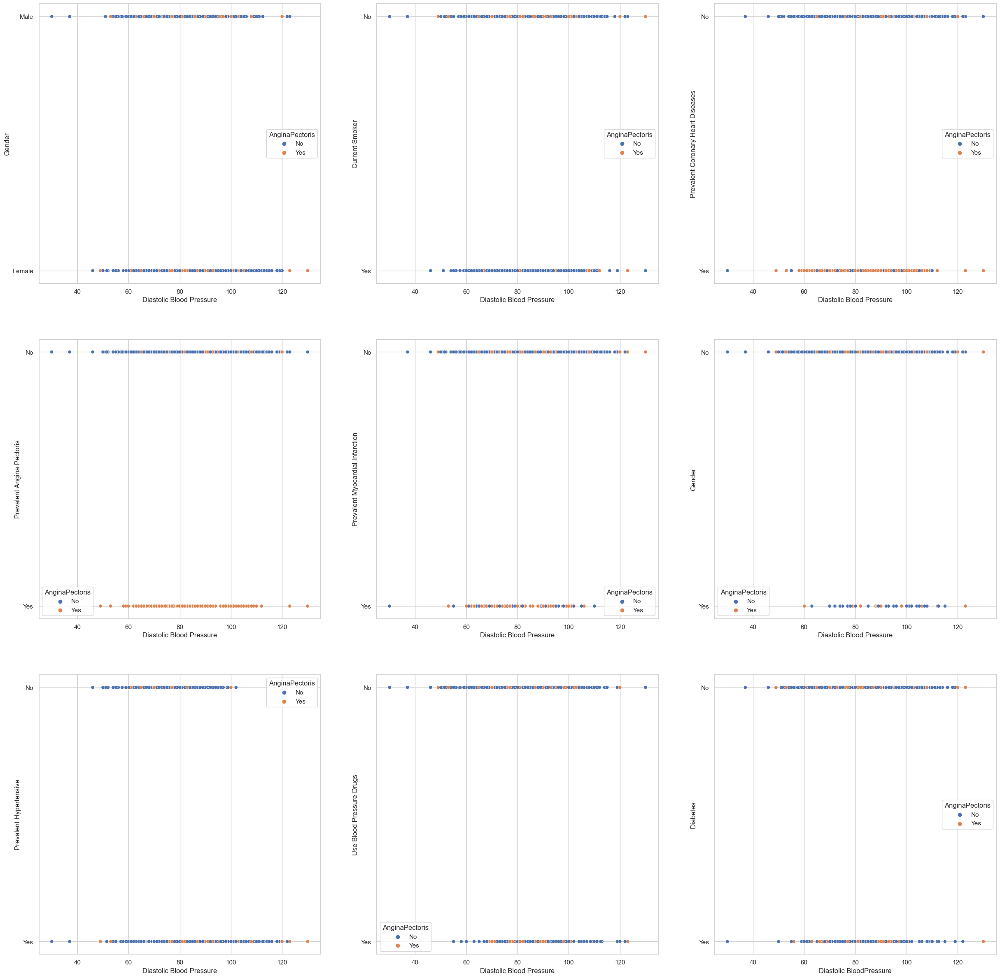

In [89]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x = Heart['DiastolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Diastolic Blood Pressure', ylabel='Current Smoker');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['DiastolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Diastolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Diastolic BloodPressure', ylabel='Diabetes');                                         

**F. Heart Rate**

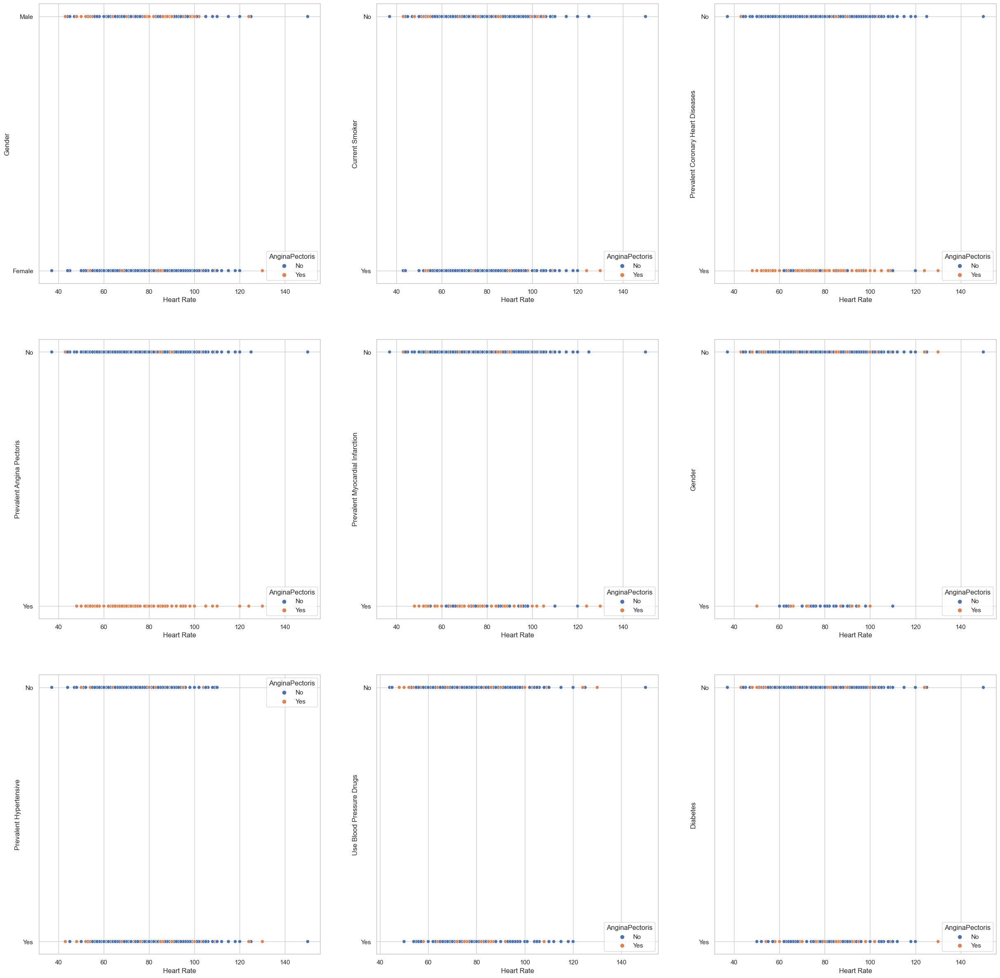

In [90]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x = Heart['HeartRate'], y =Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Heart Rate', ylabel='Gender');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Heart Rate', ylabel='Current Smoker');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Heart Rate', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Heart Rate', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Heart Rate', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Heart Rate', ylabel='Gender');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Heart Rate', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Heart Rate', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Heart Rate', ylabel='Diabetes');                                         

**F. Glucose**

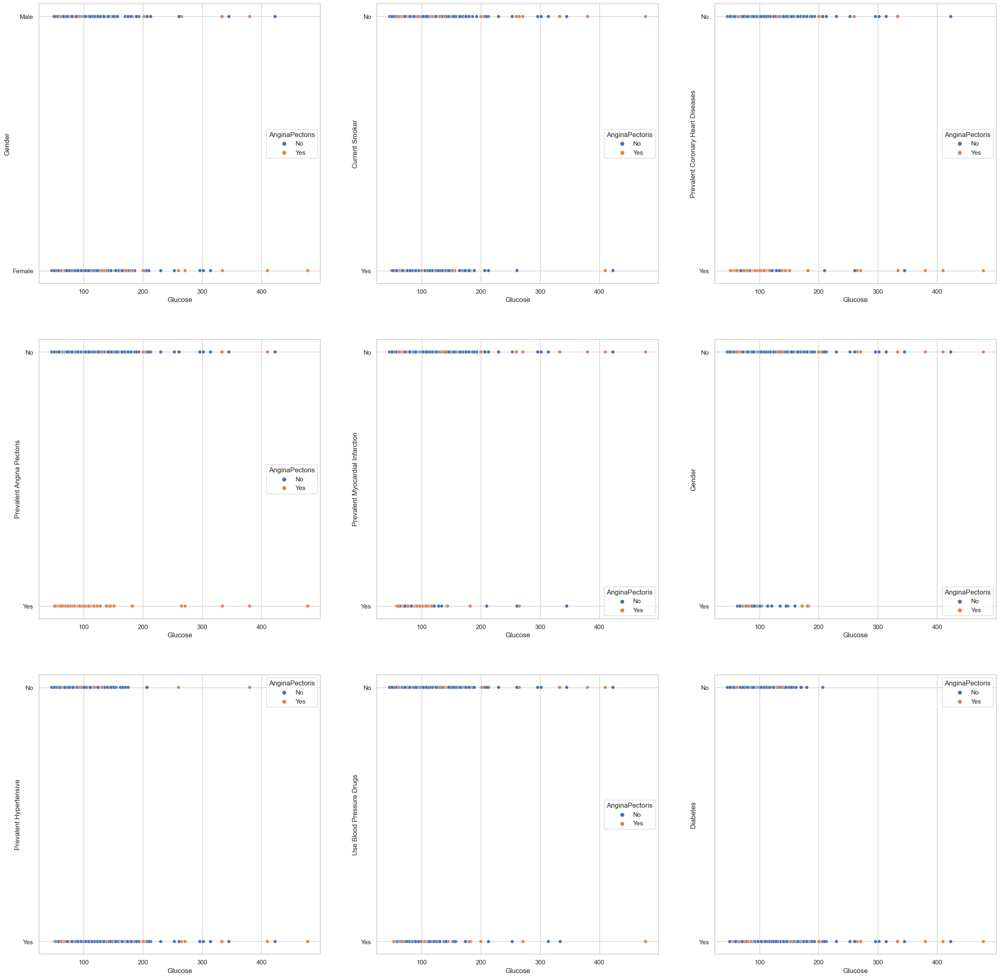

In [91]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x = Heart['Glucose'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Glucose', ylabel='Gender');

sns.scatterplot(x = Heart['Glucose'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Glucose', ylabel='Current Smoker');

sns.scatterplot(x = Heart['Glucose'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Glucose', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['Glucose'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Glucose', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x =Heart['Glucose'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Glucose', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x =Heart['Glucose'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Glucose', ylabel='Gender');

sns.scatterplot(x =Heart['Glucose'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Glucose', ylabel='Prevalent Hypertensive');

sns.scatterplot(x =Heart['Glucose'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Glucose', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x =Heart['Glucose'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Glucose', ylabel='Diabetes'); 

**G. High Density Lipoprotein**

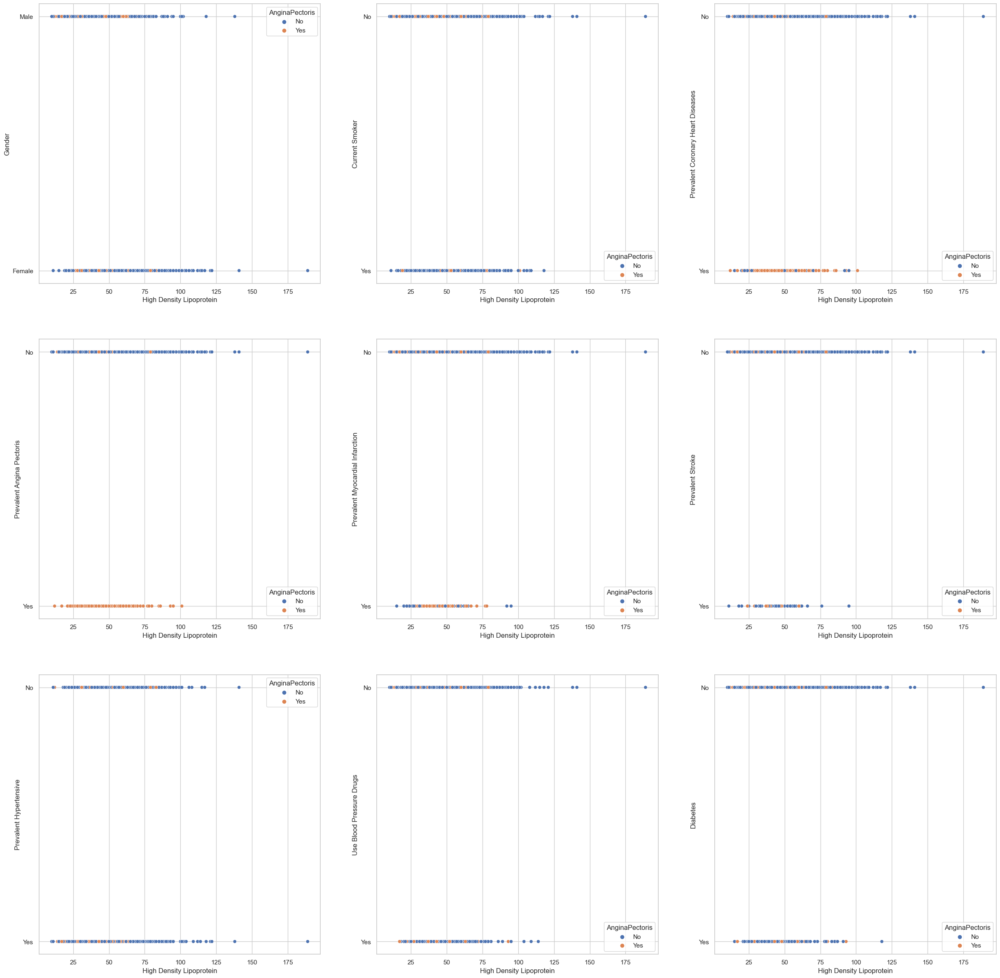

In [92]:
# H. HighDensityLipoprotein
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x =Heart['HighDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='High Density Lipoprotein', ylabel='Gender');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='High Density Lipoprotein', ylabel='Current Smoker');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Stroke');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.scatterplot(x =Heart['HighDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='High Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='High Density Lipoprotein', ylabel='Diabetes');  

**J. Low Density Lipoprotein**

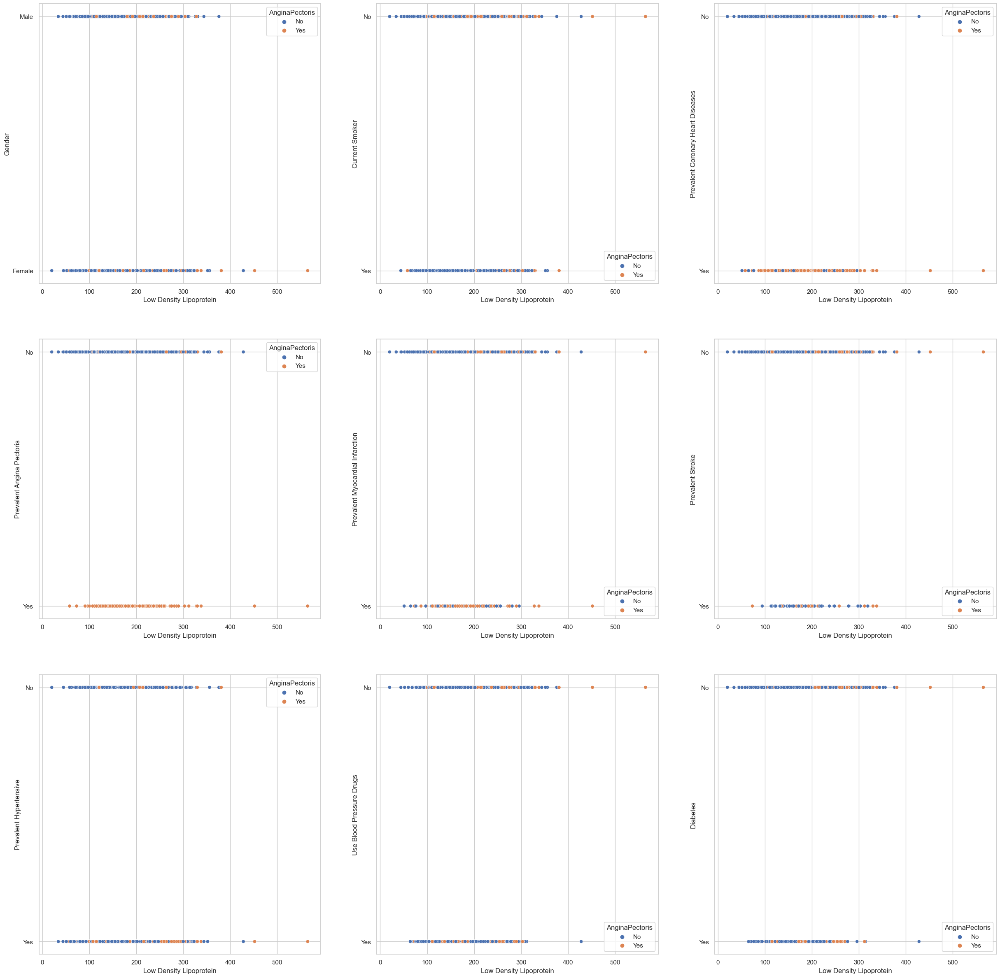

In [93]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x= Heart['LowDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Low Density Lipoprotein', ylabel='Gender');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Low Density Lipoprotein', ylabel='Current Smoker');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Stroke');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.scatterplot(x =Heart['LowDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Low Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Low Density Lipoprotein', ylabel='Diabetes');  

**K. Total Cholesterol**

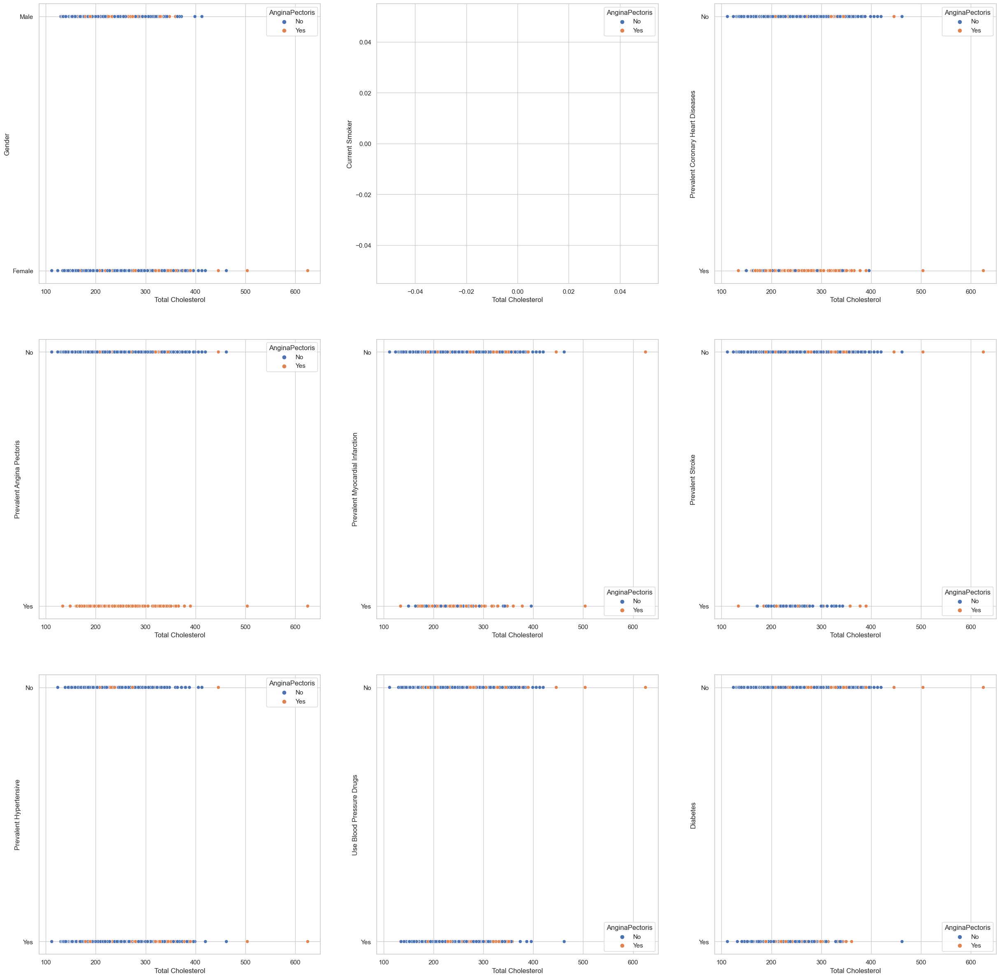

In [94]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x =Heart['TotalCholesterol'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Total Cholesterol', ylabel='Gender');

sns.scatterplot(x =Heart['TotalCholesterol'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Total Cholesterol', ylabel='Current Smoker');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Total Cholesterol', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Total Cholesterol', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Total Cholesterol', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Total Cholesterol', ylabel='Prevalent Stroke');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Total Cholesterol', ylabel='Prevalent Hypertensive');

sns.scatterplot(x =Heart['TotalCholesterol'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Total Cholesterol', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Total Cholesterol', ylabel='Diabetes');                       

**3. Box Plot**

**A. Age**

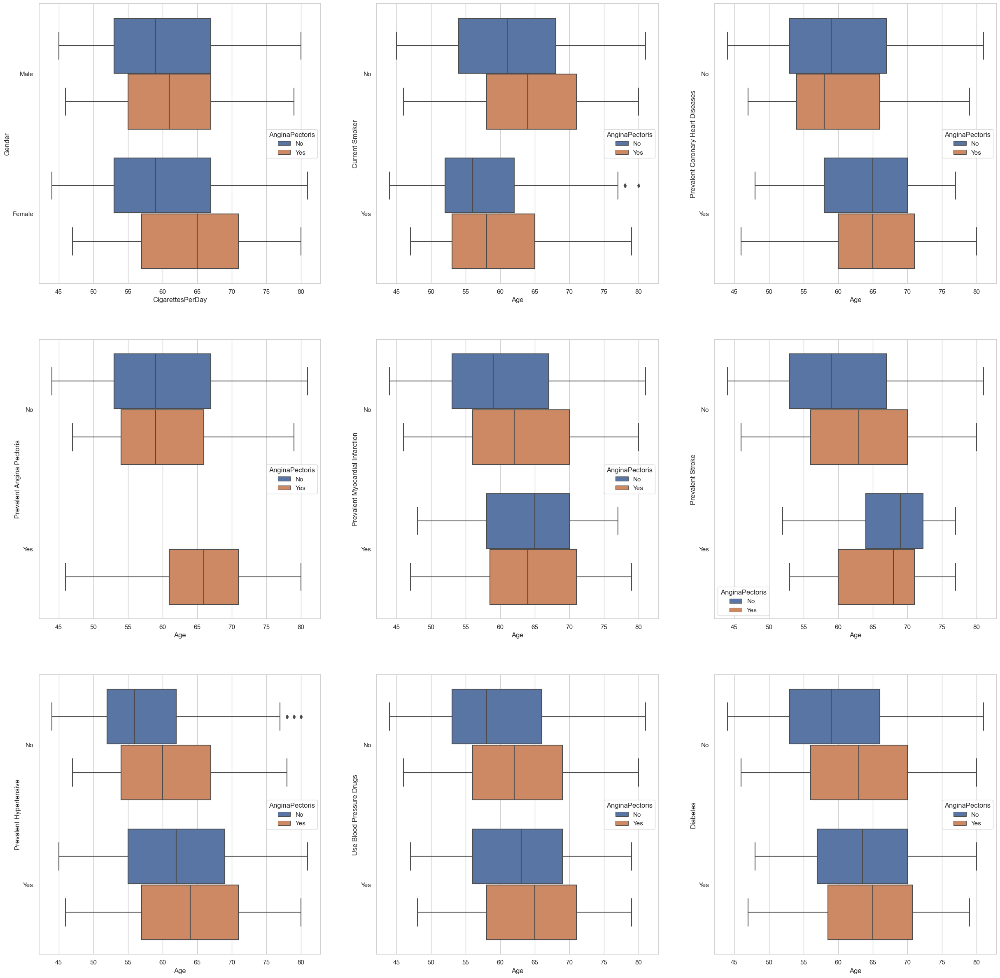

In [95]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x =Heart['Age'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='CigarettesPerDay', ylabel='Gender');

sns.boxplot(x =Heart['Age'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Age', ylabel='Current Smoker');

sns.boxplot(x =Heart['Age'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Age', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x =Heart['Age'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Age', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x =Heart['Age'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Age', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x =Heart['Age'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Age', ylabel='Prevalent Stroke');

sns.boxplot(x =Heart['Age'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Age', ylabel='Prevalent Hypertensive');

sns.boxplot(x =Heart['Age'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Age', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x =Heart['Age'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Age', ylabel='Diabetes');

**B. Cigarettes Per Day**

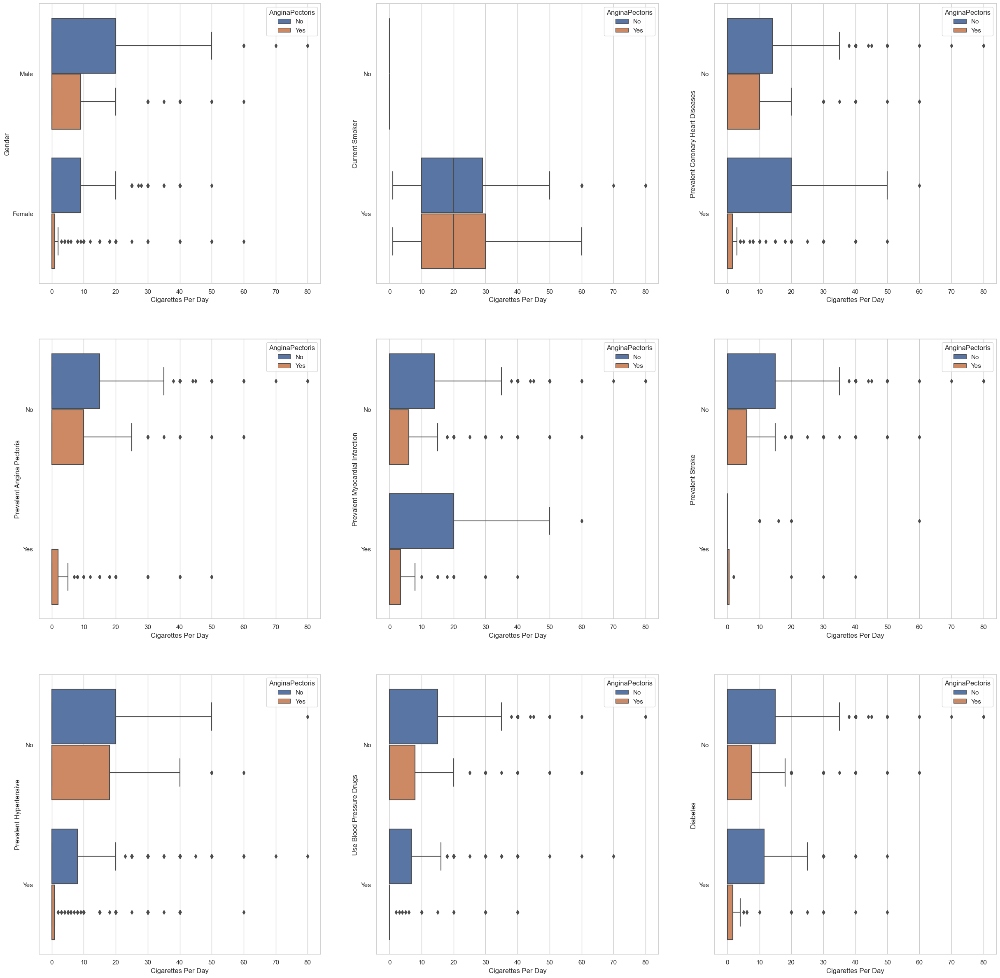

In [96]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x =Heart['CigarettesPerDay'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Cigarettes Per Day', ylabel='Gender');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Cigarettes Per Day', ylabel='Current Smoker');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Stroke');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Hypertensive');

sns.boxplot(x =Heart['CigarettesPerDay'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Cigarettes Per Day', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Cigarettes Per Day', ylabel='Diabetes');

**C. Body Mass Index**

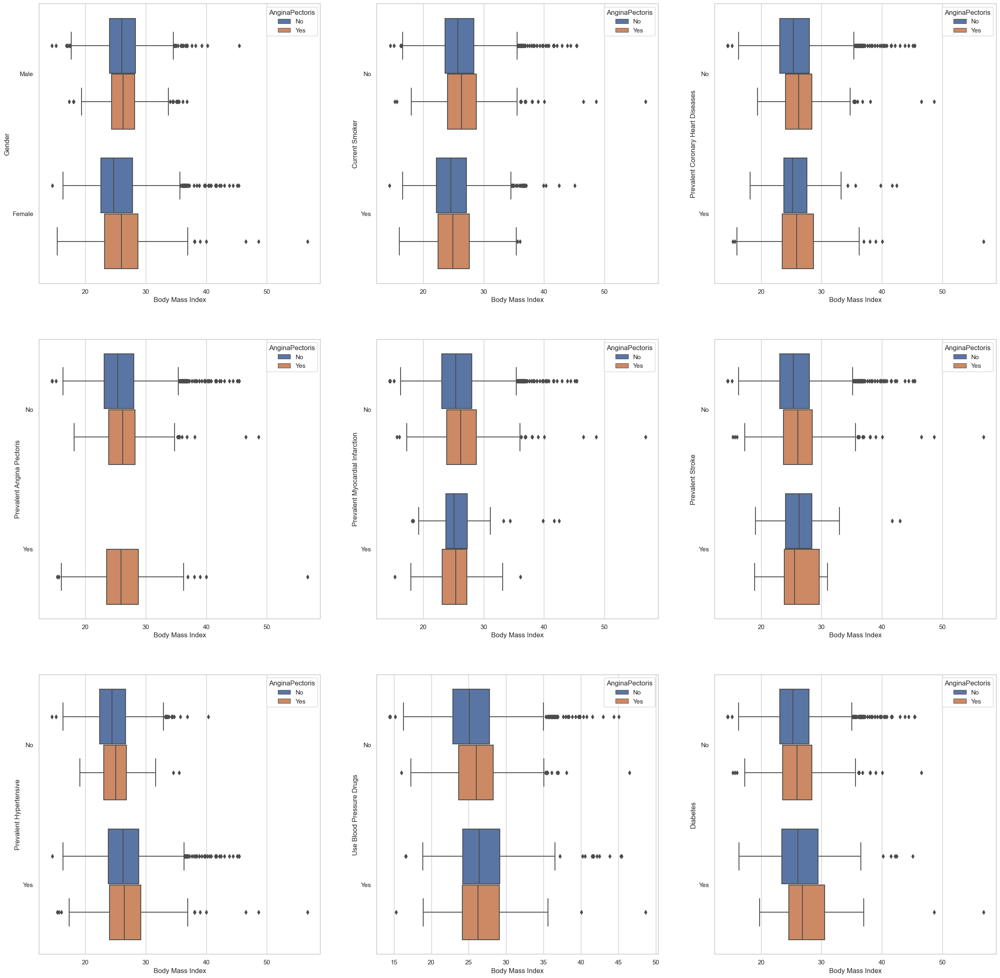

In [97]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x =Heart['BodyMassIndex'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Body Mass Index', ylabel='Gender');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Body Mass Index', ylabel='Current Smoker');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Body Mass Index', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Body Mass Index', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Body Mass Index', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Body Mass Index', ylabel='Prevalent Stroke');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Body Mass Index', ylabel='Prevalent Hypertensive');

sns.boxplot(x =Heart['BodyMassIndex'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Body Mass Index', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Body Mass Index', ylabel='Diabetes');                       

**D. Systolic Blood Pressure**

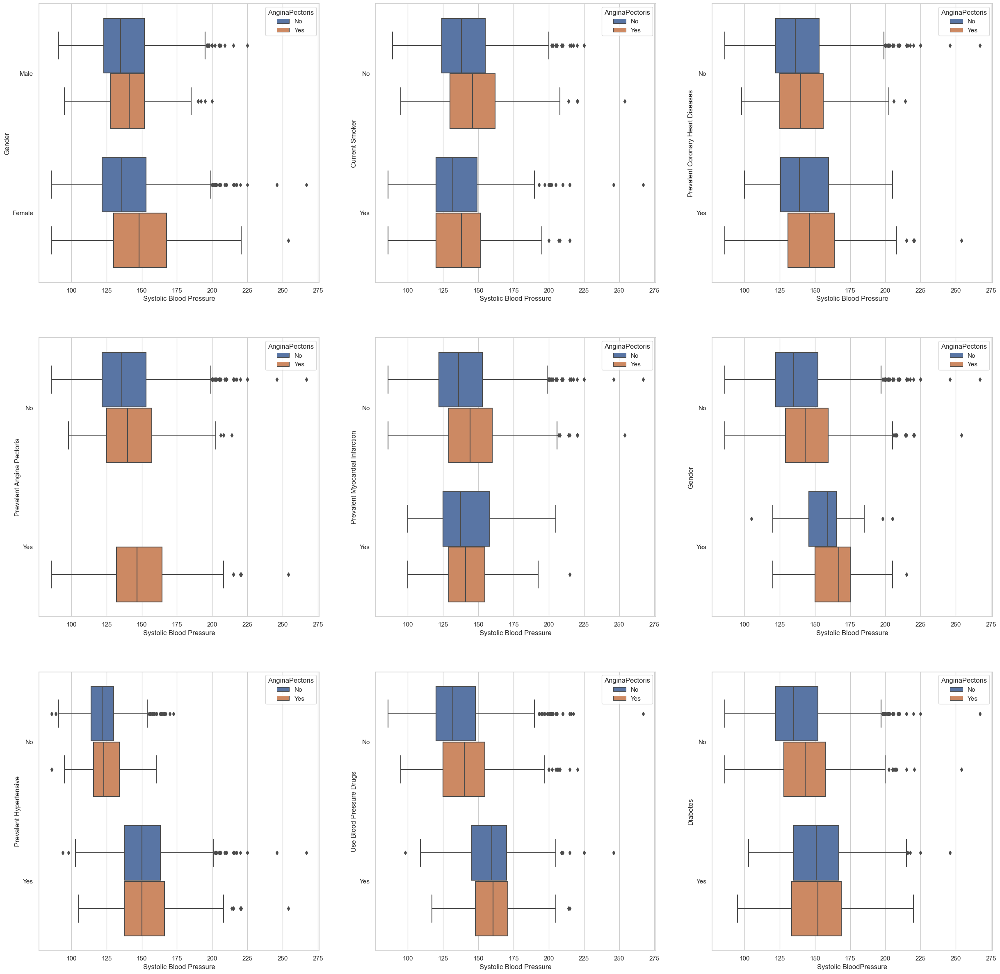

In [98]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x =Heart['SystolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Systolic Blood Pressure', ylabel='Current Smoker');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.boxplot(x =Heart['SystolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Systolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Systolic BloodPressure', ylabel='Diabetes');                       

**E. Diastolic Blood Pressure**

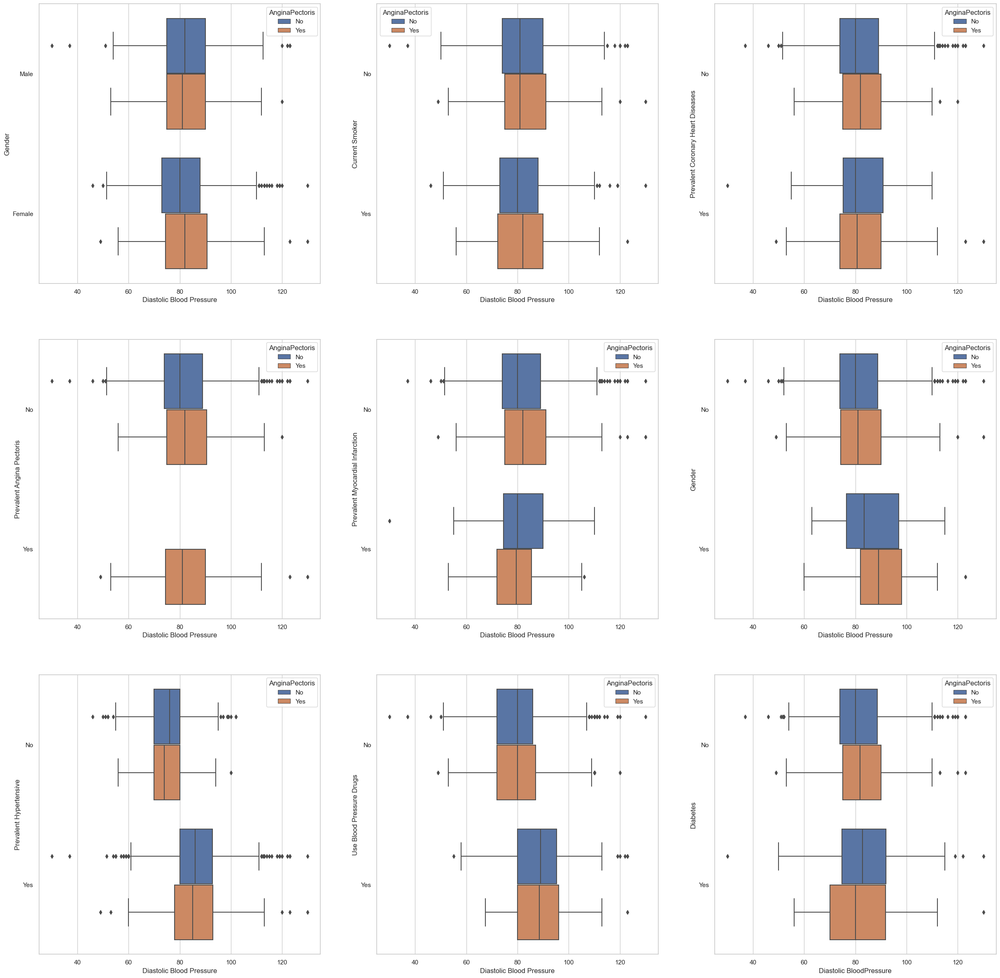

In [99]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['DiastolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Diastolic Blood Pressure', ylabel='Current Smoker');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['DiastolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Diastolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Diastolic BloodPressure', ylabel='Diabetes');                                      

**F. Heart Rate**

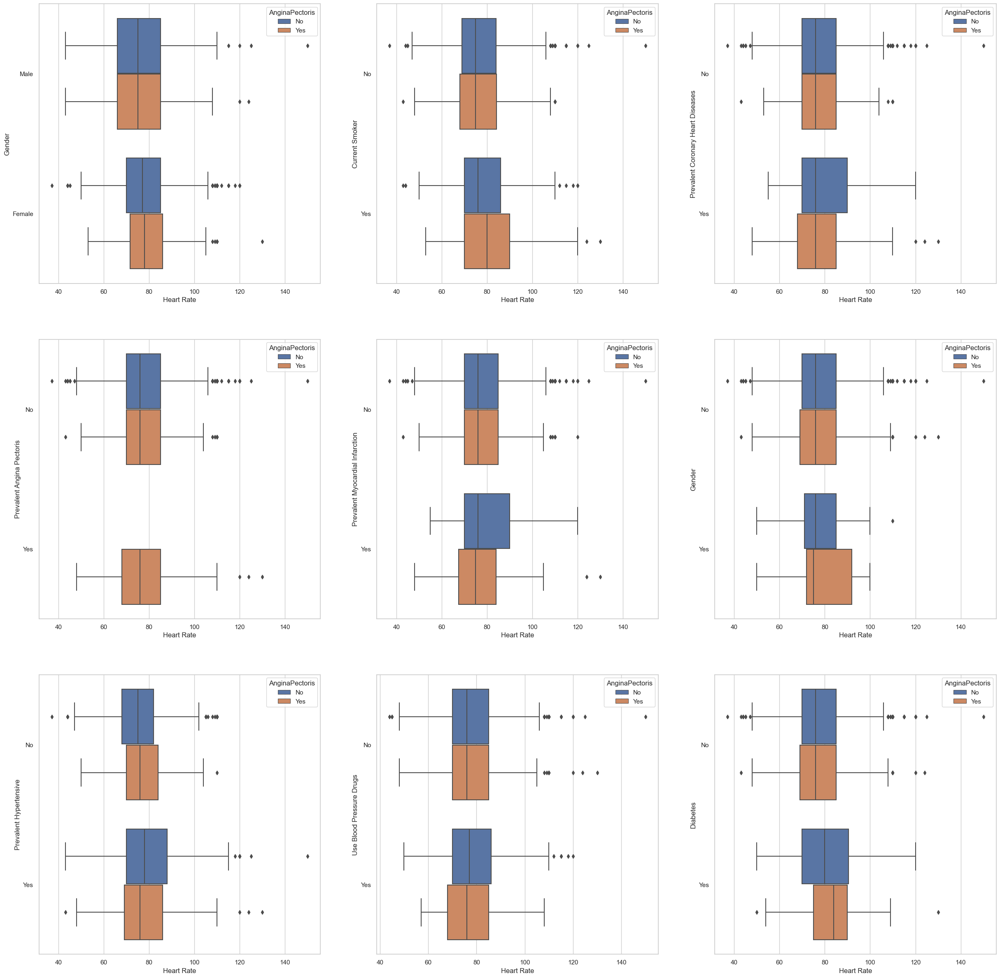

In [100]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['HeartRate'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Heart Rate', ylabel='Gender');

sns.boxplot(x = Heart['HeartRate'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Heart Rate', ylabel='Current Smoker');

sns.boxplot(x = Heart['HeartRate'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Heart Rate', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['HeartRate'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Heart Rate', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['HeartRate'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Heart Rate', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['HeartRate'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Heart Rate', ylabel='Gender');

sns.boxplot(x = Heart['HeartRate'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Heart Rate', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['HeartRate'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Heart Rate', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['HeartRate'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Heart Rate', ylabel='Diabetes');                                          

**G. Glucose**

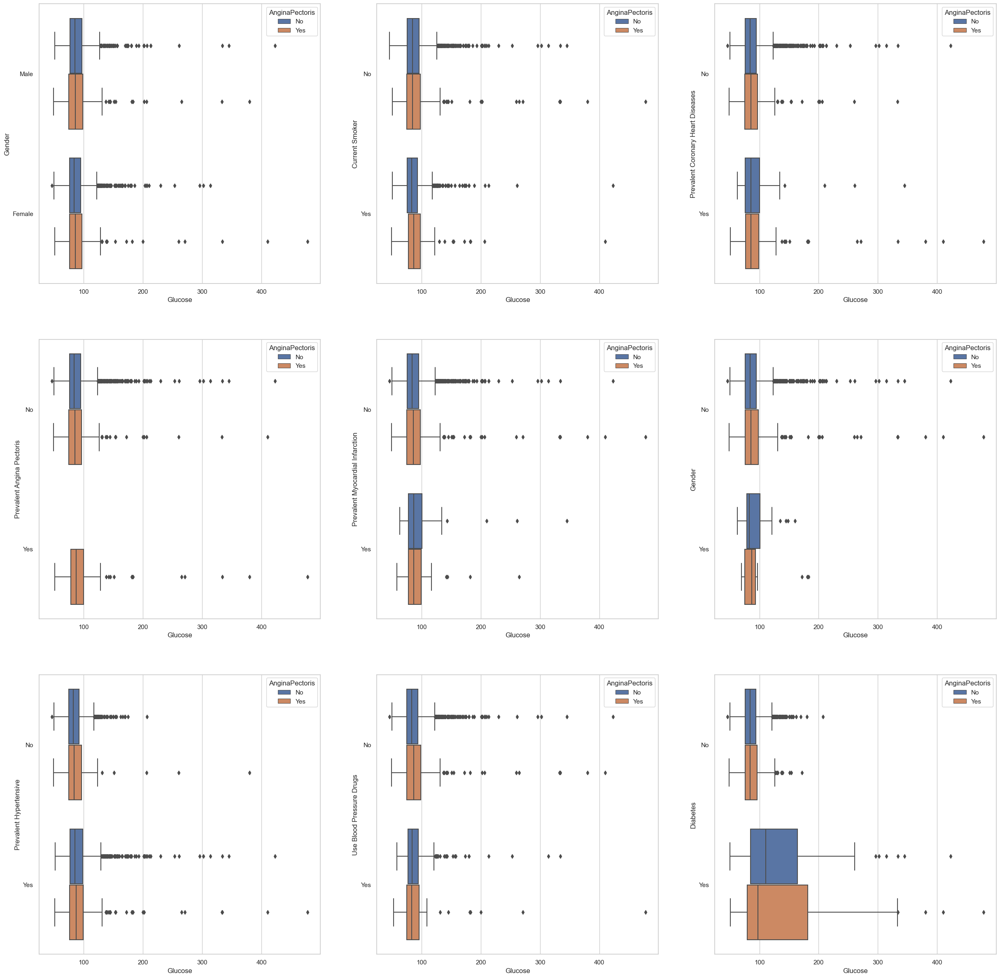

In [101]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['Glucose'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Glucose', ylabel='Gender');

sns.boxplot(x = Heart['Glucose'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Glucose', ylabel='Current Smoker');

sns.boxplot(x = Heart['Glucose'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Glucose', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['Glucose'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Glucose', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['Glucose'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Glucose', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['Glucose'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Glucose', ylabel='Gender');

sns.boxplot(x = Heart['Glucose'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Glucose', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['Glucose'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Glucose', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['Glucose'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Glucose', ylabel='Diabetes');

**H. High Density Lipoprotein**

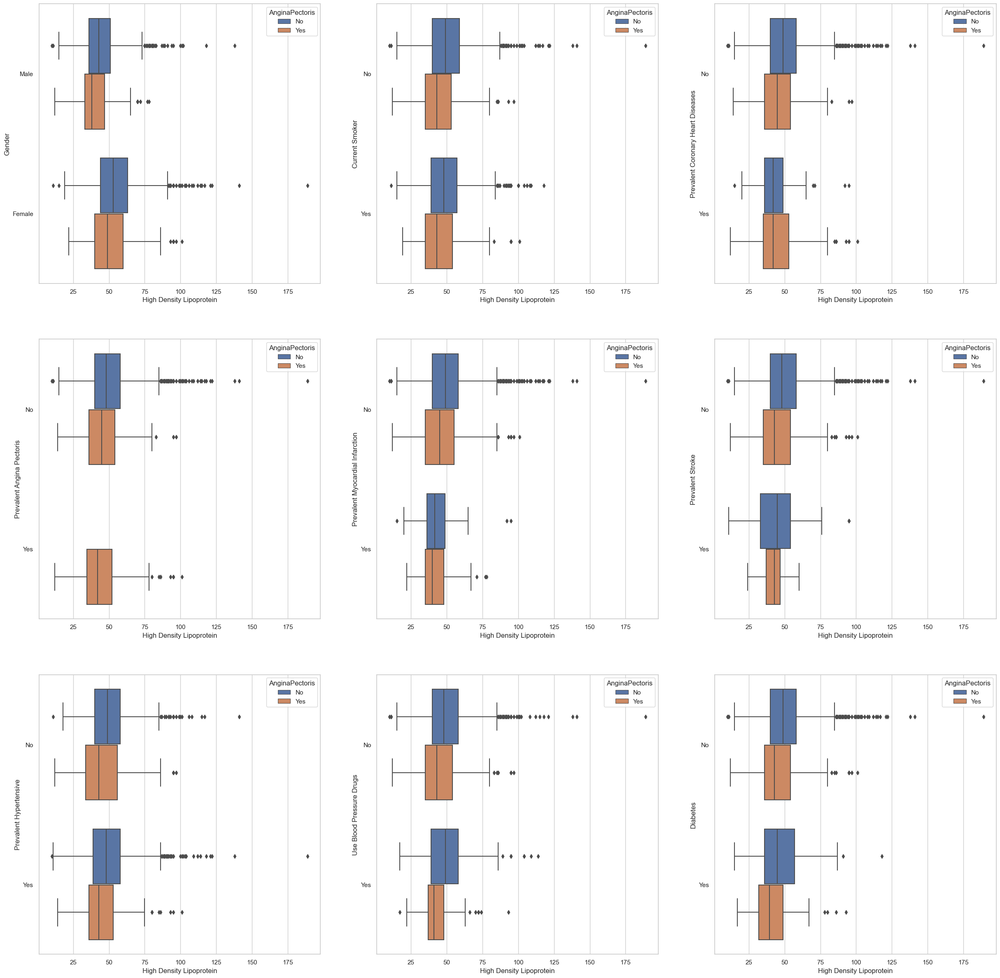

In [102]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['HighDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='High Density Lipoprotein', ylabel='Gender');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='High Density Lipoprotein', ylabel='Current Smoker');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Stroke');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['HighDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='High Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='High Density Lipoprotein', ylabel='Diabetes');

**J. Low Density Lipoprotein**

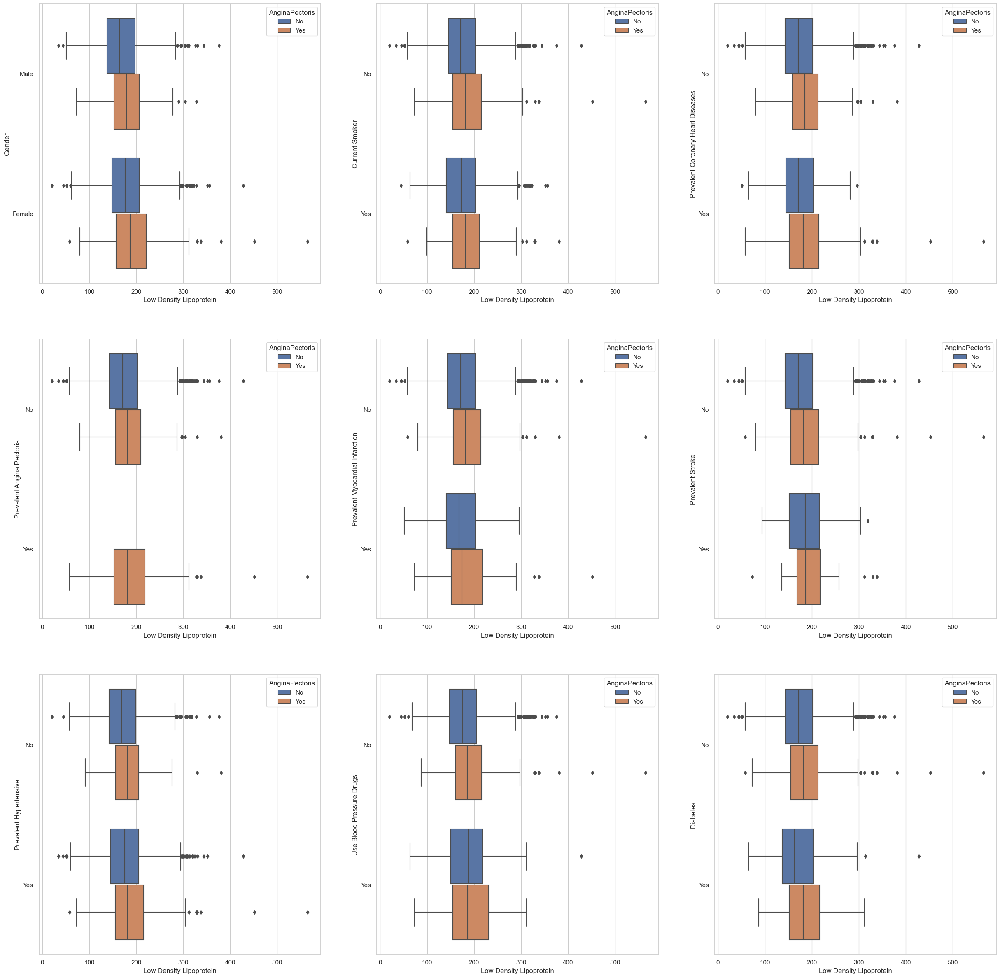

In [103]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['LowDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Low Density Lipoprotein', ylabel='Gender');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Low Density Lipoprotein', ylabel='Current Smoker');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Stroke');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['LowDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Low Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Low Density Lipoprotein', ylabel='Diabetes');

**K. Total Cholesterol**

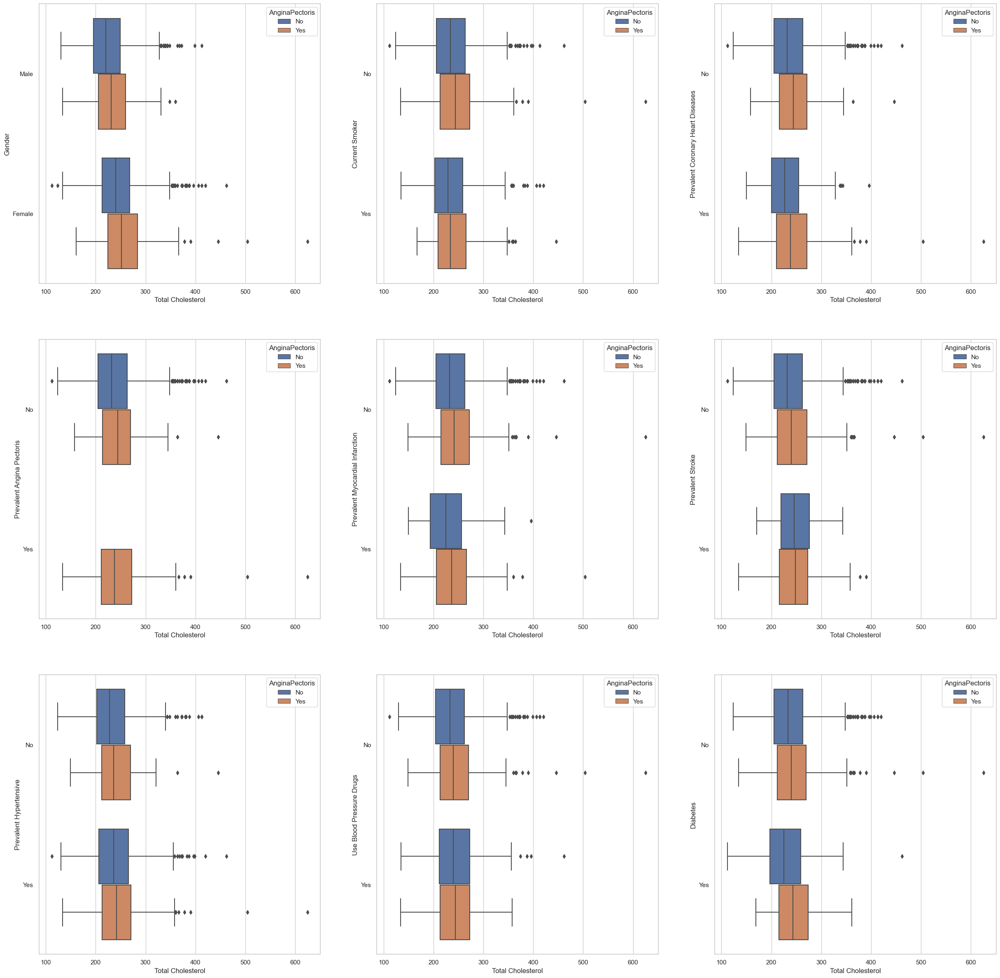

In [104]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['TotalCholesterol'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Total Cholesterol', ylabel='Gender');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Total Cholesterol', ylabel='Current Smoker');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Total Cholesterol', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Total Cholesterol', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Total Cholesterol', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Total Cholesterol', ylabel='Prevalent Stroke');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Total Cholesterol', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['TotalCholesterol'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Total Cholesterol', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Total Cholesterol', ylabel='Diabetes');                  

**4. Bar Plot**

**A. Age**

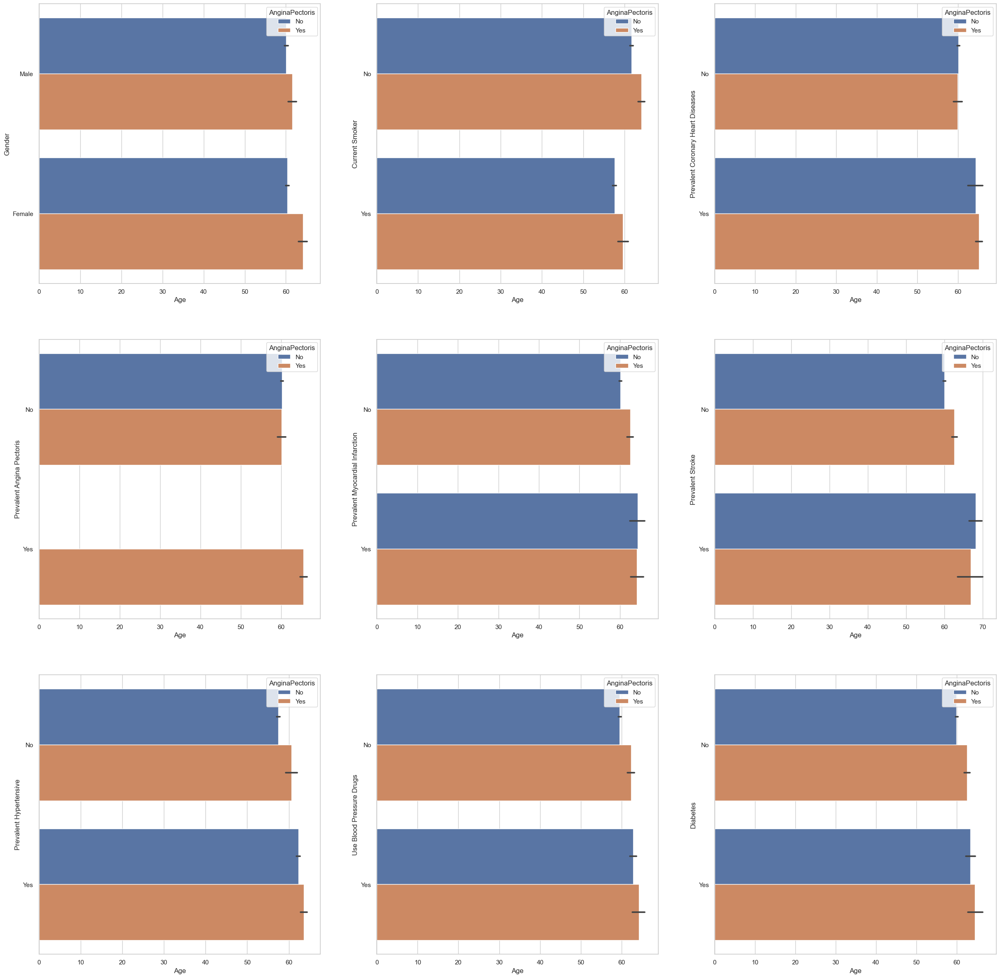

In [105]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['Age'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Age', ylabel='Gender');

sns.barplot(x = Heart['Age'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Age', ylabel='Current Smoker');

sns.barplot(x = Heart['Age'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Age', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['Age'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Age', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['Age'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Age', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['Age'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Age', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['Age'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Age', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['Age'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Age', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['Age'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Age', ylabel='Diabetes');

**B. Cigarettes Per Day**

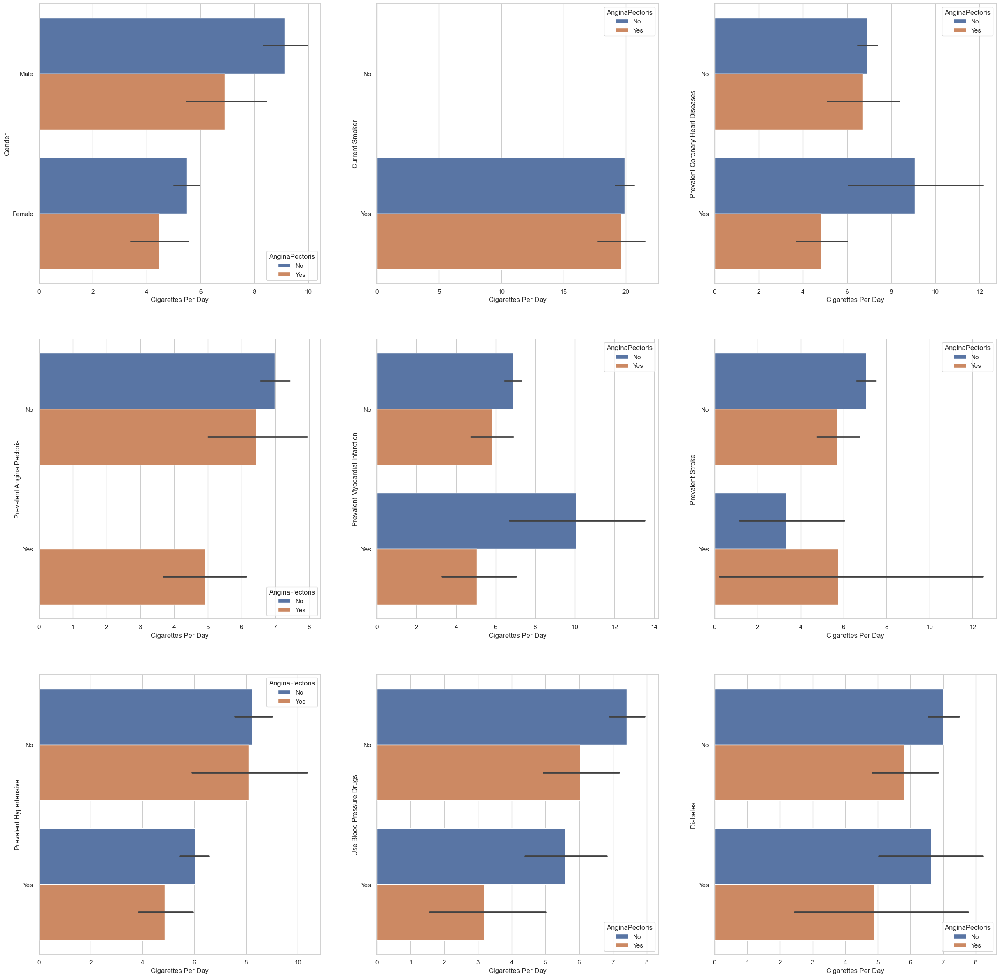

In [106]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['CigarettesPerDay'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Cigarettes Per Day', ylabel='Gender');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Cigarettes Per Day', ylabel='Current Smoker');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['CigarettesPerDay'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Cigarettes Per Day', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Cigarettes Per Day', ylabel='Diabetes');

**C. Body Mass Index**

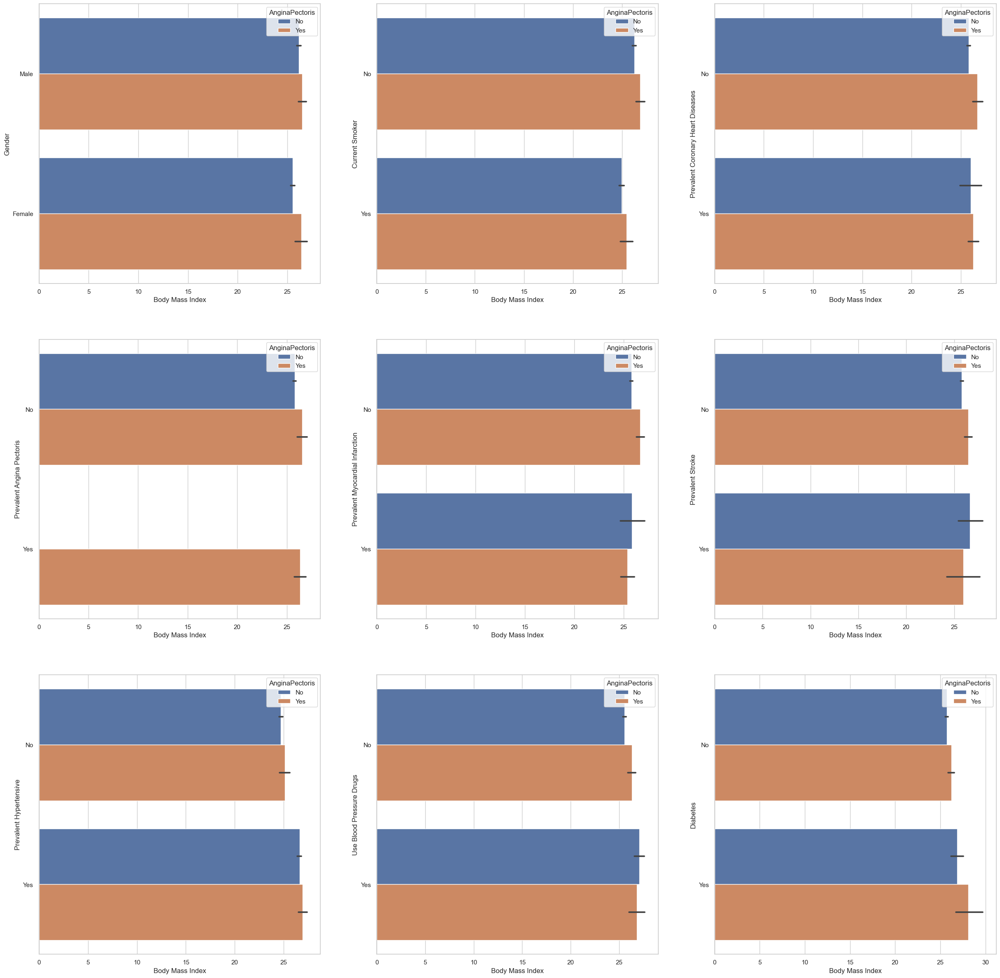

In [107]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['BodyMassIndex'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Body Mass Index', ylabel='Gender');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Body Mass Index', ylabel='Current Smoker');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Body Mass Index', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Body Mass Index', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Body Mass Index', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Body Mass Index', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Body Mass Index', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['BodyMassIndex'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Body Mass Index', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Body Mass Index', ylabel='Diabetes');                    

**D. Systolic Blood Pressure**

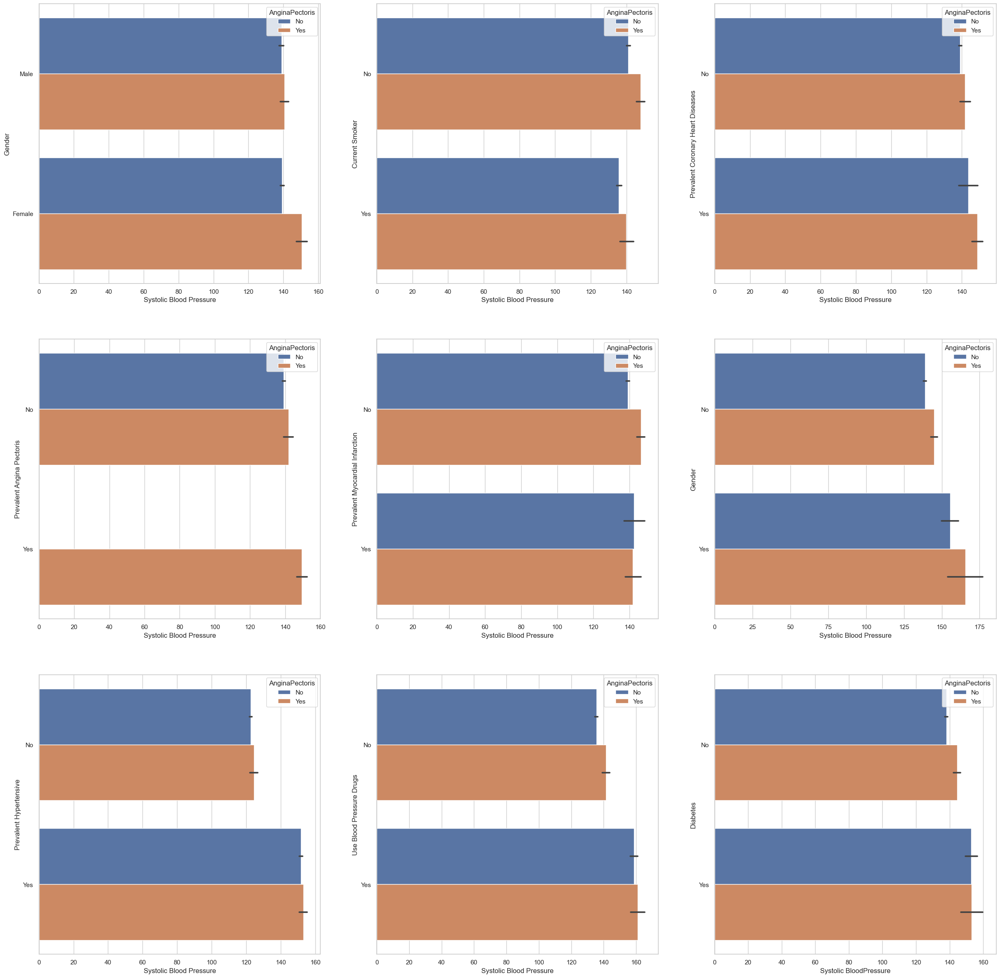

In [108]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x =Heart['SystolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Systolic Blood Pressure', ylabel='Current Smoker');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.barplot(x =Heart['SystolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Systolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Systolic BloodPressure', ylabel='Diabetes');                      

**E. Diastolic Blood Pressure**

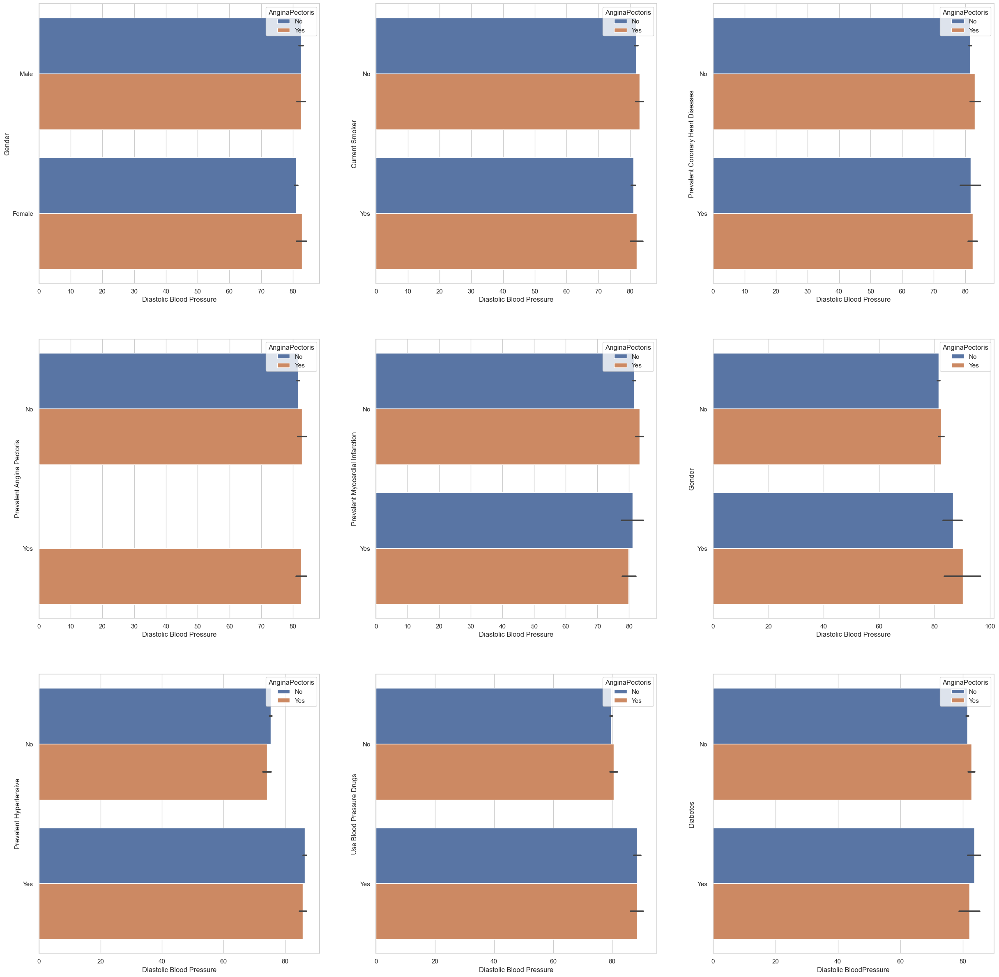

In [109]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['DiastolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Diastolic Blood Pressure', ylabel='Current Smoker');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['DiastolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Diastolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Diastolic BloodPressure', ylabel='Diabetes');                                          

**F. Heart Rate**

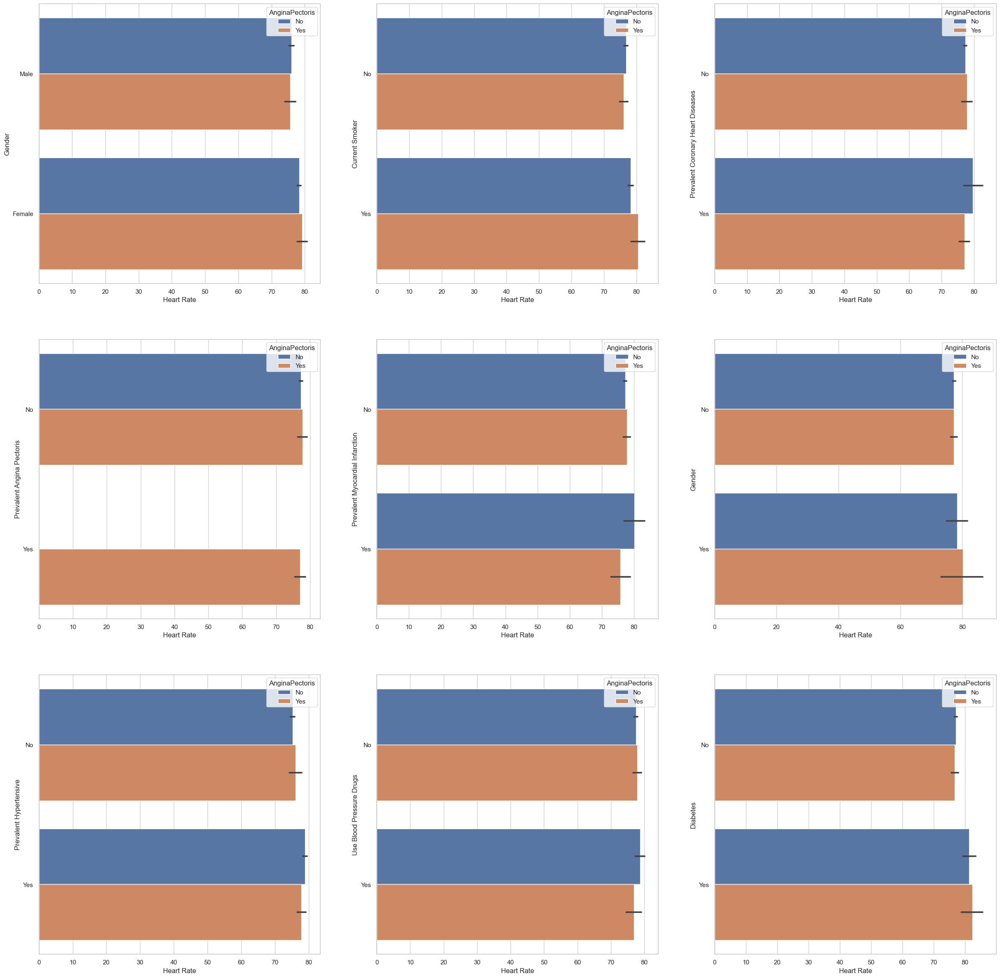

In [110]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['HeartRate'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Heart Rate', ylabel='Gender');

sns.barplot(x = Heart['HeartRate'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Heart Rate', ylabel='Current Smoker');

sns.barplot(x = Heart['HeartRate'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Heart Rate', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['HeartRate'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Heart Rate', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['HeartRate'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Heart Rate', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['HeartRate'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Heart Rate', ylabel='Gender');

sns.barplot(x = Heart['HeartRate'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Heart Rate', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['HeartRate'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Heart Rate', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['HeartRate'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Heart Rate', ylabel='Diabetes');                                          

**G. Glucose**

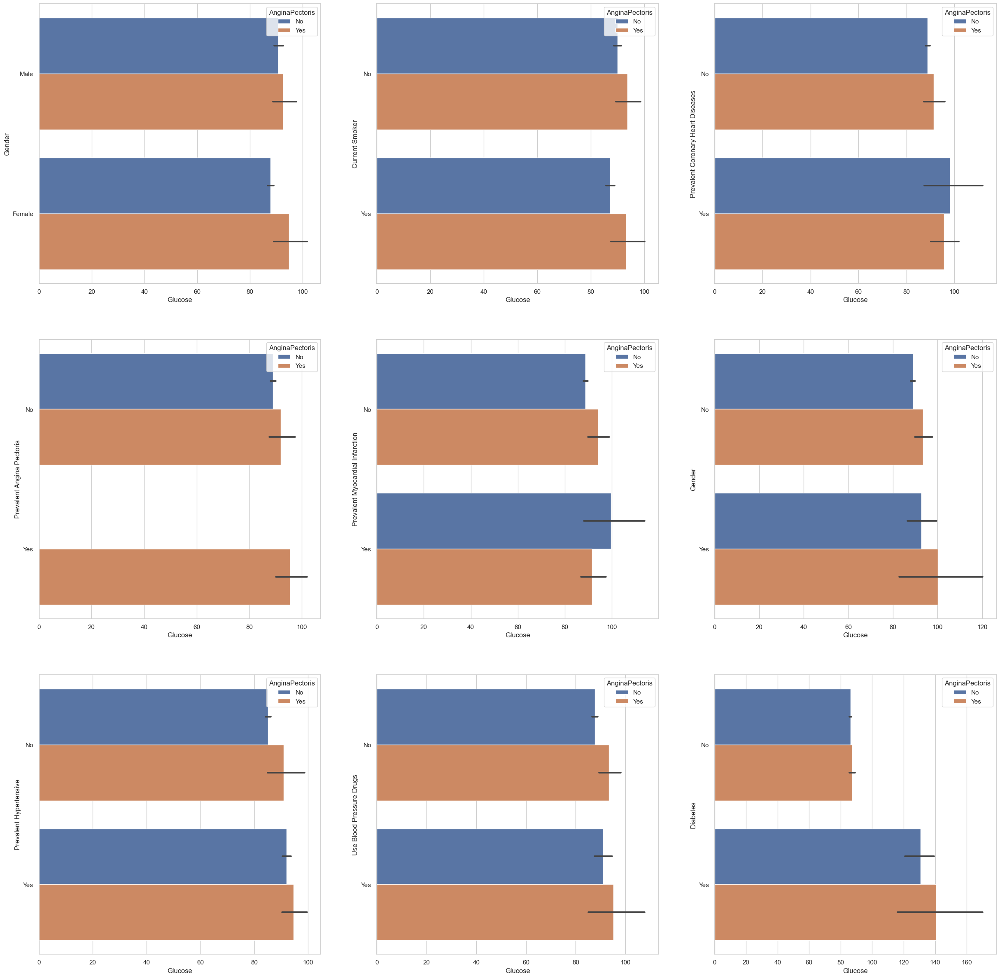

In [111]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['Glucose'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Glucose', ylabel='Gender');

sns.barplot(x = Heart['Glucose'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Glucose', ylabel='Current Smoker');

sns.barplot(x = Heart['Glucose'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Glucose', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['Glucose'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Glucose', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['Glucose'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Glucose', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['Glucose'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Glucose', ylabel='Gender');

sns.barplot(x = Heart['Glucose'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Glucose', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['Glucose'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Glucose', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['Glucose'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Glucose', ylabel='Diabetes');  

**H. High Density Lipoprotein**

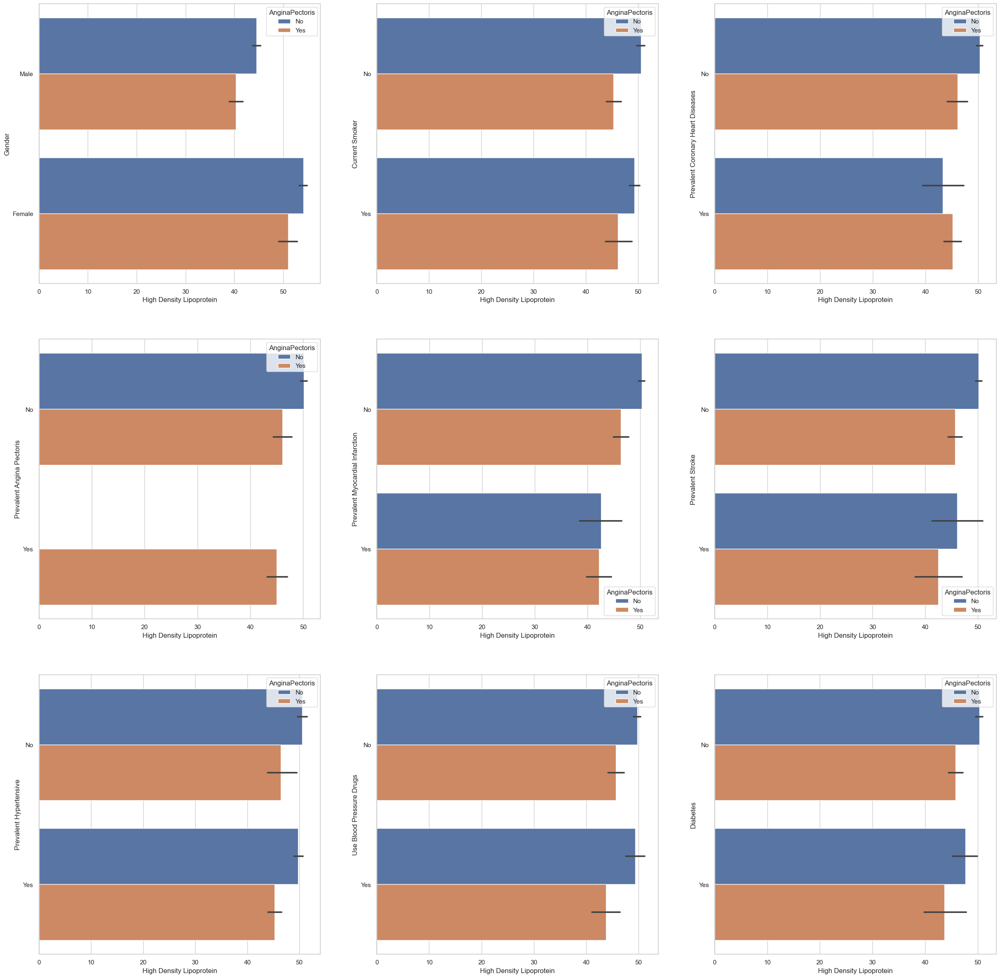

In [112]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['HighDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='High Density Lipoprotein', ylabel='Gender');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='High Density Lipoprotein', ylabel='Current Smoker');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['HighDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='High Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='High Density Lipoprotein', ylabel='Diabetes');  

**J. Low Density Lipoprotein**

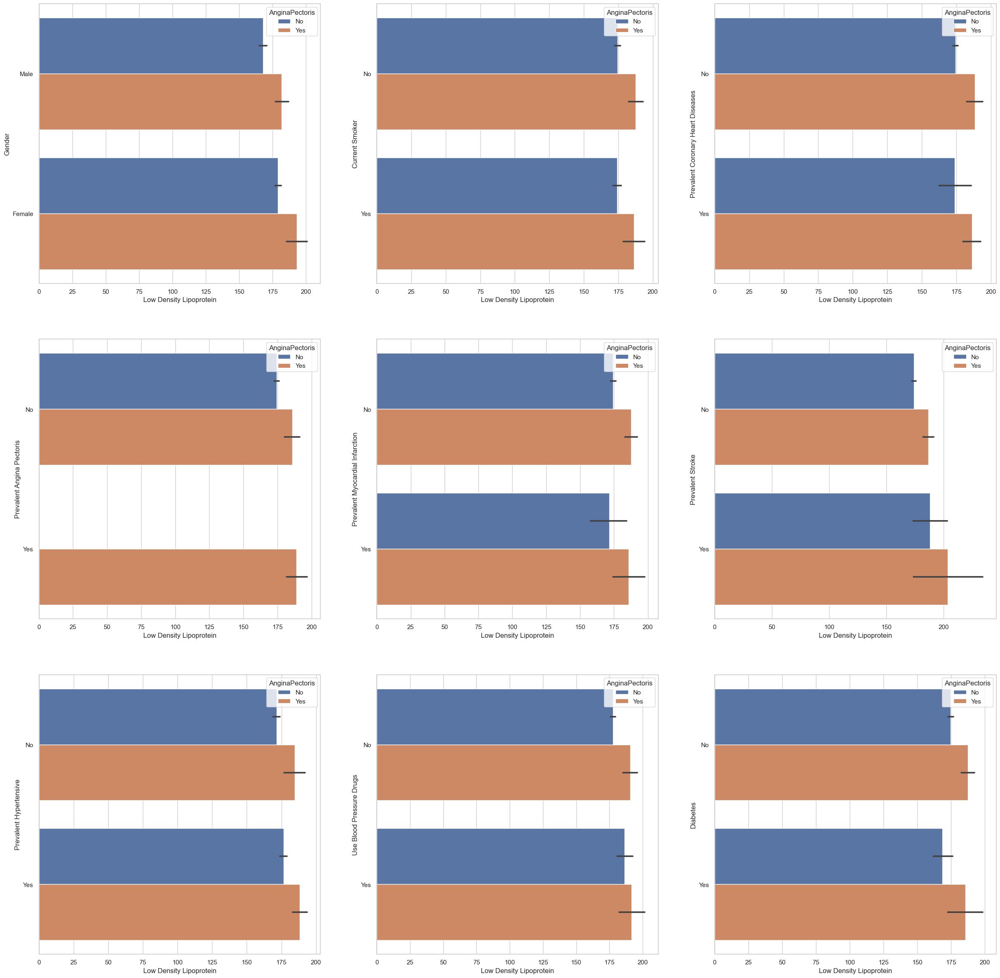

In [113]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['LowDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Low Density Lipoprotein', ylabel='Gender');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Low Density Lipoprotein', ylabel='Current Smoker');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['LowDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Low Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Low Density Lipoprotein', ylabel='Diabetes');  

**K. Total Cholesterol**

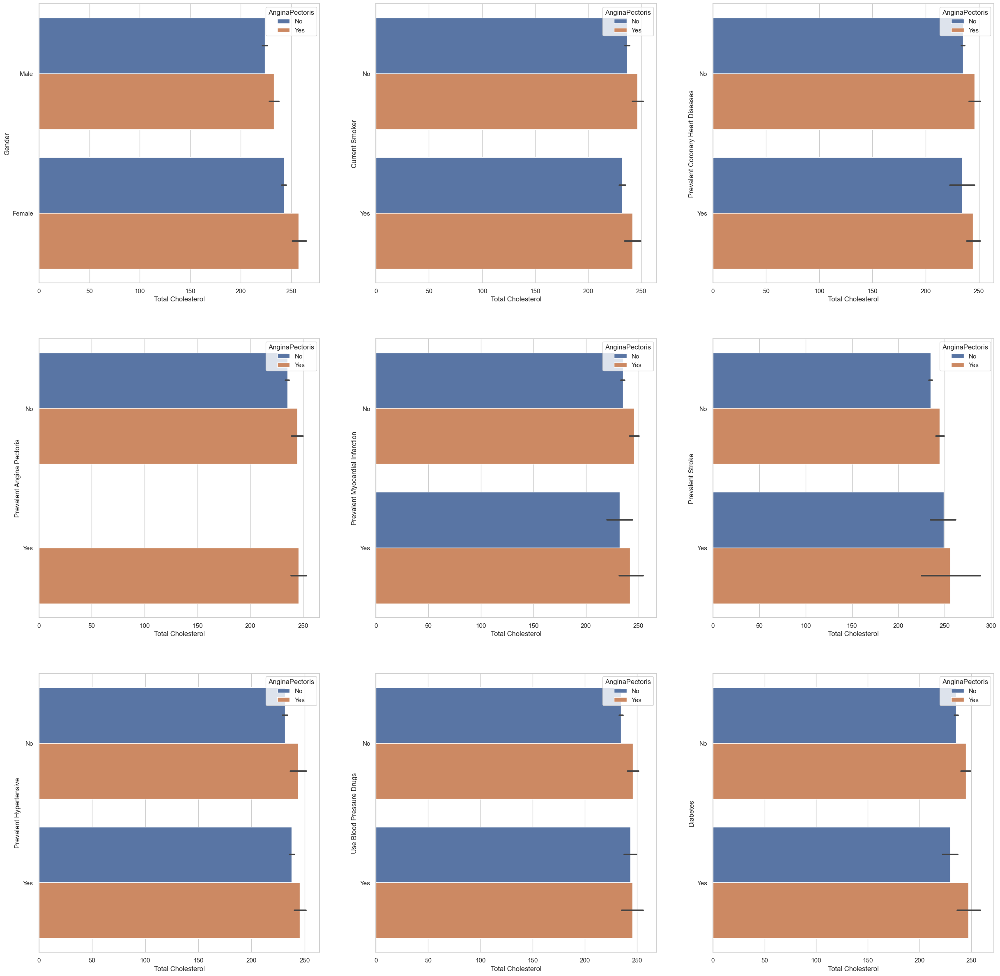

In [114]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['TotalCholesterol'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Total Cholesterol', ylabel='Gender');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Total Cholesterol', ylabel='Current Smoker');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Total Cholesterol', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Total Cholesterol', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Total Cholesterol', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Total Cholesterol', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Total Cholesterol', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['TotalCholesterol'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Total Cholesterol', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Total Cholesterol', ylabel='Diabetes');                      

**5. Strip Plot**

**A. Age**

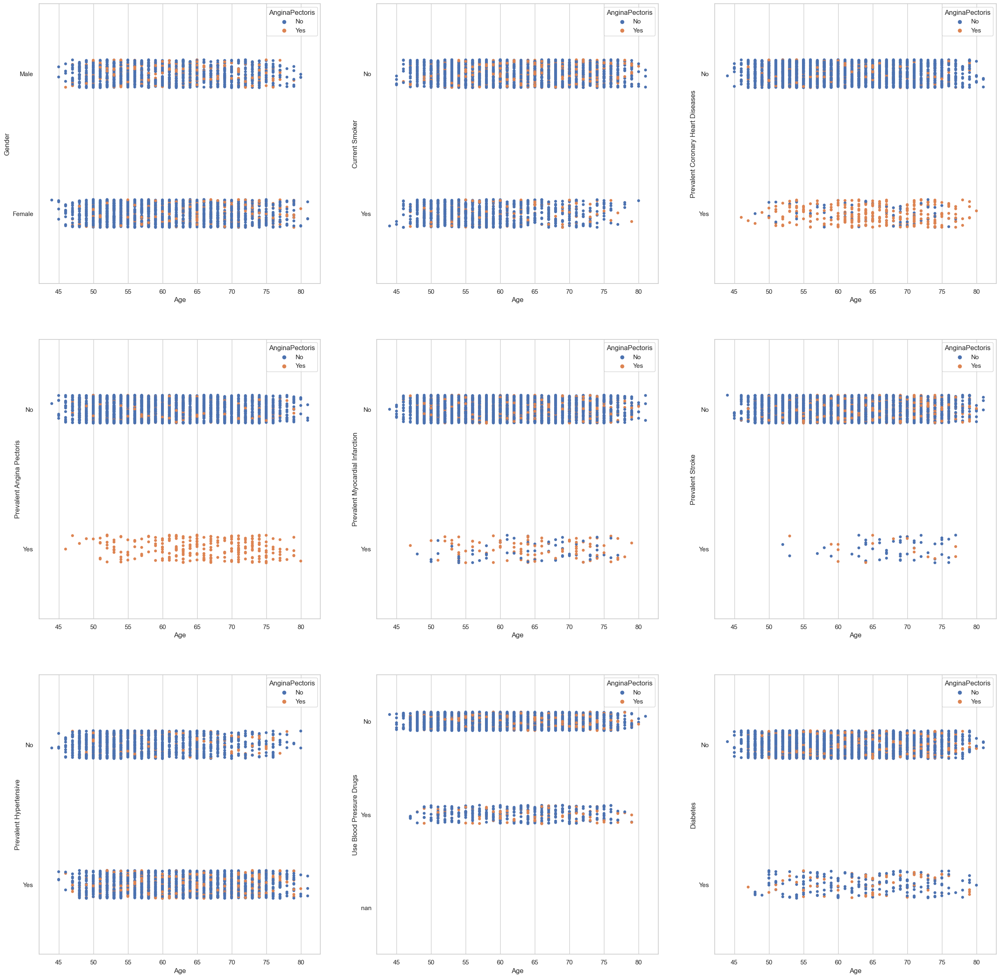

In [115]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['Age'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Age', ylabel='Gender');

sns.stripplot(x = Heart['Age'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Age', ylabel='Current Smoker');

sns.stripplot(x = Heart['Age'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Age', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['Age'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Age', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['Age'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Age', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['Age'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Age', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['Age'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Age', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['Age'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Age', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['Age'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Age', ylabel='Diabetes');

**B. Cigarettes Per Day**

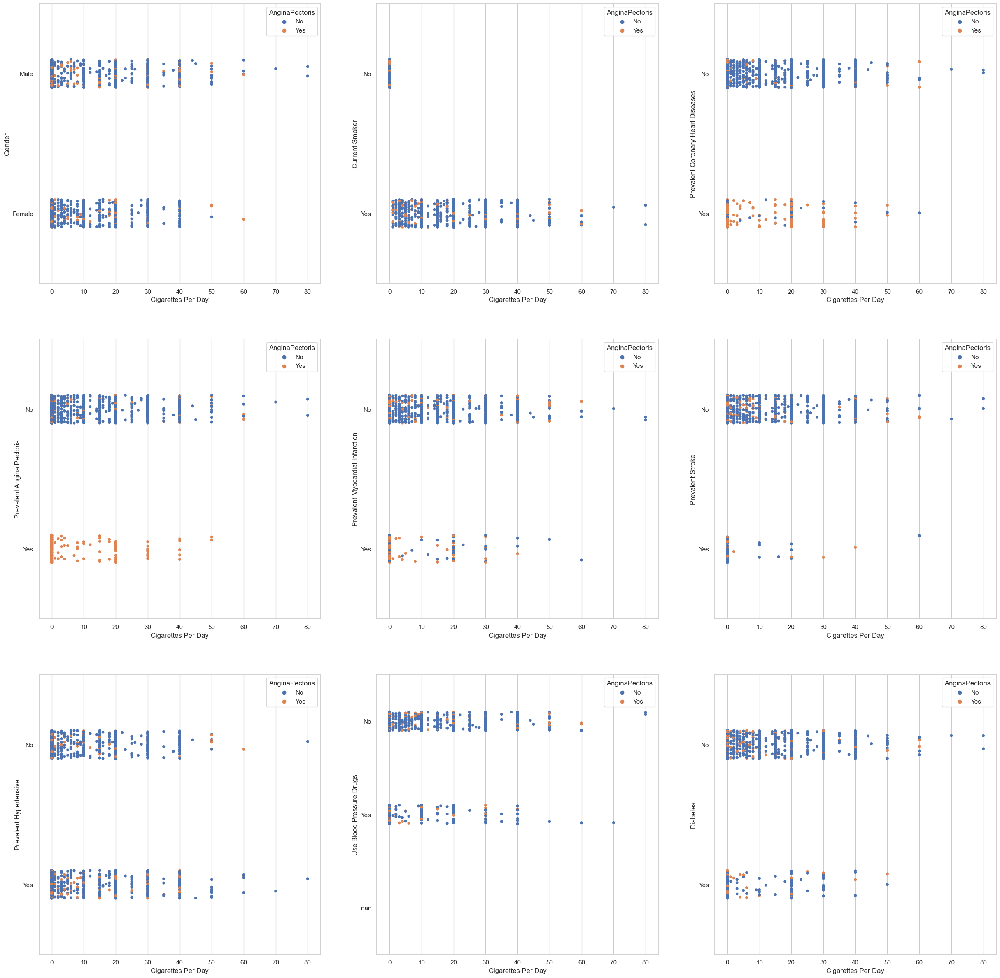

In [116]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['CigarettesPerDay'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Cigarettes Per Day', ylabel='Gender');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Cigarettes Per Day', ylabel='Current Smoker');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['CigarettesPerDay'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Cigarettes Per Day', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['CigarettesPerDay'],  y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Cigarettes Per Day', ylabel='Diabetes');

**C. Body Mass Index**

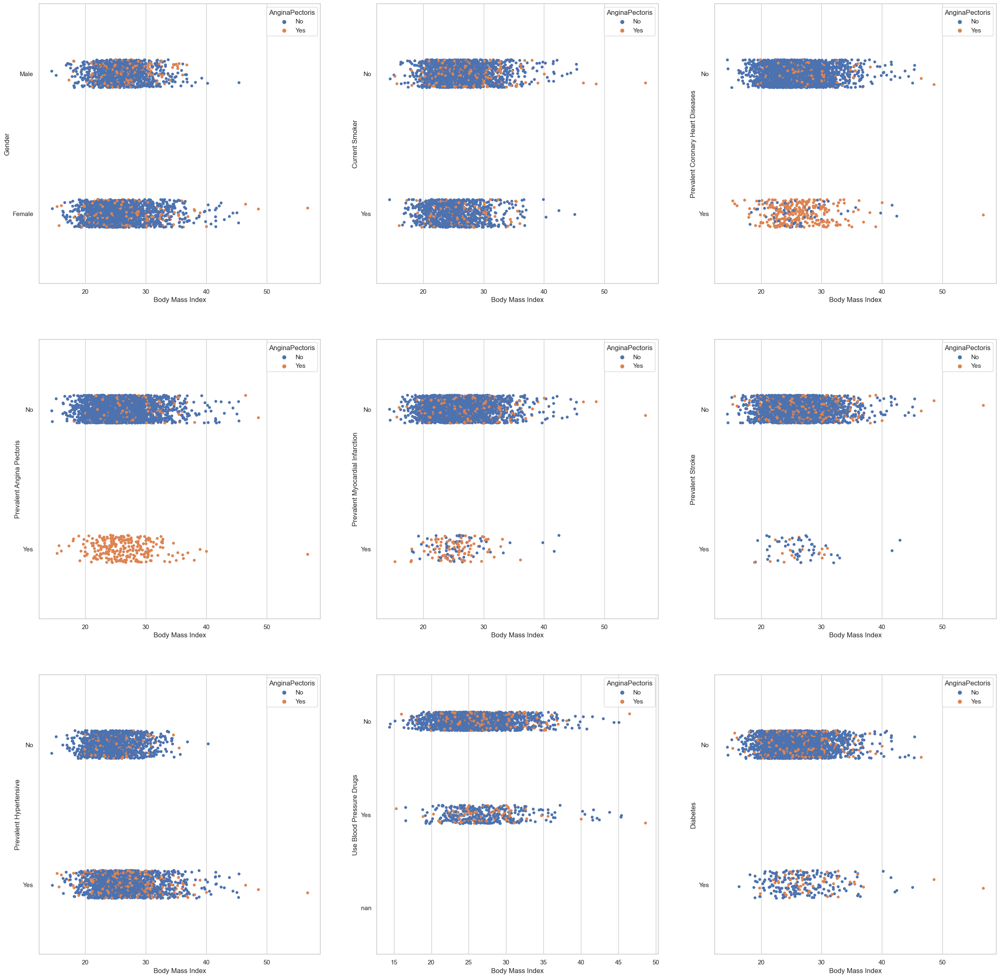

In [117]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Body Mass Index', ylabel='Gender');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Body Mass Index', ylabel='Current Smoker');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Body Mass Index', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Body Mass Index', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Body Mass Index', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Body Mass Index', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Body Mass Index', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['BodyMassIndex'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Body Mass Index', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Body Mass Index', ylabel='Diabetes');                    

**D. Systolic Blood Pressure**

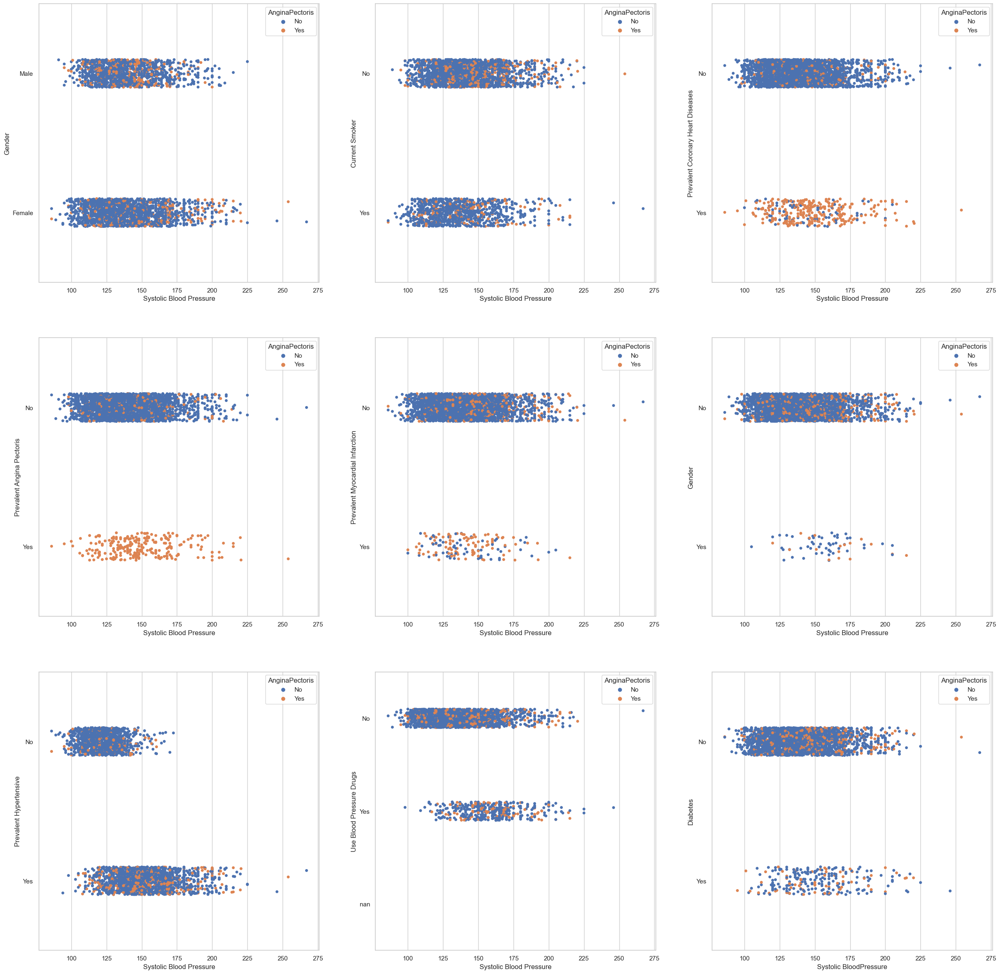

In [118]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['SystolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Systolic Blood Pressure', ylabel='Current Smoker');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['SystolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Systolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Systolic BloodPressure', ylabel='Diabetes');                       

**E. Diastolic Blood Pressure**

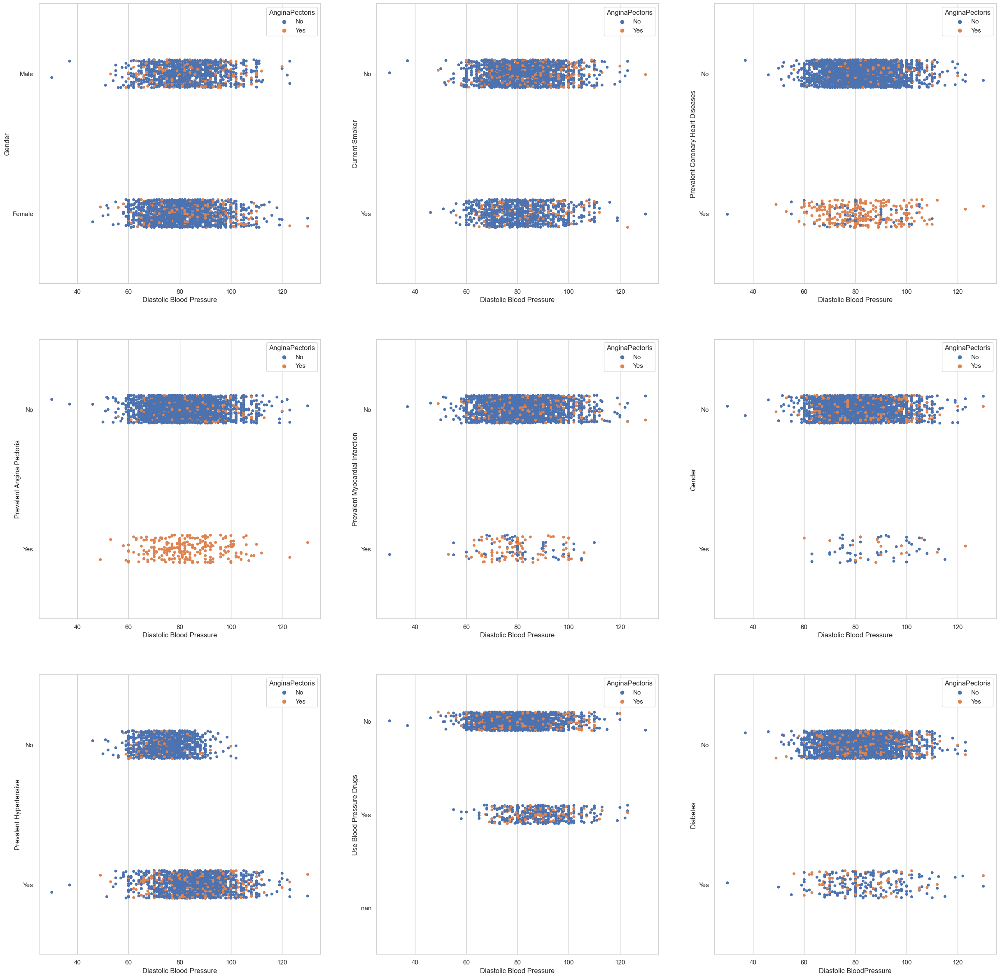

In [119]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['DiastolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Diastolic Blood Pressure', ylabel='Current Smoker');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['DiastolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Diastolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Diastolic BloodPressure', ylabel='Diabetes');                                          

**F. Heart Rate**

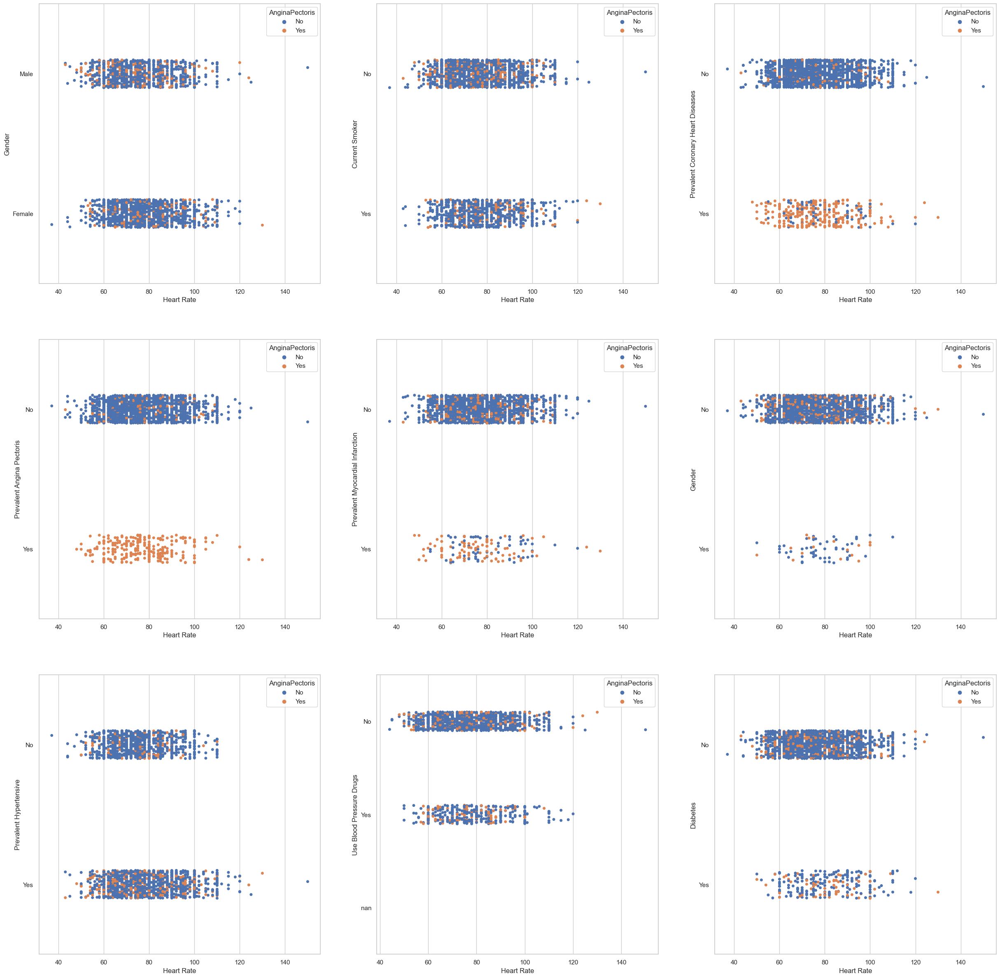

In [120]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['HeartRate'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Heart Rate', ylabel='Gender');

sns.stripplot(x = Heart['HeartRate'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Heart Rate', ylabel='Current Smoker');

sns.stripplot(x = Heart['HeartRate'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Heart Rate', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['HeartRate'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Heart Rate', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['HeartRate'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Heart Rate', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['HeartRate'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Heart Rate', ylabel='Gender');

sns.stripplot(x = Heart['HeartRate'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Heart Rate', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['HeartRate'], y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Heart Rate', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['HeartRate'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Heart Rate', ylabel='Diabetes');                                          

**G. Glucose**

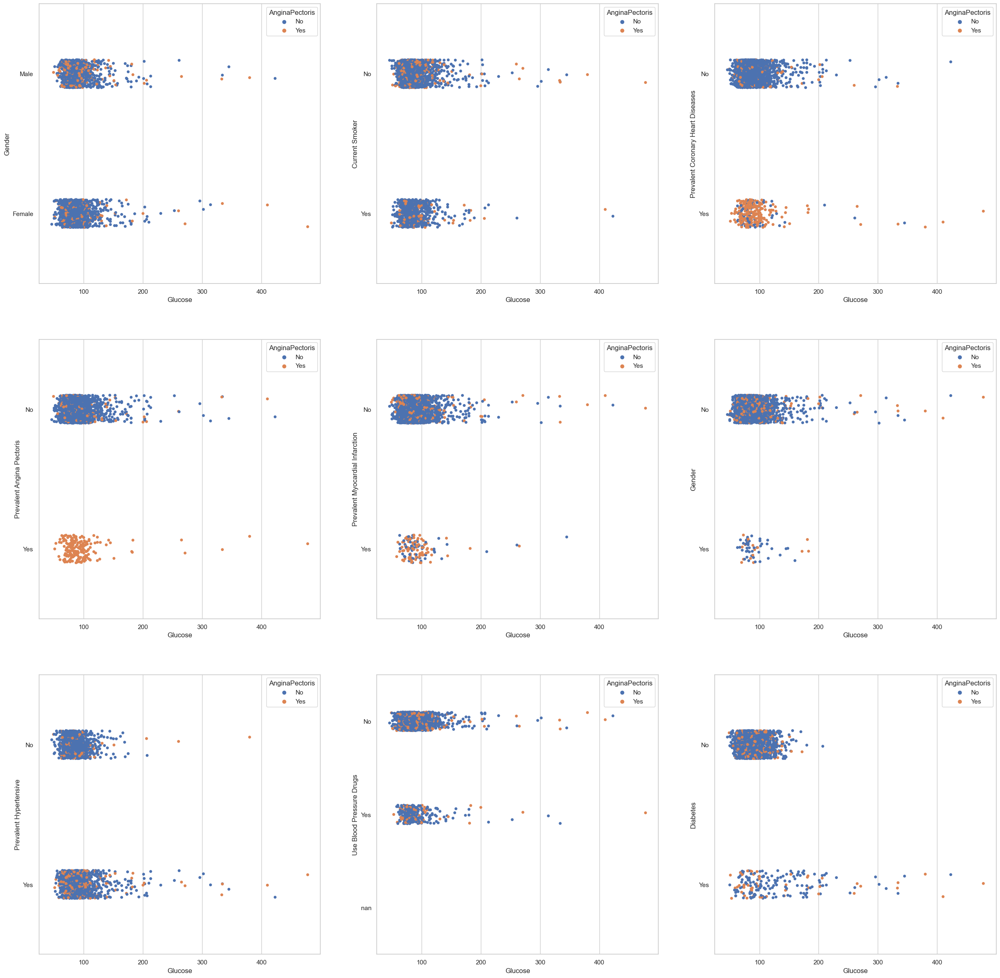

In [121]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['Glucose'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Glucose', ylabel='Gender');

sns.stripplot(x = Heart['Glucose'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Glucose', ylabel='Current Smoker');

sns.stripplot(x = Heart['Glucose'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Glucose', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['Glucose'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Glucose', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['Glucose'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Glucose', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['Glucose'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Glucose', ylabel='Gender');

sns.stripplot(x = Heart['Glucose'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Glucose', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['Glucose'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Glucose', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['Glucose'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Glucose', ylabel='Diabetes');

**H. High Density Lipoprotein**

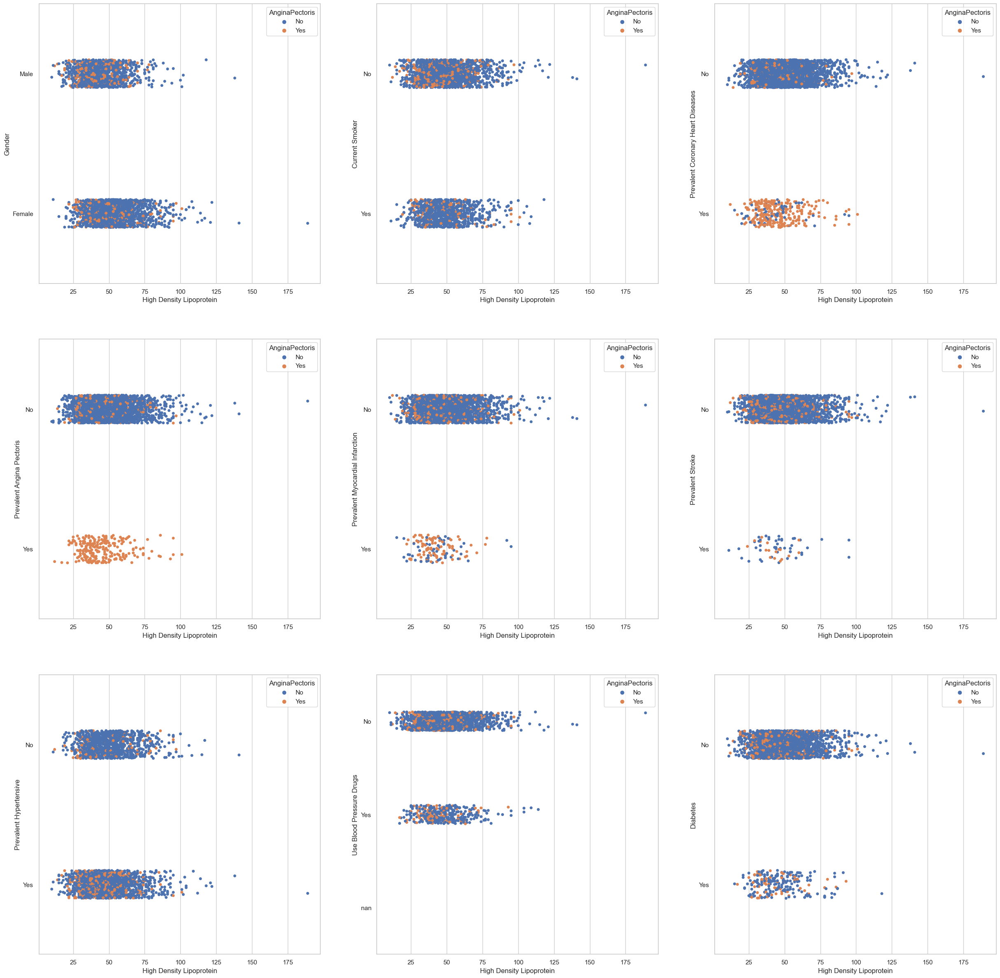

In [122]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['HighDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='High Density Lipoprotein', ylabel='Gender');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='High Density Lipoprotein', ylabel='Current Smoker');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['HighDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='High Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='High Density Lipoprotein', ylabel='Diabetes'); 

**H. Low Density Lipoprotein**

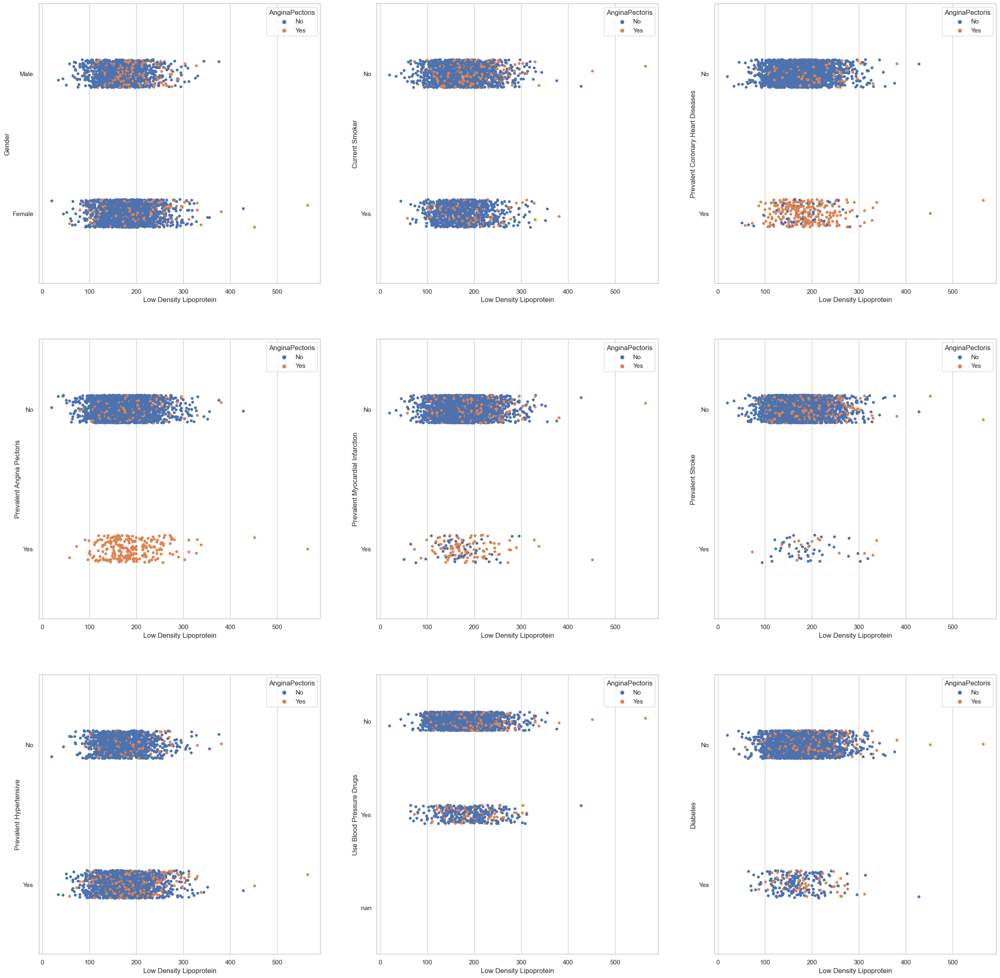

In [123]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['LowDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Low Density Lipoprotein', ylabel='Gender');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Low Density Lipoprotein', ylabel='Current Smoker');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['LowDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Low Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Low Density Lipoprotein', ylabel='Diabetes');  

**K. Total Cholesterol**

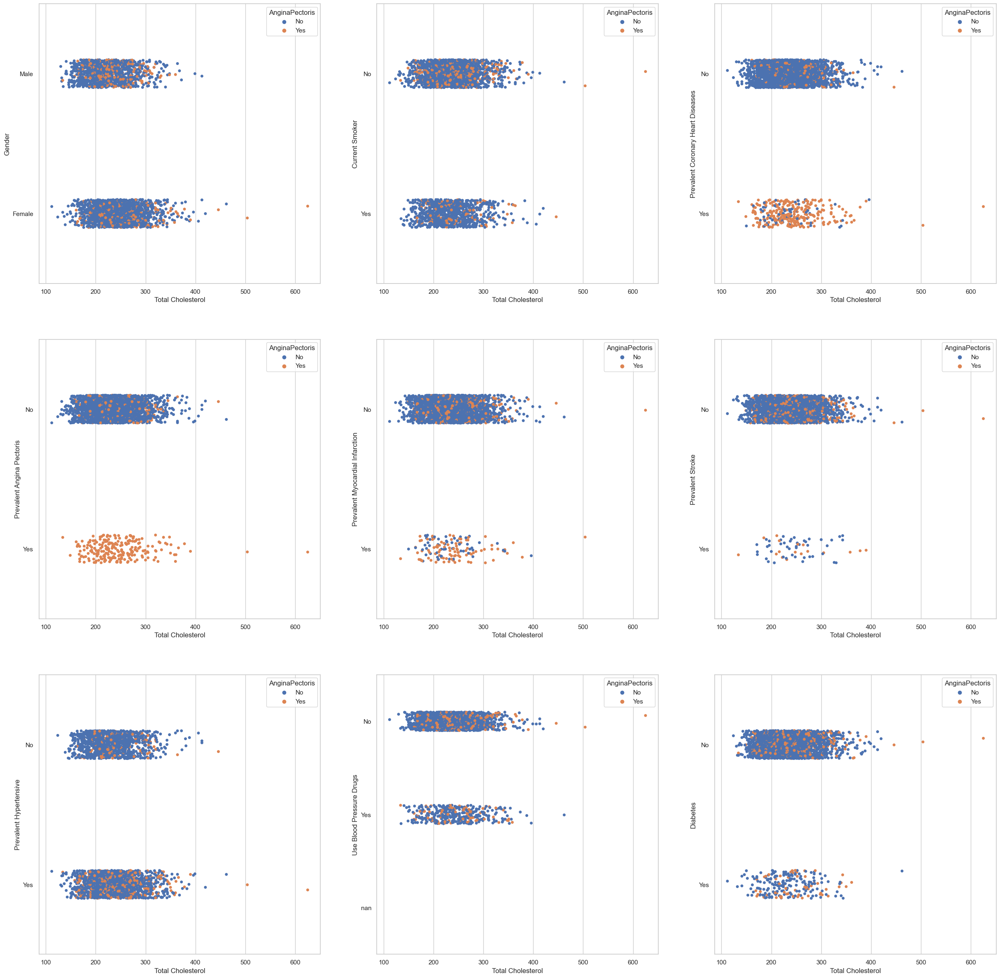

In [124]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['TotalCholesterol'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Total Cholesterol', ylabel='Gender');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Total Cholesterol', ylabel='Current Smoker');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Total Cholesterol', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Total Cholesterol', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Total Cholesterol', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Total Cholesterol', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Total Cholesterol', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['TotalCholesterol'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Total Cholesterol', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Total Cholesterol', ylabel='Diabetes');                                         

**6. Boxen Plot**

**A. Age**

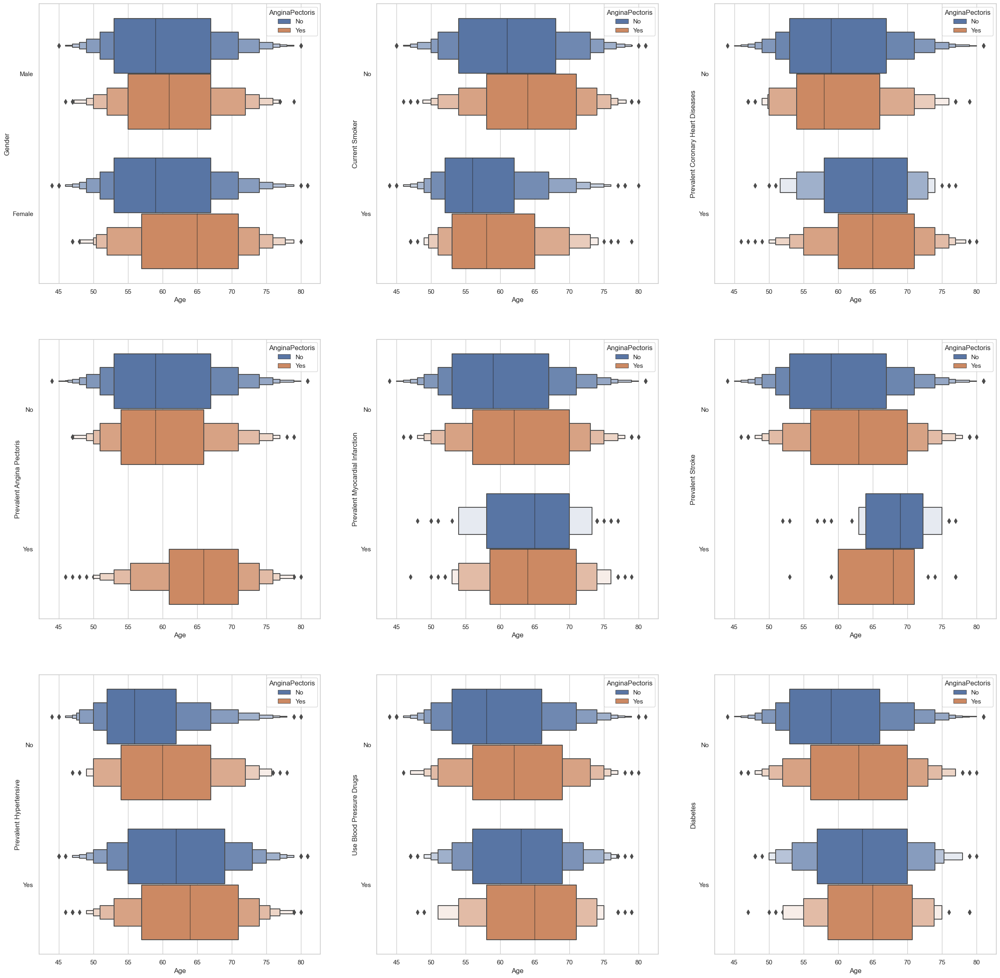

In [125]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x = Heart['Age'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Age', ylabel='Gender');

sns.boxenplot(x = Heart['Age'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Age', ylabel='Current Smoker');

sns.boxenplot(x = Heart['Age'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Age', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['Age'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Age', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['Age'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Age', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['Age'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Age', ylabel='Prevalent Stroke');

sns.boxenplot(x = Heart['Age'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Age', ylabel='Prevalent Hypertensive');

sns.boxenplot(x = Heart['Age'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Age', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x = Heart['Age'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Age', ylabel='Diabetes');

**B. Cigarettes Per Day**

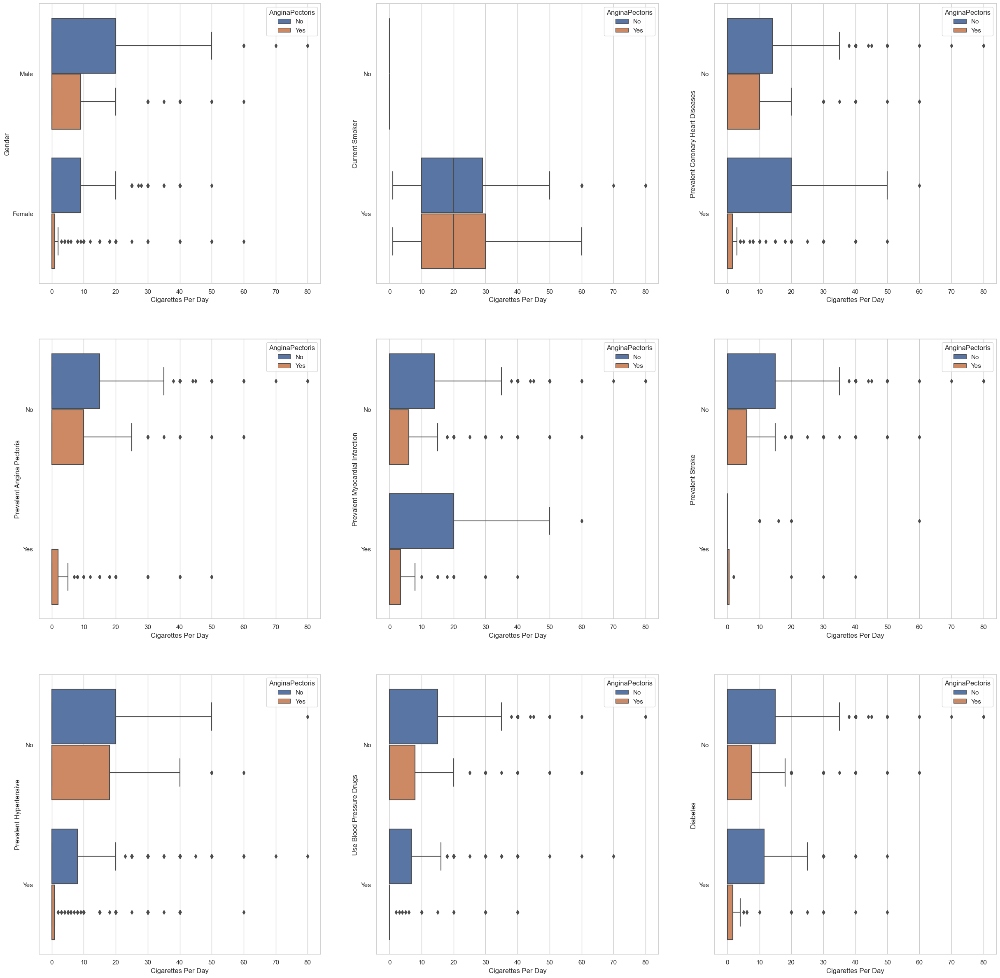

In [126]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Cigarettes Per Day', ylabel='Gender');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Cigarettes Per Day', ylabel='Current Smoker');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Stroke');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['CigarettesPerDay'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Cigarettes Per Day', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Cigarettes Per Day', ylabel='Diabetes');

**C. Body Mass Index**

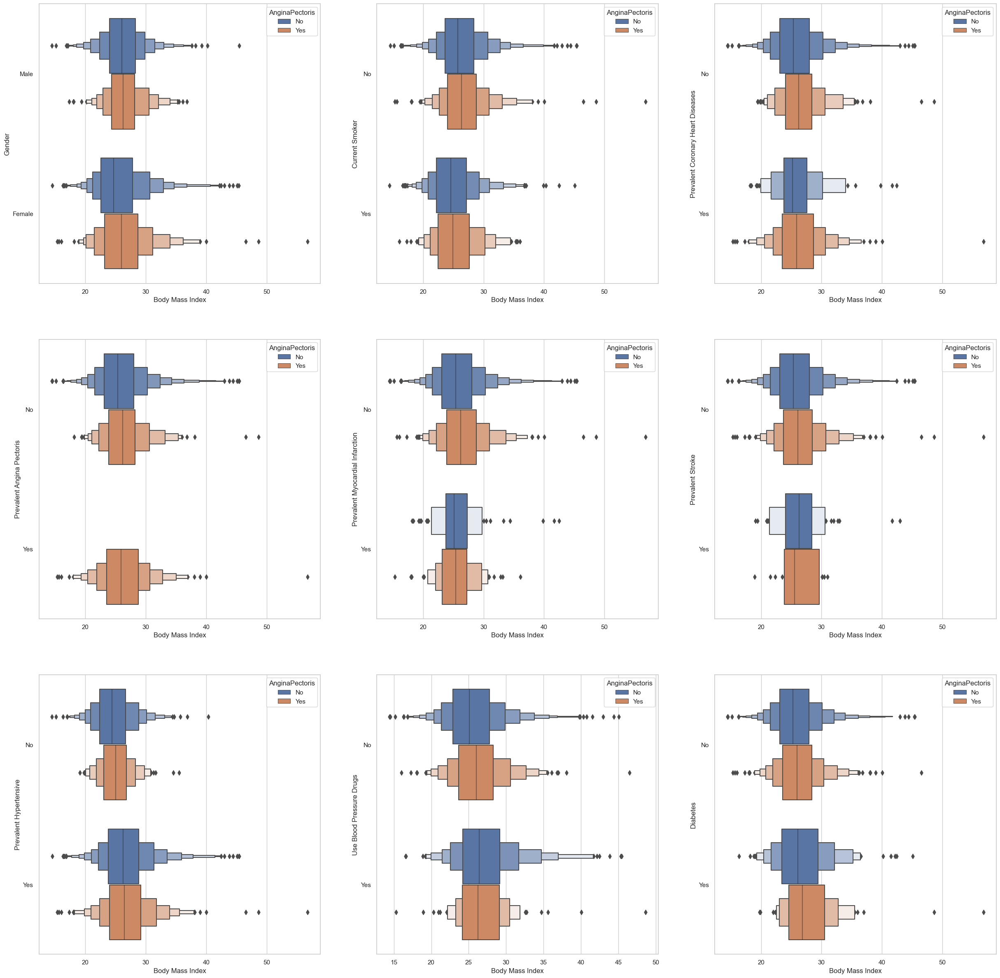

In [127]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Body Mass Index', ylabel='Gender');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Body Mass Index', ylabel='Current Smoker');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Body Mass Index', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Body Mass Index', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Body Mass Index', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Body Mass Index', ylabel='Prevalent Stroke');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Body Mass Index', ylabel='Prevalent Hypertensive');

sns.boxenplot(x = Heart['BodyMassIndex'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Body Mass Index', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Body Mass Index', ylabel='Diabetes');                     

**D. Systolic Blood Pressure**

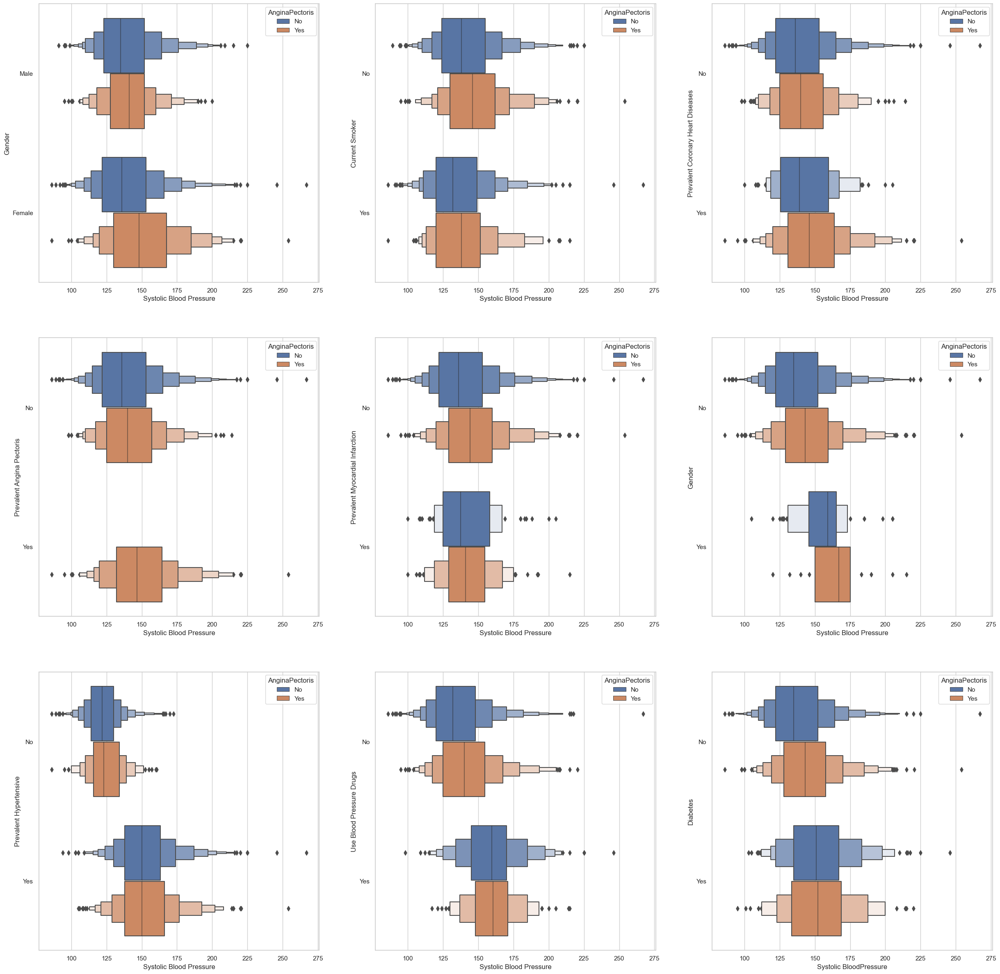

In [128]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x = Heart['SystolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Systolic Blood Pressure', ylabel='Current Smoker');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.boxenplot(x = Heart['SystolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Systolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Systolic BloodPressure', ylabel='Diabetes');                      

**E. Diastolic Blood Pressure**

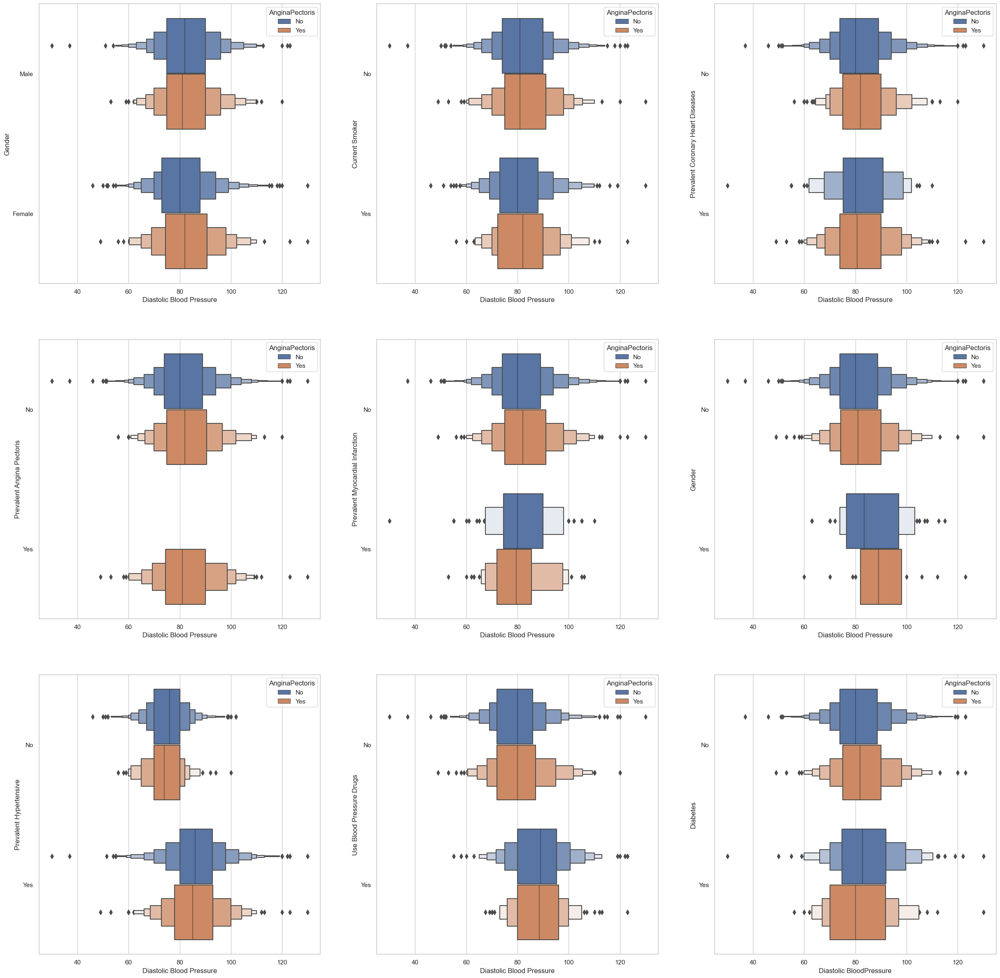

In [129]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x = Heart['DiastolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Diastolic Blood Pressure', ylabel='Current Smoker');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.boxenplot(x = Heart['DiastolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Diastolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Diastolic BloodPressure', ylabel='Diabetes');                                         

**F. Heart Rate**

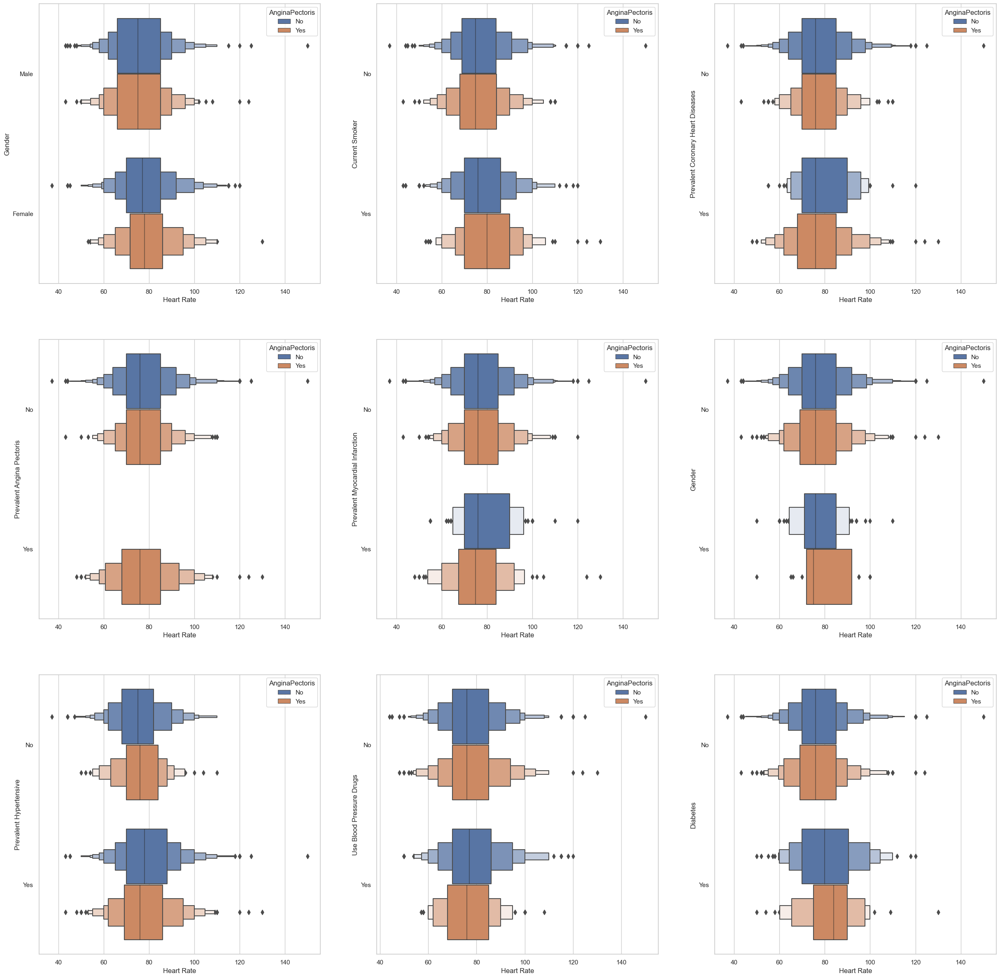

In [130]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x =Heart['HeartRate'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Heart Rate', ylabel='Gender');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Heart Rate', ylabel='Current Smoker');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Heart Rate', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Heart Rate', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Heart Rate', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Heart Rate', ylabel='Gender');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Heart Rate', ylabel='Prevalent Hypertensive');

sns.boxenplot(x =Heart['HeartRate'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Heart Rate', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Heart Rate', ylabel='Diabetes');                                         

**G. Glucose**

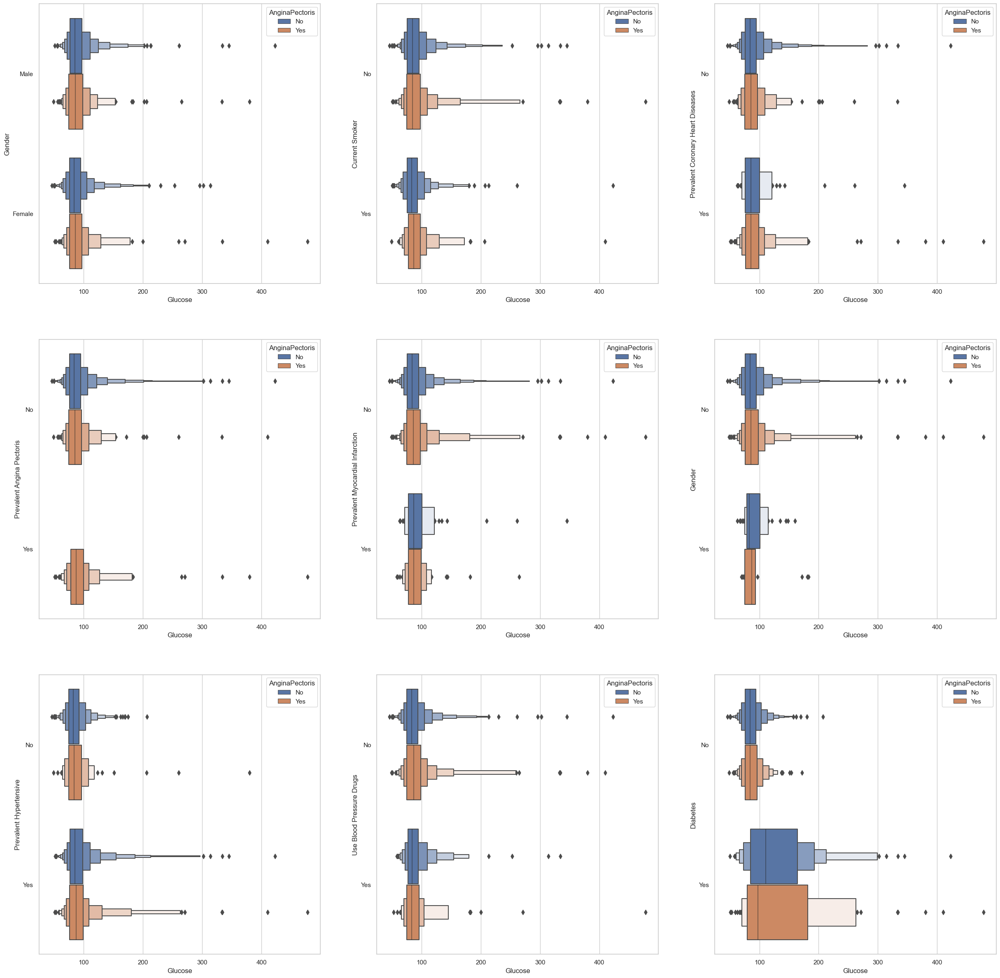

In [131]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x = Heart['Glucose'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Glucose', ylabel='Gender');

sns.boxenplot(x = Heart['Glucose'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Glucose', ylabel='Current Smoker');

sns.boxenplot(x = Heart['Glucose'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Glucose', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['Glucose'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Glucose', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['Glucose'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Glucose', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['Glucose'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Glucose', ylabel='Gender');

sns.boxenplot(x = Heart['Glucose'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Glucose', ylabel='Prevalent Hypertensive');

sns.boxenplot(x = Heart['Glucose'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Glucose', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x = Heart['Glucose'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Glucose', ylabel='Diabetes'); 

**H. High Density Lipoprotein**

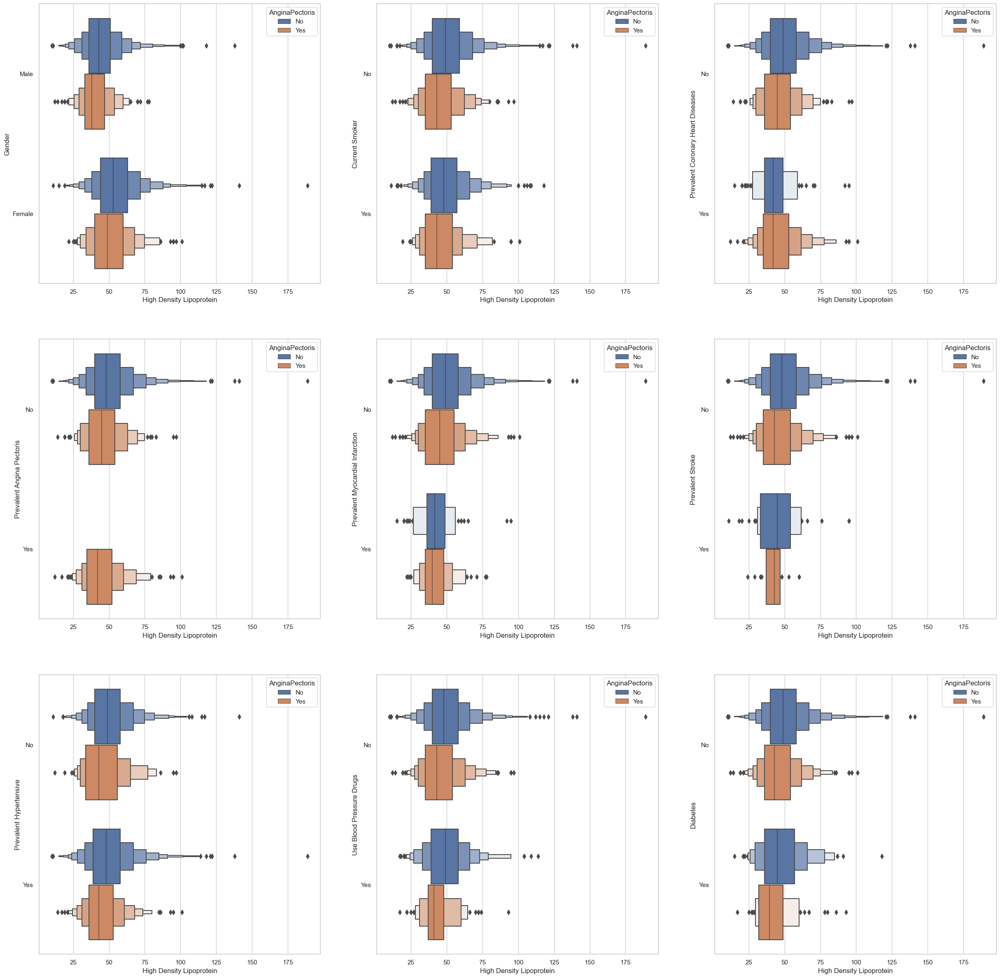

In [132]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x = Heart['HighDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='High Density Lipoprotein', ylabel='Gender');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='High Density Lipoprotein', ylabel='Current Smoker');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Stroke');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.boxenplot(x =Heart['HighDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='High Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x =Heart['HighDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='High Density Lipoprotein', ylabel='Diabetes'); 

**J. Low Density Lipoprotein**

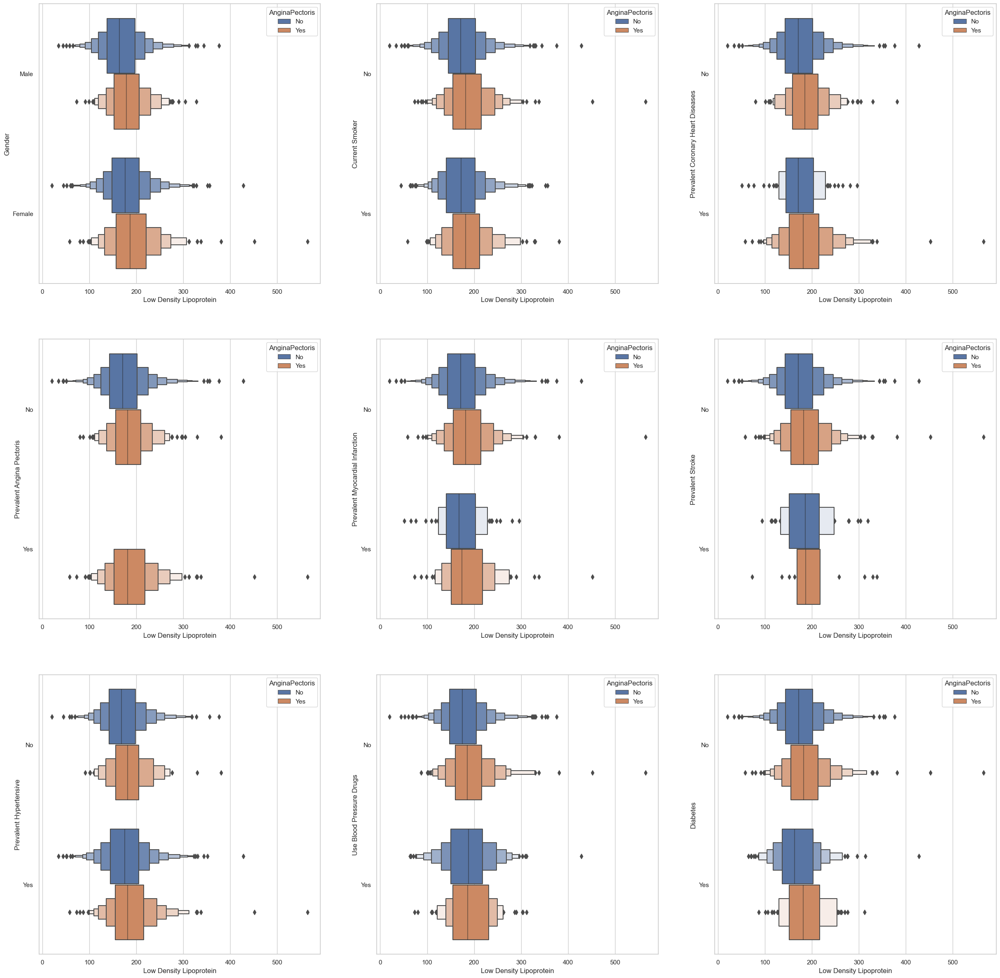

In [133]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x =Heart['LowDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Low Density Lipoprotein', ylabel='Gender');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Low Density Lipoprotein', ylabel='Current Smoker');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Stroke');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.boxenplot(x =Heart['LowDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Low Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Low Density Lipoprotein', ylabel='Diabetes'); 

**K. Total Cholesterol**

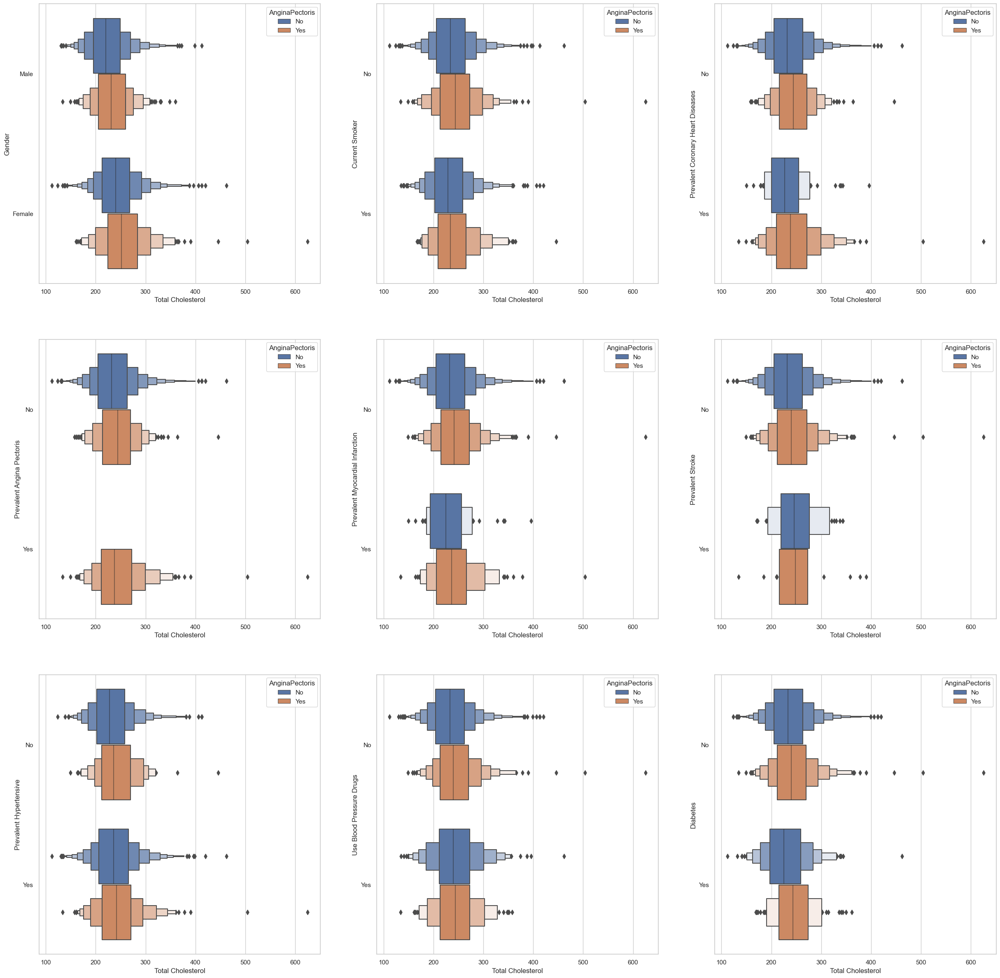

In [134]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x =Heart['TotalCholesterol'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Total Cholesterol', ylabel='Gender');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Total Cholesterol', ylabel='Current Smoker');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Total Cholesterol', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Total Cholesterol', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Total Cholesterol', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Total Cholesterol', ylabel='Prevalent Stroke');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Total Cholesterol', ylabel='Prevalent Hypertensive');

sns.boxenplot(x =Heart['TotalCholesterol'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Total Cholesterol', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Total Cholesterol', ylabel='Diabetes');                      

# Missing Values Statistics 1

In [135]:
MissingValues = Heart.isnull().sum().T
MissingValues

Gender                              0
Age                                 0
CurrentSmoker                       0
CigarettesPerDay                   14
BodyMassIndex                      17
PrevalentCoronaryHeartDiseases      0
PrevalentAnginaPectoris             0
PrevalentMyocardialInfarction       0
PrevalentStroke                     0
PrevalentHypertensive               0
UseBloodPressureDrugs             446
Diabetes                            0
SystolicBloodPressure               0
DiastolicBloodPressure              0
HeartRate                           4
Glucose                           562
HighDensityLipoprotein            236
LowDensityLipoprotein             237
TotalCholesterol                  214
AnginaPectoris                      0
MyocardialInfarction                0
dtype: int64

# Encoding Categorical Values

**1. Label Encoder**

In [136]:
LabelEncoder = LabelEncoder()
Heart['Gender'] = LabelEncoder.fit_transform(Heart['Gender'])
y = Heart['CurrentSmoker'] = LabelEncoder.fit_transform(Heart['CurrentSmoker'])
y = Heart['PrevalentCoronaryHeartDiseases'] = LabelEncoder.fit_transform(Heart['PrevalentCoronaryHeartDiseases'])
y = Heart['PrevalentAnginaPectoris'] = LabelEncoder.fit_transform(Heart['PrevalentAnginaPectoris'])
y = Heart['PrevalentMyocardialInfarction'] = LabelEncoder.fit_transform(Heart['PrevalentMyocardialInfarction'])
y = Heart['PrevalentStroke'] = LabelEncoder.fit_transform(Heart['PrevalentStroke'])
y = Heart['PrevalentHypertensive'] = LabelEncoder.fit_transform(Heart['PrevalentHypertensive'])
Heart['UseBloodPressureDrugs'] = LabelEncoder.fit_transform(Heart['UseBloodPressureDrugs'])
y = Heart['Diabetes'] = LabelEncoder.fit_transform(Heart['Diabetes'])
Heart

,Gender,Age,CurrentSmoker,CigarettesPerDay,BodyMassIndex,PrevalentCoronaryHeartDiseases,PrevalentAnginaPectoris,PrevalentMyocardialInfarction,PrevalentStroke,PrevalentHypertensive,...,Diabetes,SystolicBloodPressure,DiastolicBloodPressure,HeartRate,Glucose,HighDensityLipoprotein,LowDensityLipoprotein,TotalCholesterol,AnginaPectoris,MyocardialInfarction
0,1,52,0,0.0,NaN,0,0,0,0,0,...,0,121.0,66.0,69.0,92.0,31.0,178.0,209.0,No,Yes
1,0,58,0,0.0,28.50,0,0,0,0,0,...,0,108.0,66.0,80.0,71.0,54.0,141.0,237.0,No,No
2,0,58,1,30.0,24.61,0,0,0,0,1,...,0,155.0,90.0,74.0,NaN,NaN,NaN,NaN,No,No
3,0,55,0,0.0,31.17,0,0,0,0,1,...,1,180.0,106.0,86.0,81.0,46.0,135.0,220.0,No,No
4,0,57,1,30.0,22.02,0,0,0,0,0,...,0,110.0,46.0,75.0,87.0,34.0,286.0,320.0,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3258,1,63,1,50.0,17.38,0,0,0,0,0,...,0,120.0,80.0,76.0,NaN,NaN,NaN,NaN,No,No
3259,0,60,1,20.0,22.37,0,0,0,0,1,...,0,205.0,100.0,80.0,91.0,47.0,181.0,228.0,No,No
3260,0,56,1,35.0,21.97,0,0,0,0,1,...,0,145.0,92.0,95.0,90.0,70.0,181.0,251.0,No,No
3261,1,52,0,0.0,25.74,0,0,0,0,1,...,0,143.0,89.0,65.0,72.0,30.0,123.0,153.0,No,No


**2. One Hot Encoding**

In [137]:
# Heart = pd.get_dummies(Heart, columns=['Gender', 'CurrentSmoker', 'PrevalentCoronaryHeartDiseases',
#                                           'PrevalentAnginaPectoris', 'PrevalentMyocardialInfarction',
#                                          'PrevalentStroke', 'PrevalentHypertensive', 
#                                           'UseBloodPressureDrugs', 'Diabetes'], dummy_na=False)
# Heart

# Dealing With Missing Values

**1. Simple Imputer**

**A. Numerical Features**

In [138]:
Impute = SimpleImputer(missing_values=np.nan, strategy='mean')
Heart['CigarettesPerDay'] = Impute.fit_transform(np.array(Heart['CigarettesPerDay']).reshape(-1, 1))
Heart['BodyMassIndex'] = Impute.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1, 1))
Heart['HeartRate'] = Impute.fit_transform(np.array(Heart['HeartRate']).reshape(-1, 1))
Heart['Glucose'] = Impute.fit_transform(np.array(Heart['Glucose']).reshape(-1, 1))
Heart['HighDensityLipoprotein'] = Impute.fit_transform(np.array(Heart['HighDensityLipoprotein']).reshape(-1, 1))
Heart['LowDensityLipoprotein'] = Impute.fit_transform(np.array(Heart['LowDensityLipoprotein']).reshape(-1, 1))
Heart['TotalCholesterol'] = Impute.fit_transform(np.array(Heart['TotalCholesterol']).reshape(-1, 1))

**B. Categeorical Features**

In [139]:
Impute2 = SimpleImputer(missing_values=np.nan, strategy='most_frequent')
Heart[['UseBloodPressureDrugs']] = Impute2.fit_transform(Heart[['UseBloodPressureDrugs']])

**2. Knn Impute**

In [140]:
# KnnImpute = KNNImputer(n_neighbors=1)
# Heart['CigarettesPerDay'] = KnnImpute.fit_transform(np.array(Heart['CigarettesPerDay']).reshape(-1, 1))
# Heart['BodyMassIndex'] = KnnImpute.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1, 1))
# Heart['HeartRate'] = KnnImpute.fit_transform(np.array(Heart['HeartRate']).reshape(-1, 1))
# Heart['Glucose'] = KnnImpute.fit_transform(np.array(Heart['Glucose']).reshape(-1, 1))
# Heart['HighDensityLipoprotein'] = KnnImpute.fit_transform(np.array(Heart['HighDensityLipoprotein']).reshape(-1, 1))
# Heart['LowDensityLipoprotein'] = KnnImpute.fit_transform(np.array(Heart['LowDensityLipoprotein']).reshape(-1, 1))
# Heart['TotalCholesterol'] = KnnImpute.fit_transform(np.array(Heart['TotalCholesterol']).reshape(-1, 1))
# Heart[['UseBloodPressureDrugs']] = KnnImpute.fit_transform(Heart[['UseBloodPressureDrugs']])

# Missing Values Statistics 2

In [141]:
MissingValues2 = Heart.isnull().sum().T
MissingValues2

Gender                            0
Age                               0
CurrentSmoker                     0
CigarettesPerDay                  0
BodyMassIndex                     0
PrevalentCoronaryHeartDiseases    0
PrevalentAnginaPectoris           0
PrevalentMyocardialInfarction     0
PrevalentStroke                   0
PrevalentHypertensive             0
UseBloodPressureDrugs             0
Diabetes                          0
SystolicBloodPressure             0
DiastolicBloodPressure            0
HeartRate                         0
Glucose                           0
HighDensityLipoprotein            0
LowDensityLipoprotein             0
TotalCholesterol                  0
AnginaPectoris                    0
MyocardialInfarction              0
dtype: int64

# Normalization 

In [142]:
Norm = MinMaxScaler(feature_range=(0, 1))
Heart['Age']= Norm.fit_transform(np.array(Heart['Age']).reshape(-1,1))
Heart['BodyMassIndex']= Norm.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1,1))
Heart['Glucose']= Norm.fit_transform(np.array(Heart['Glucose']).reshape(-1,1))
Heart['CigarettesPerDay']= Norm.fit_transform(np.array(Heart['CigarettesPerDay']).reshape(-1,1))
Heart['BodyMassIndex']= Norm.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1,1))
Heart['SystolicBloodPressure']= Norm.fit_transform(np.array(Heart['SystolicBloodPressure']).reshape(-1,1))
Heart['DiastolicBloodPressure']= Norm.fit_transform(np.array(Heart['DiastolicBloodPressure']).reshape(-1,1))
Heart['HeartRate']= Norm.fit_transform(np.array(Heart['HeartRate']).reshape(-1,1))
Heart['HighDensityLipoprotein']= Norm.fit_transform(np.array(Heart['HighDensityLipoprotein']).reshape(-1,1))
Heart['LowDensityLipoprotein']= Norm.fit_transform(np.array(Heart['LowDensityLipoprotein']).reshape(-1,1))
Heart['TotalCholesterol']= Norm.fit_transform(np.array(Heart['TotalCholesterol']).reshape(-1,1))# # 

# Standardization


In [143]:
# Stand = StandardScaler()
# Heart['Age']= Stand.fit_transform(np.array(Heart['Age']).reshape(-1,1))
# Heart['BodyMassIndex']= Stand.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1,1))
# Heart['Glucose']= Stand.fit_transform(np.array(Heart['Glucose']).reshape(-1,1))
# Heart['CigarettesPerDay']= Stand.fit_transform(np.array(Heart['CigarettesPerDay']).reshape(-1,1))
# Heart['BodyMassIndex']= Stand.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1,1))
# Heart['SystolicBloodPressure']= Stand.fit_transform(np.array(Heart['SystolicBloodPressure']).reshape(-1,1))
# Heart['DiastolicBloodPressure']= Stand.fit_transform(np.array(Heart['DiastolicBloodPressure']).reshape(-1,1))
# Heart['HeartRate']= Stand.fit_transform(np.array(Heart['HeartRate']).reshape(-1,1))
# Heart['HighDensityLipoprotein']= Stand.fit_transform(np.array(Heart['HighDensityLipoprotein']).reshape(-1,1))
# Heart['LowDensityLipoprotein']= Stand.fit_transform(np.array(Heart['LowDensityLipoprotein']).reshape(-1,1))
# Heart['TotalCholesterol']= Stand.fit_transform(np.array(Heart['TotalCholesterol']).reshape(-1,1))

# Heart 

# Detect Outliers 

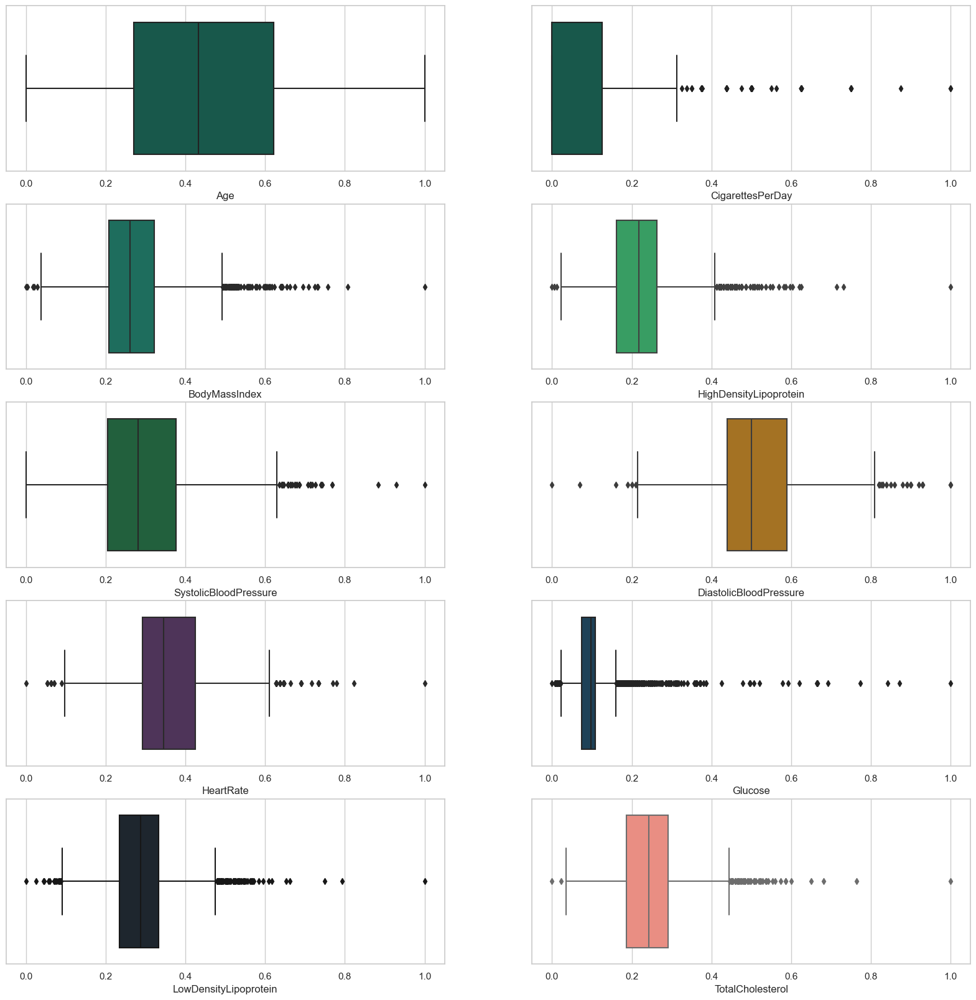

In [144]:
Fig, ((Ax1, Ax2), (Ax3, Ax4),(Ax5, Ax6), (Ax7, Ax8), (Ax9, Ax10)) = plt.subplots(nrows=5,
                                            ncols=2,
                                           figsize=(20, 20))

sns.boxplot(data = Heart, x=Heart["Age"],  orient='v', ax=Ax1, color='#0E6251');
sns.boxplot(data = Heart, x=Heart["CigarettesPerDay"],  orient='v', ax=Ax2, color='#0E6251');
sns.boxplot(data = Heart, x=Heart["BodyMassIndex"],  orient='v', ax=Ax3, color='#117A65');
sns.boxplot(data = Heart, x=Heart["HighDensityLipoprotein"],  orient='v', ax=Ax4, color='#27AE60');
sns.boxplot(data = Heart, x=Heart["SystolicBloodPressure"],  orient='v', ax=Ax5, color='#186A3B');
sns.boxplot(data = Heart, x=Heart["DiastolicBloodPressure"],  orient='v', ax=Ax6, color='#B9770E');
sns.boxplot(data = Heart, x=Heart["HeartRate"],  orient='v', ax=Ax7, color='#512E5F');
sns.boxplot(data = Heart, x=Heart["Glucose"],  orient='v', ax=Ax8, color='#154360');
sns.boxplot(data = Heart, x=Heart["LowDensityLipoprotein"],  orient='v', ax=Ax9, color='#1B2631');
sns.boxplot(data = Heart, x=Heart["TotalCholesterol"],  orient='v', ax=Ax10, color='#FA8072');

# Remove Outliers 

In [145]:
# IQR
Q1 = Heart.quantile(0.25)
Q3 = Heart.quantile(0.75)

IQR = Q3-Q1

Heart = Heart[~((Heart<(Q1-1.5*IQR))|(Heart>(Q3+1.5*IQR))).any(axis=1)];
Heart.shape

(2067, 21)

# Split The DataSet Into Independent Variables (X) And Dependent Variable (Y)

In [146]:
X = Heart.drop(["AnginaPectoris", 'MyocardialInfarction'], inplace=False, axis=1)
y = Heart['AnginaPectoris']

In [147]:
y = LabelEncoder.fit_transform(y)

In [148]:
y = pd.DataFrame(y)

# Artificial Neural Network

In [149]:
random_seed=1
kf = KFold(n_splits=10)

confusionmatrixANN = []
accuracyANN = []
recallANN = []
precisionANN = []
f1ANN = []

# Split The Dataset Into Training And Testing
for train_index, test_index in kf.split(X,y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]


    # Fit Artificial Neural Network
    with tf.device('cpu'):
        ANN = tf.keras.models.Sequential()
        # Add The Input Layer And First Hidden Layer
        ANN.add(tf.keras.layers.Dense(units=10, activation='relu'))
        # Add The Second Hidden Layer
        ANN.add(tf.keras.layers.Dense(units=8, activation='relu'))
        # Add The Third Hidden Layer
        ANN.add(tf.keras.layers.Dense(units=6, activation='relu'))
         # Add The Output Layer
        ANN.add(tf.keras.layers.Dense(units=1, activation='sigmoid'))
        # Compilling The ANN
        ANN.compile(optimizer= tf.keras.optimizers.legacy.Adam(), loss= 'binary_crossentropy' , metrics = ['accuracy'])
        # Training The ANN
        ANN.fit(X_train, y_train, epochs=100, batch_size = 32, verbose=0)


    y_pred = ANN.predict(X_test)
    y_pred2 = np.array(y_pred > 0.5)
    y_test2 = np.array(y_test)



    # Confusion Matrix Of Artificial Neural Network
    confusionmatrixANN.append(confusion_matrix(y_test, y_pred> 0.5))
    Confusion_MatrixANN = np.array(confusionmatrixANN)

    # Accuracy Of Artificial Neural Network
    accuracyANN.append(accuracy_score(y_test, y_pred> 0.5))
    AccurcayANN = DataFrame(accuracyANN, columns=['Accuracy'])

    # Recall Of Artificial Neural Network
    recallANN.append(recall_score(y_test, y_pred> 0.5, average='macro'))
    RecallANN = DataFrame(recallANN, columns=['Recall'])

    # Precision Of Artificial Neural Network
    precisionANN.append(precision_score(y_test, y_pred> 0.5, average='macro'))
    PecisionANN = DataFrame(precisionANN, columns=['Precision'])

    # F1 Score Of Artificial Neural Network
    f1ANN.append(f1_score(y_test, y_pred> 0.5, average='macro'))
    F1ANN = DataFrame(f1ANN, columns=['F1 Score'])




Metal device set to: Apple M1

systemMemory: 8.00 GB
maxCacheSize: 2.67 GB

7/7 [==============================] - 0s 4ms/step


In [150]:
print(np.concatenate(((y_pred2.reshape(len(y_pred2),1), y_test2.reshape(len(y_test2),1))),1))

[[0 0]
 [0 0]
 [0 1]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 1]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 1]
 [0 1]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 1]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 1]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 1]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 1]
 [0 0]
 [0 1]
 [0 0]
 [0 1]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 1]
 [0 0]
 [0 1]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]

In [151]:
print("Acuraccy Score Of Artificial Neural Network Is :", np.mean(accuracyANN))
print("Recall Score Of Artificial Neural Network :", np.mean(recallANN))
print("Precision Score Of Artificial Neural Network :", np.mean(precisionANN))
print("F1 Score Of Artificial Neural Network :", np.mean(f1ANN))
print("""
Confusion Matrix Of Artificial Neural Network:
""", sum(confusionmatrixANN))
print(" ")

Acuraccy Score Of Artificial Neural Network Is : 0.9206322405140472
Recall Score Of Artificial Neural Network : 0.5
Precision Score Of Artificial Neural Network : 0.4603161202570236
F1 Score Of Artificial Neural Network : 0.47930091834548927

Confusion Matrix Of Artificial Neural Network:
 [[1903    0]
 [ 164    0]]
 
